# Exploratory Data Analysis - World Happiness Report 2021


## Table of Contents:

* [Introduction](#Introduction)
* [Libraries Initialisation](#Libraries-Initialisation)
* [Data Presentation](#Data-Presentation)
     * [Detailed information about each of the factors](#Detailed-information-about-each-of-the-factors)
     * [Missing Values](#Missing-Values)
          * [Nullity Pie Chart](#Nullity-Pie-Chart)
          * [Nullity through Time](#Nullity-through-Time)
          * [Nullity Matrix](#Nullity-Matrix)
          * [Nullity Histogram](#Nullity-Histogram)
          * [Nullity Heatmap (Pearson Correlation)](#Nullity-Heatmap-(Pearson-Correlation))
          * [Nullity Dendrogram](#Nullity-Dendrogram)
     * [Descriptive Statistics](#Descriptive-Statistics)
          * [Univariate Analysis](#Univariate-Analysis)
              * [Box Plot](#Box-Plot)
              * [Violin Plot](#Violin-Plot)
              * [Histogram](#Histogram)
          * [Multivariate Analysis](#Multivariate-Analysis)
              * [Pair Plot](#Pair-Plot)
              * [Correlation Matrix](#Correlation-Matrix)
                  * [Pearson Correlation Matrix](#Pearson-Correlation-Matrix)
                  * [Kendall Correlation Matrix](#Kendall-Correlation-Matrix)
                  * [Spearman Correlation Matrix](#Spearman-Correlation-Matrix)
              * [Location](#Location)
                  * [Region](#Region)
                  * [Country](#Country)
                  * [World Map](#World-Map)
              * [Time](#Time)
                  * [Student's t-test and Welch's t-test](#Student's-t-test-and-Welch's-t-test)
                  * [Region](#Time---Region)
                  * [Country](#Time---Country)
                  * [Variation of Happiness through the time](#Variation-of-Happiness-through-the-time)
     * [Data Modeling](#Data-Modeling)
         * [Clustering](#Clustering)
             * [Naive Clustering](#Naive-Clustering)
             * [Data Cleaning](#Data-Cleaning)
                 * [Missing Data Imputation](#Missing-Data-Imputation)
                     * [k-NN Imputer](#k-NN-Imputer)
             * [Data Transformation](#Data-Transformation)
                 * [Yeo-Johnson Transformation](#Yeo-Johnson-Transformation)
             * [Data Reduction](#Data-Reduction)
                 * [Principal Component Analysis](#Principal-Component-Analysis)
             * [K-Means](#K-Means)
             * [K-Medoids](#K-Medoids)
             * [DBSCAN](#DBSCAN)
             * [Elbow Method and Silhouettte Score](#Elbow-Method-and-Silhouettte-Score)
         * [Regression](#Regression)
             * [Pooled OLS Regression](#Pooled-OLS-Regression)
                 * [Adjusted R-squared-and-Regression-coefficients](#Adjusted-R-squared-and-Regression-coefficients)
             * [Extreme Gradient Boosting (XGBoost)](#Extreme-Gradient-Boosting-(XGBoost))
                 * [K-Fold Cross-Validation and Hyperparameters-Tuning](#K-Fold-Cross-Validation-and-Hyperparameters-Tuning)
                 * [Biais-Variance Tradeoff](#Biais-Variance-Tradeoff)
                 * [Features Importance](#Features-Importance)
* [Conslusion](#Conclusion)

## Introduction

The **World Happiness Report** is a landmark survey of the state of global happiness that ranks more than 150 countries by how happy their citizens perceive themselves to be. The **World Happiness Report 2021** focuses on the effects of COVID-19 and how people all over the world have fared.
The reports review the state of happiness in the world and show how the variation of the national averages life evaluations (happiness) in the different countries from the past years can be explained using different factors from surveys gathered from different sources.

<br>
<div>
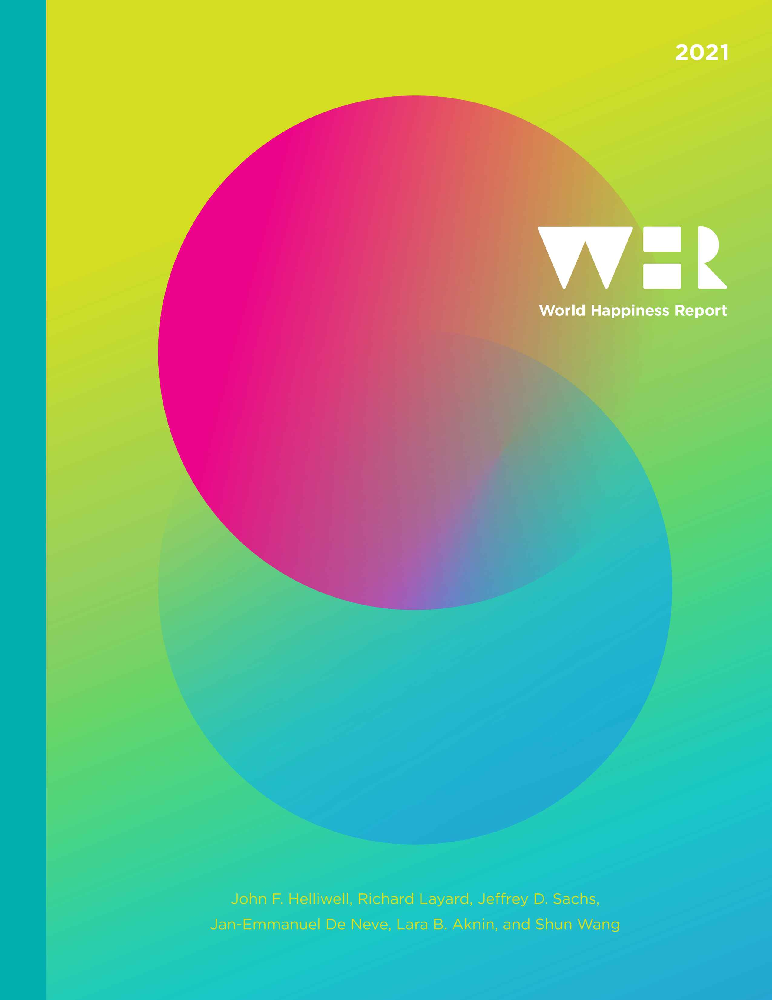
</div>

The **happiness scores and rankings** are based on individuals' own assessments of their subjective well-being, as indicated by their survey responses in the **Gallup World Poll**.
The report show how the happiness scores (**life ladder**) can also be estimated using eight key variables – **GDP per capita**, **social support**, **healthy life expectancy**, **freedom to make life choices**, **generosity**, **freedom from corruption**, **positive affect** and **negative affect**.

In this notebook we will perform an **Exploratory Data Analysis** to find the interesting insights for this data set.

## Libraries Initialisation

In [46]:
!pip install numpy
!pip install pandas

!pip install matplotlib
!pip install seaborn
!pip install missingno
!pip install plotly
!pip install seaborn

!pip install scipy
!pip install statsmodels
!pip install sklearn
!pip install scikit-learn-extra
!pip install xgboost

import os
import warnings
warnings.filterwarnings("ignore") 

import numpy as np
import pandas as pd
import csv

import matplotlib
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
import matplotlib.gridspec as grid_spec
import seaborn as sns
import missingno as msno
import plotly.express as px
import plotly

from sklearn.impute import KNNImputer
from sklearn.preprocessing import PowerTransformer
from sklearn.decomposition import PCA

from sklearn.cluster import KMeans
from sklearn_extra.cluster import KMedoids
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_samples, silhouette_score

from scipy.stats import ttest_ind
import statsmodels.api as sm
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

## Data Presentation

In [3]:
df = pd.read_csv(filepath_or_buffer='DATA/world_happiness_report/world-happiness-report-2021.csv', 
                 sep=",", quoting=csv.QUOTE_NONE)
df2 = pd.read_csv(filepath_or_buffer='DATA/world_happiness_report/world-happiness-report.csv', 
                 sep=",", quoting=csv.QUOTE_NONE)
df_country_code = pd.read_csv(filepath_or_buffer='DATA/world_happiness_report/country_code.tsv', 
                 sep="\t", header=None, na_filter=False, quoting=csv.QUOTE_NONE)

list_missing_country = ["Belize", "Somaliland region", "Oman", "Djibouti", "Trinidad and Tobago", "Guyana", "Cuba", 
                        "Congo (Kinshasa)", "Suriname", "South Sudan", "Syria", "Angola", "Central African Republic", 
                        "Qatar", "Bhutan", "Somalia", "Sudan"]
list_missing_continent = ["North America and ANZ", "Sub-Saharan Africa", "Middle East and North Africa", "Sub-Saharan Africa",
                         "Latin America and Caribbean", "Latin America and Caribbean", "Latin America and Caribbean",
                         "Sub-Saharan Africa", "Latin America and Caribbean", "Sub-Saharan Africa",
                         "Middle East and North Africa", "Sub-Saharan Africa", "Sub-Saharan Africa", "Middle East and North Africa",
                         "South Asia", "Sub-Saharan Africa", "Sub-Saharan Africa"]

df_missing_country = pd.DataFrame({"Country name":list_missing_country, 
                                   "Regional indicator":list_missing_continent})

df = df.append(df_missing_country)
df.reset_index(drop=True, inplace=True)

continents = set(df["Regional indicator"])
countries = set(df2["Country name"])
countries_df = set(df["Country name"])

list_regional_indicator = [list(set(df["Regional indicator"][df["Country name"] == country]))[0] for country in list(df2["Country name"])]
df2["Regional indicator"] = list_regional_indicator

list_country_code = [list(df_country_code[0][df_country_code[1] == country])[0] for country in list(df2["Country name"])]
df2["Country code"] = list_country_code

The below dataframe (df) is the work of the **World Happiness Report** estimating the **Ladder score (Happiness score)** using a pooled OLS regression for a tattered panel explaining annual national average **Ladder score (Happiness score)** responses from all available surveys from 2005 to 2019.
The estimated **Ladder score (Happiness score)** is the sum of all **Explained by:** features which are computed with the the coefficient associated to the features ([Detailed information about each of the factors](Detailed-information-about-each-of-the-factors)) from the pooled OLS regression.

<br>
<div>
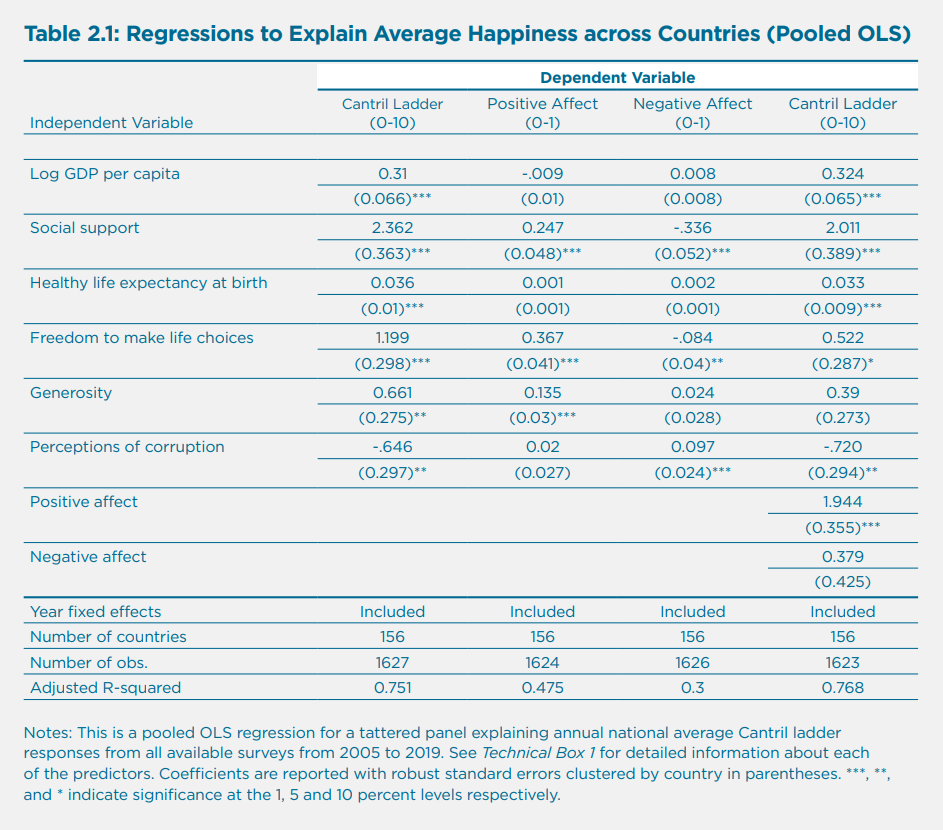
</div>
<br>

For practical reasons we have added the missing countries associated with their region in this table that there were present in the other table (df2). Those added values contains NaN value for the other features since the pooled OLS regression occured without those countries.

In [4]:
df

,Country name,Regional indicator,Ladder score,Standard error of ladder score,upperwhisker,lowerwhisker,Logged GDP per capita,Social support,Healthy life expectancy,Freedom to make life choices,Generosity,Perceptions of corruption,Ladder score in Dystopia,Explained by: Log GDP per capita,Explained by: Social support,Explained by: Healthy life expectancy,Explained by: Freedom to make life choices,Explained by: Generosity,Explained by: Perceptions of corruption,Dystopia + residual
0,Finland,Western Europe,7.842,0.032,7.904,7.780,10.775,0.954,72.0,0.949,-0.098,0.186,2.43,1.446,1.106,0.741,0.691,0.124,0.481,3.253
1,Denmark,Western Europe,7.620,0.035,7.687,7.552,10.933,0.954,72.7,0.946,0.030,0.179,2.43,1.502,1.108,0.763,0.686,0.208,0.485,2.868
2,Switzerland,Western Europe,7.571,0.036,7.643,7.500,11.117,0.942,74.4,0.919,0.025,0.292,2.43,1.566,1.079,0.816,0.653,0.204,0.413,2.839
3,Iceland,Western Europe,7.554,0.059,7.670,7.438,10.878,0.983,73.0,0.955,0.160,0.673,2.43,1.482,1.172,0.772,0.698,0.293,0.170,2.967
4,Netherlands,Western Europe,7.464,0.027,7.518,7.410,10.932,0.942,72.4,0.913,0.175,0.338,2.43,1.501,1.079,0.753,0.647,0.302,0.384,2.798
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161,Central African Republic,Sub-Saharan Africa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
162,Qatar,Middle East and North Africa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
163,Bhutan,South Asia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
164,Somalia,Sub-Saharan Africa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Here we have an unbalanced data set containing records from 2005 to 2020 for differents countries, for convenience, we appended the **Regional indicator** and the **Country code** columns.

In [5]:
df2

,Country name,year,Life Ladder,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,Regional indicator,Country code
0,Afghanistan,2008,3.724,7.370,0.451,50.80,0.718,0.168,0.882,0.518,0.258,South Asia,AFG
1,Afghanistan,2009,4.402,7.540,0.552,51.20,0.679,0.190,0.850,0.584,0.237,South Asia,AFG
2,Afghanistan,2010,4.758,7.647,0.539,51.60,0.600,0.121,0.707,0.618,0.275,South Asia,AFG
3,Afghanistan,2011,3.832,7.620,0.521,51.92,0.496,0.162,0.731,0.611,0.267,South Asia,AFG
4,Afghanistan,2012,3.783,7.705,0.521,52.24,0.531,0.236,0.776,0.710,0.268,South Asia,AFG
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1944,Zimbabwe,2016,3.735,7.984,0.768,54.40,0.733,-0.095,0.724,0.738,0.209,Sub-Saharan Africa,ZWE
1945,Zimbabwe,2017,3.638,8.016,0.754,55.00,0.753,-0.098,0.751,0.806,0.224,Sub-Saharan Africa,ZWE
1946,Zimbabwe,2018,3.616,8.049,0.775,55.60,0.763,-0.068,0.844,0.710,0.212,Sub-Saharan Africa,ZWE
1947,Zimbabwe,2019,2.694,7.950,0.759,56.20,0.632,-0.064,0.831,0.716,0.235,Sub-Saharan Africa,ZWE


In [6]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1949 entries, 0 to 1948
Data columns (total 13 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Country name                      1949 non-null   object 
 1   year                              1949 non-null   int64  
 2   Life Ladder                       1949 non-null   float64
 3   Log GDP per capita                1913 non-null   float64
 4   Social support                    1936 non-null   float64
 5   Healthy life expectancy at birth  1894 non-null   float64
 6   Freedom to make life choices      1917 non-null   float64
 7   Generosity                        1860 non-null   float64
 8   Perceptions of corruption         1839 non-null   float64
 9   Positive affect                   1927 non-null   float64
 10  Negative affect                   1933 non-null   float64
 11  Regional indicator                1949 non-null   object 
 12  Countr

### Detailed information about each of the factors

The data contains information collected since 2005 from different sources:

- **Year** is the year when the report occured

- **Life Ladder** (also Cantril life ladder) is the happiness score, it is the national average response to the **Gallup World Poll (GWP)** question: *On which step from 0 at the bottom to 10 at the top of the ladder would you say you personally feel you stand at this time?*

- **Log GDP per capita** is the natural log of GDP per capita which is in terms of Purchasing Power Parity (PPP) taken from the **World Development Indicators (WDI)**

- **Social support** (or having someone to count on in times of trouble) is the national average of the binary responses (either 0 or 1) to the **Gallup World Poll (GWP)**  question: *If you were in trouble, do you have relatives or friends you can count on to help you whenever you need them, or not?*

- **Healthy life expectancies at birth** are based on the data extracted from the **World Health Organization’s (WHO) Global Health Observatory** data repository, it's the average number of years that a person can expect to live in "full health" by taking into account years lived in less than full health due to disease and/or injury.

- **Freedom to make life** choices is the national average of binary responses to the **Gallup World Poll (GWP)** question: *Are you satisfied or dissatisfied with your freedom to choose what you do with your life?*

- **Generosity** is the residual of regressing the national average of **Gallup World Poll (GWP)** responses to the question: Have you donated money to a charity in the past month? on GDP per capita.

- **Perceptions of corruption** is the national average of the survey responses to two questions in the **Gallup World Poll (GWP)**: *Is corruption widespread throughout the government or not?* And: *Is corruption widespread within businesses or not?* The overall perception is just the average of the two 0-or-1 responses. In case the perception of government corruption is missing, we use the perception of business corruption as the overall perception. The corruption perception at the national level is just the average response of the overall perception at the individual level.

- **Positive affect** is defined as the average of three positive affect measures in **Gallup World Poll (GWP)**: happiness, laugh and enjoyment. These measures are the responses to the following three questions, respectively: *Did you experience the following feelings during A LOT OF THE DAY yesterday? How about Happiness? Did you smile or laugh a lot yesterday?*, and: *Did you experience the following feelings during A LOT OF THE DAY yesterday? How about Enjoyment?*

- **Negative affect** is defined as the average of three negative affect measures in **Gallup World Poll (GWP)**; they are worry, sadness and anger, respectively the responses to: *Did you experience the following feelings during A LOT OF THE DAY yesterday? How about Worry?, Did you experience the following feelings during A LOT OF THE DAY yesterday? How about Sadness?*, and: *Did you experience the following feelings during A LOT OF THE DAY yesterday? How about Anger?*

### Missing Values

Let us analyze the missing values from our data and extract some information from it.

In [7]:
df2.isnull().sum()

Country name                          0
year                                  0
Life Ladder                           0
Log GDP per capita                   36
Social support                       13
Healthy life expectancy at birth     55
Freedom to make life choices         32
Generosity                           89
Perceptions of corruption           110
Positive affect                      22
Negative affect                      16
Regional indicator                    0
Country code                          0
dtype: int64

#### Nullity Pie Chart

<AxesSubplot:title={'center':'Total Proportion of Missing values per Region\n'}, ylabel='Regional indicator'>

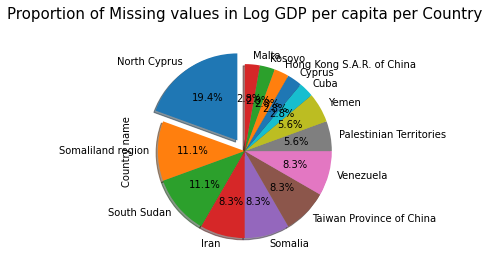

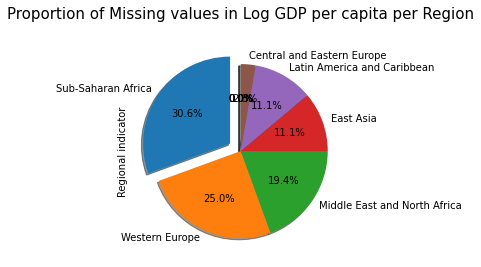

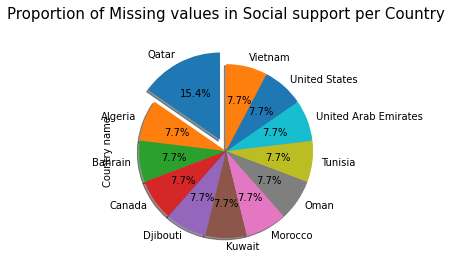

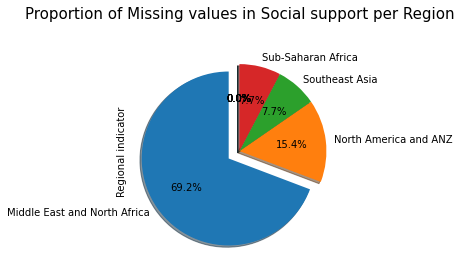

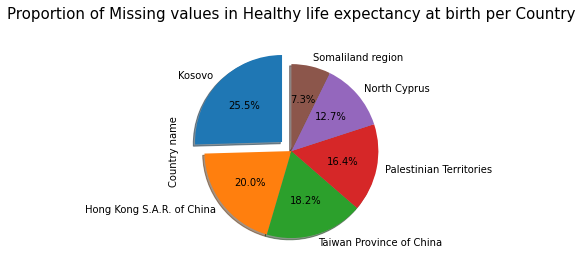

...

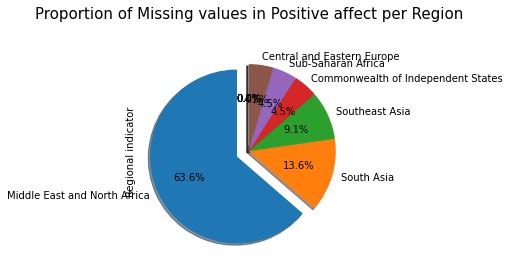

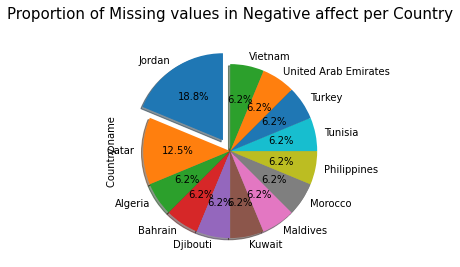

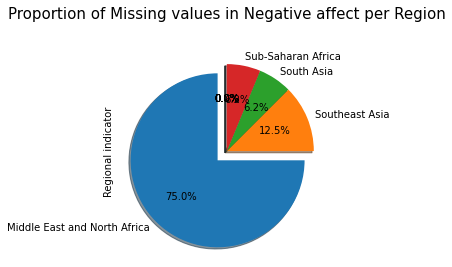

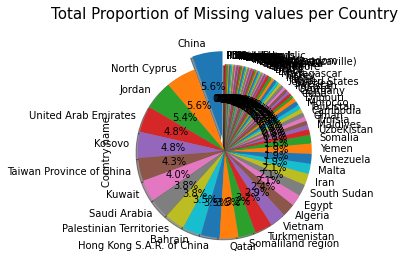

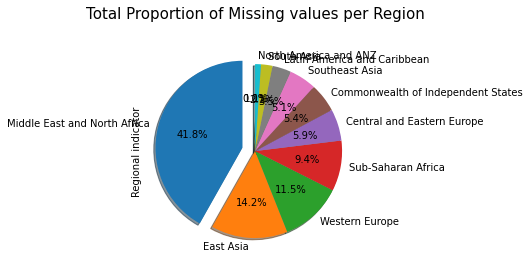

In [8]:
total_df_nan_country = pd.Series([])
total_df_nan_continent = pd.Series([])
nan_columns = list(df2.isnull().sum()[df2.isnull().sum()>0].index)
list_continents_piechart = list(continents)+["Others"]

for column_name in nan_columns:
    df_nan_country = df2["Country name"][df2[column_name].isnull()].value_counts()
    df_nan_country = df_nan_country.sort_values(ascending=False)
    df_nan_continent = pd.Series([0]*len(list_continents_piechart), index=list_continents_piechart)
    for country in list(df_nan_country.index):
        if country not in countries_df:
            country_to_continent = "Others"
        else:
            country_to_continent = list(set(df["Regional indicator"][df["Country name"] == country]))[0]
        df_nan_continent[country_to_continent] += df_nan_country[country]
    df_nan_continent = df_nan_continent.sort_values(ascending=False)   
    df_nan_continent.name = "Regional indicator"

    plt.figure()
    plt.title("Proportion of Missing values in " + column_name + " per Country\n", fontsize=15)
    df_nan_country.plot.pie(y=df_nan_country.index,
                              shadow=True,
                              explode=[0.15]+[0]*(df_nan_country.size-1),
                              startangle=90,
                              autopct='%1.1f%%')
    
    plt.figure()
    plt.title("Proportion of Missing values in " + column_name + " per Region\n", fontsize=15)
    df_nan_continent.plot.pie(y=df_nan_continent.index,
                              shadow=True,
                              explode=[0.15]+[0]*(df_nan_continent.size-1),
                              startangle=90,
                              autopct='%1.1f%%')
    
    total_df_nan_country = total_df_nan_country.add(df_nan_country, fill_value=0)
    total_df_nan_continent = total_df_nan_continent.add(df_nan_continent, fill_value=0)

total_df_nan_country = total_df_nan_country.sort_values(ascending=False)
total_df_nan_continent = total_df_nan_continent.sort_values(ascending=False)
total_df_nan_country.name = "Country name"
total_df_nan_continent.name = "Regional indicator"

plt.figure()
plt.title("Total Proportion of Missing values per Country\n", fontsize=15)
total_df_nan_country.plot.pie(y=total_df_nan_country.index,
                              shadow=True,
                              explode=[0.15]+[0]*(total_df_nan_country.size-1),
                              startangle=90,
                              autopct='%1.1f%%')

plt.figure()
plt.title("Total Proportion of Missing values per Region\n", fontsize=15)
total_df_nan_continent.plot.pie(y=total_df_nan_continent.index,
                              shadow=True,
                              explode=[0.15]+[0]*(total_df_nan_continent.size-1),
                              startangle=90,
                              autopct='%1.1f%%')



#### Nullity through Time

<Figure size 2880x1440 with 0 Axes>

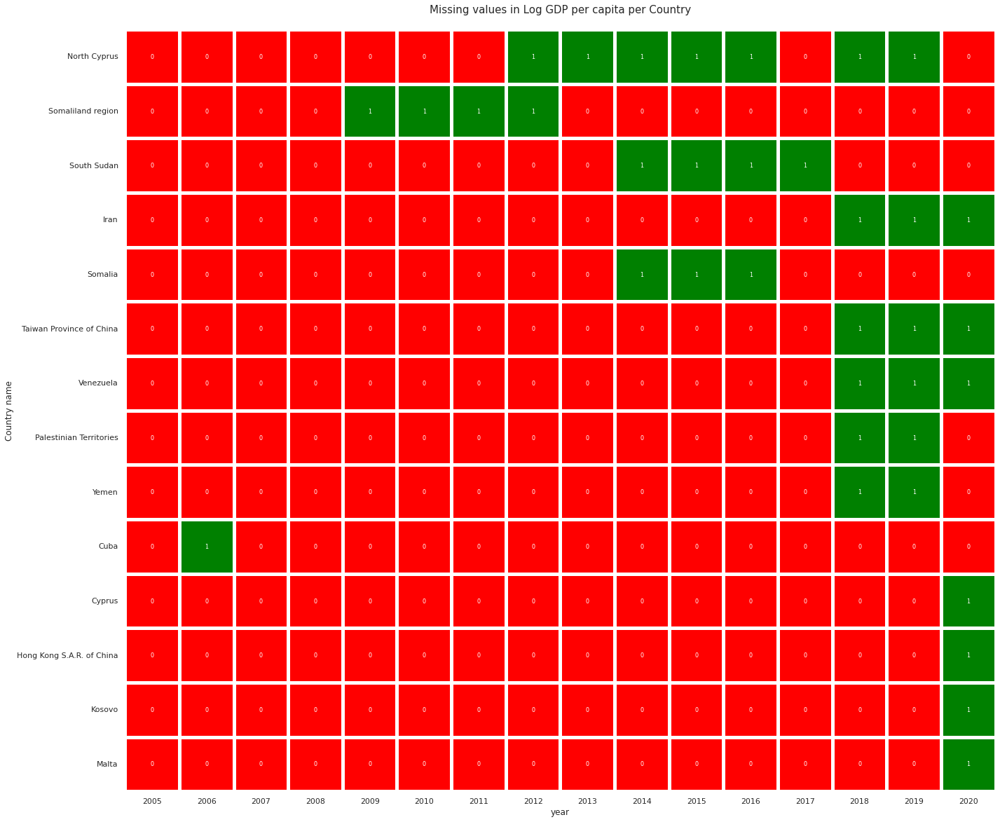

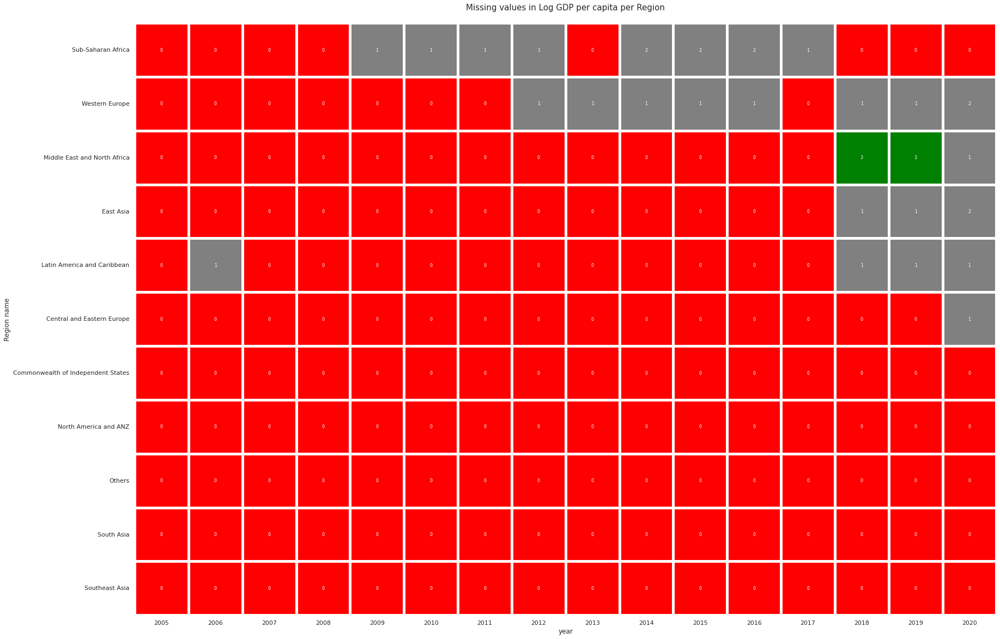

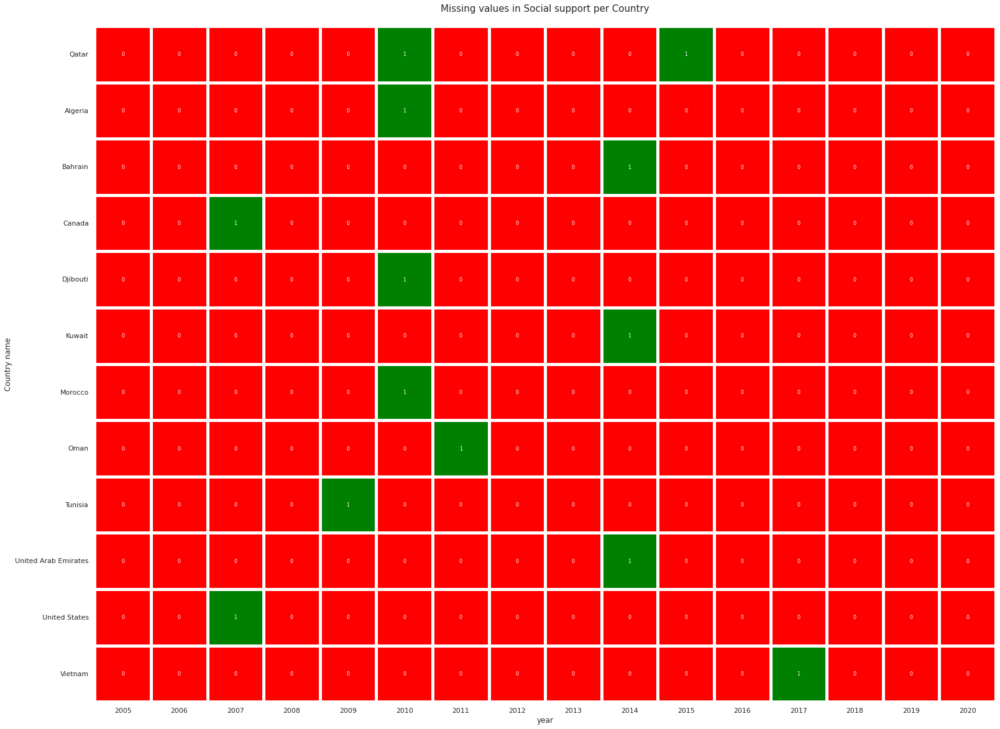

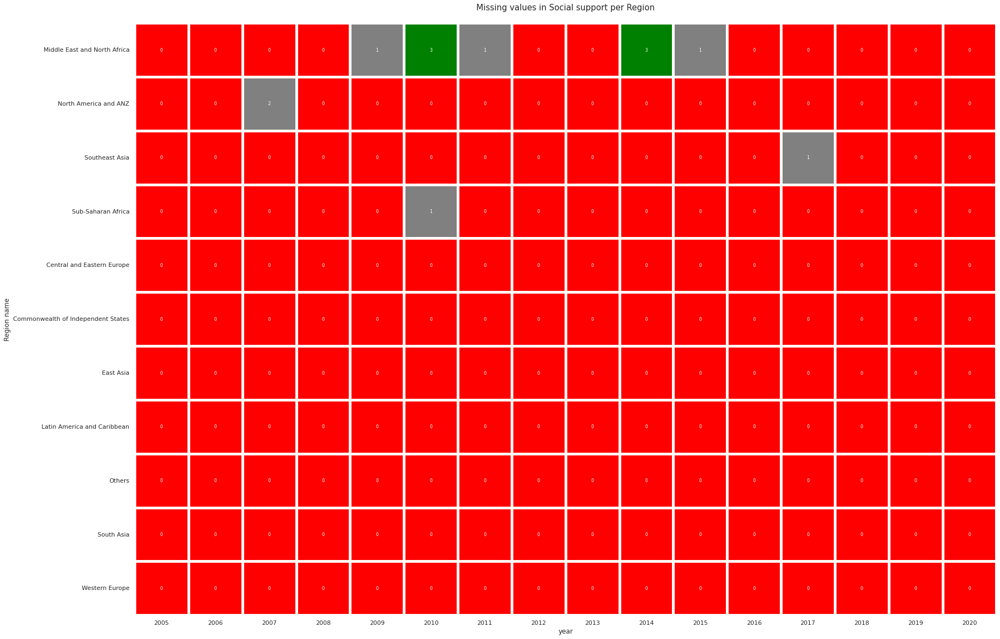

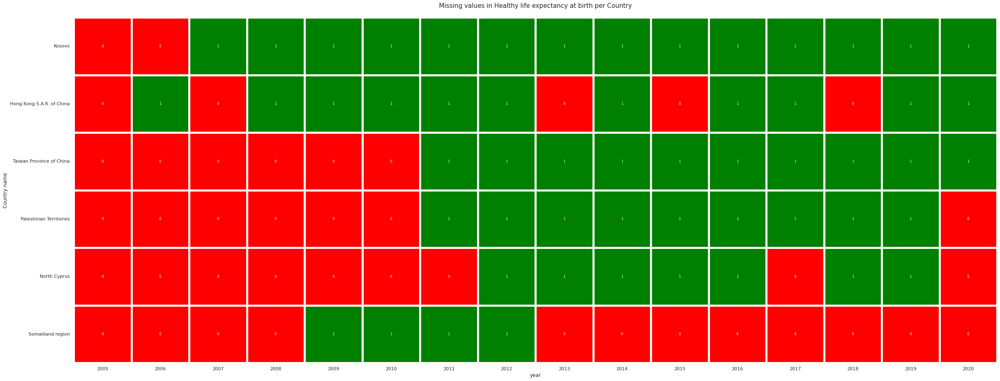

...

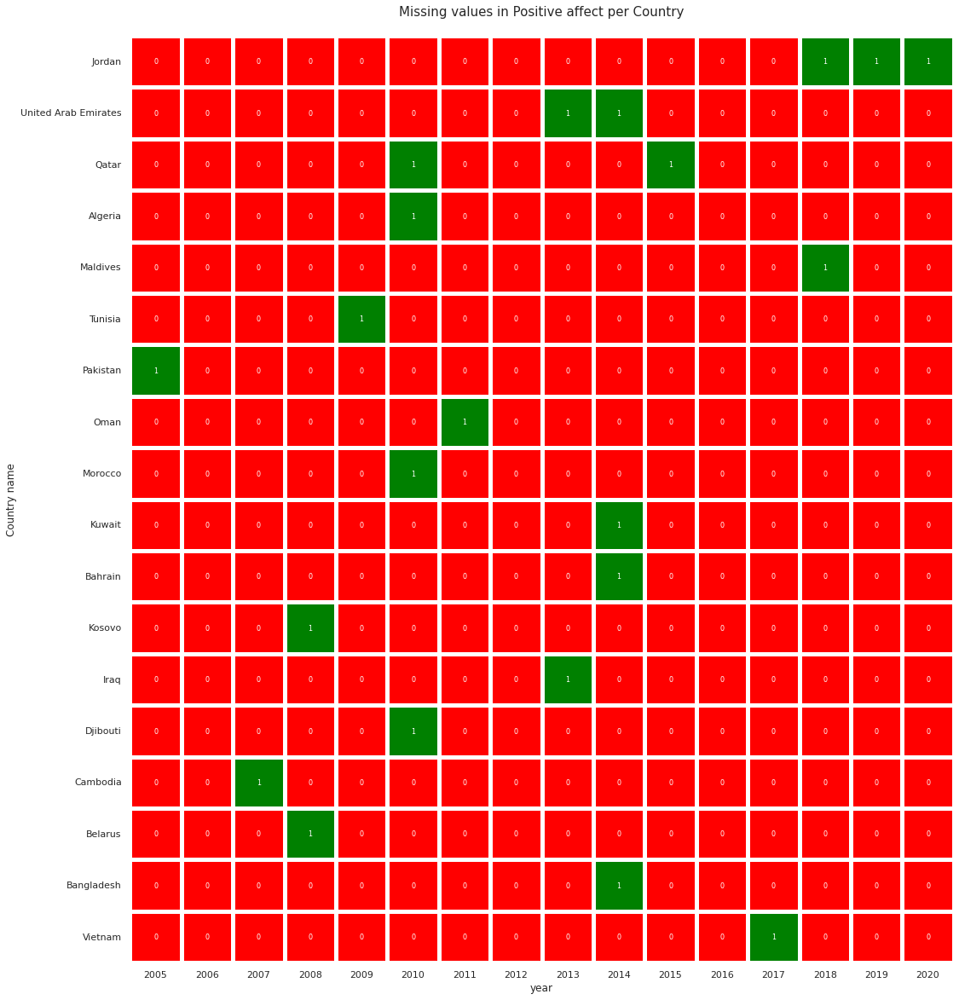

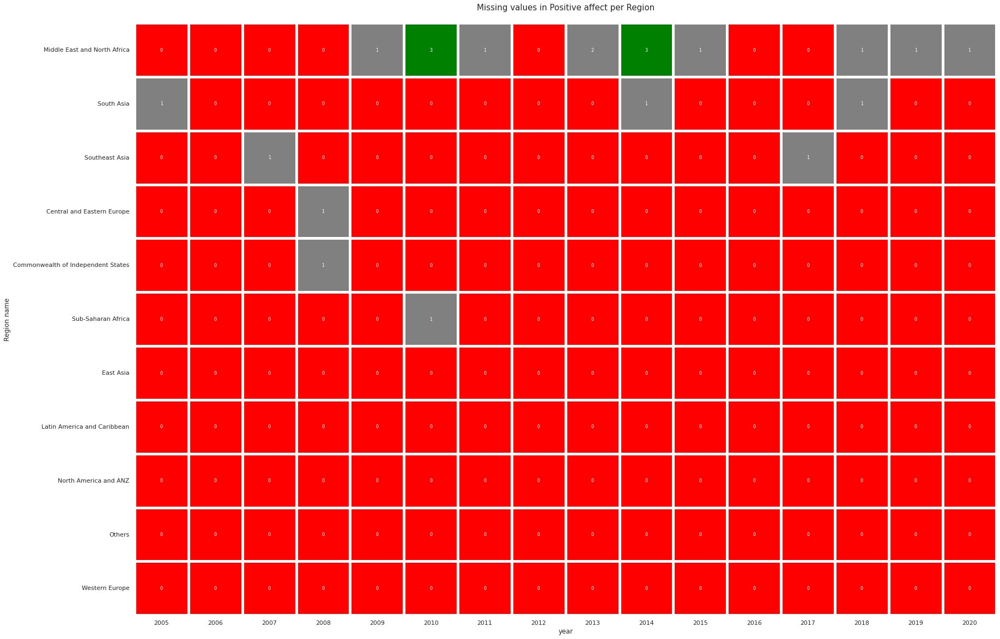

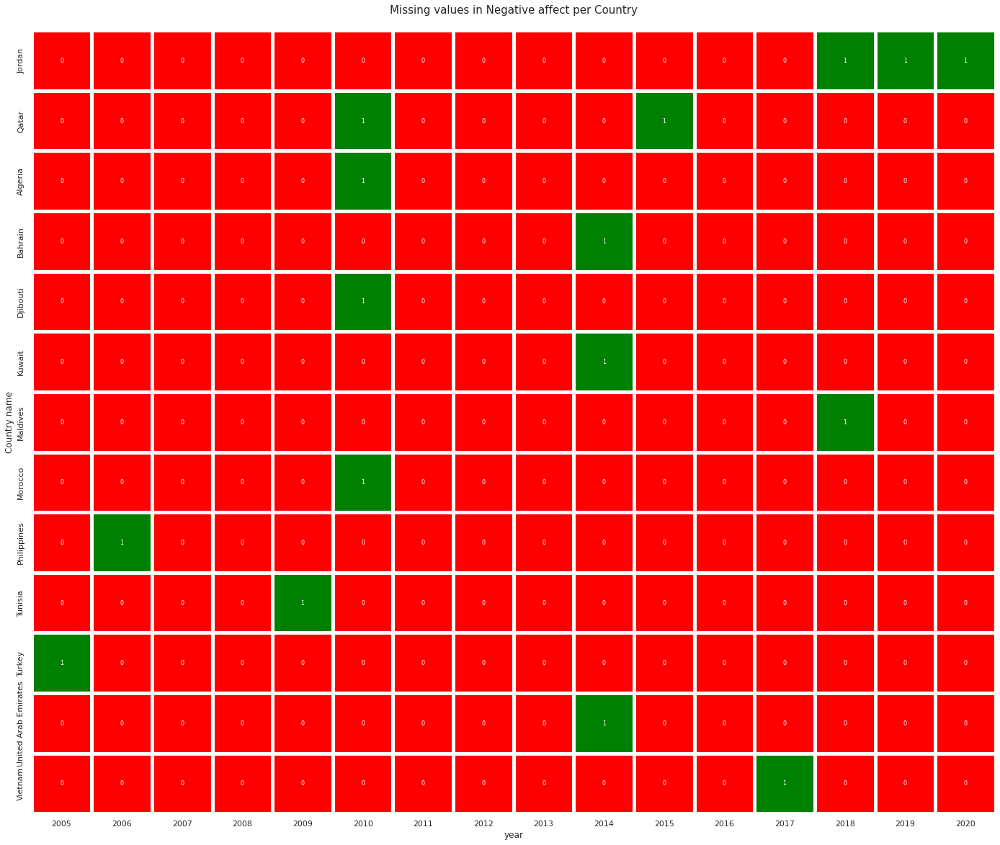

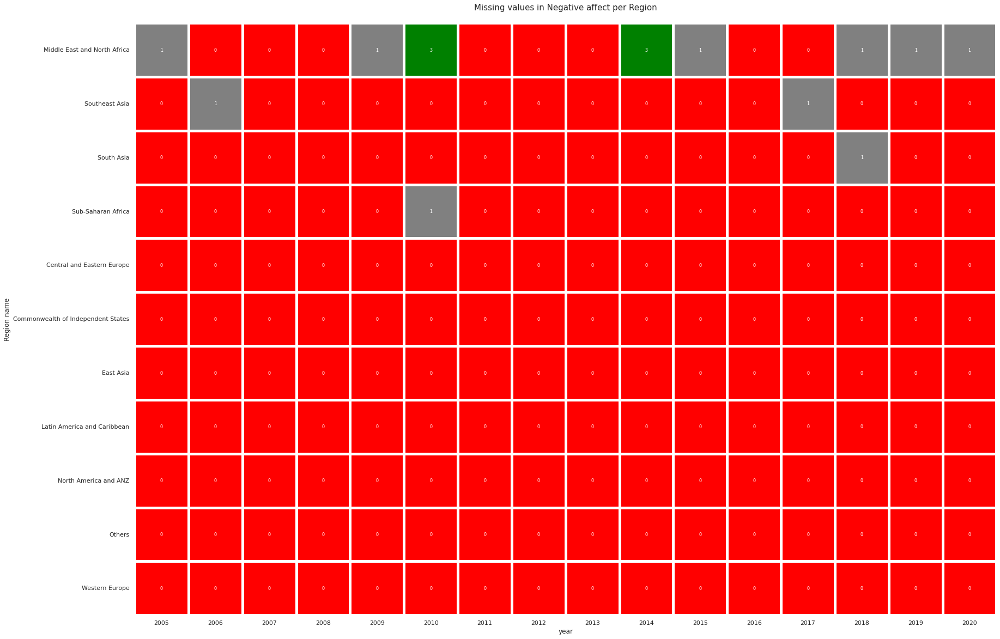

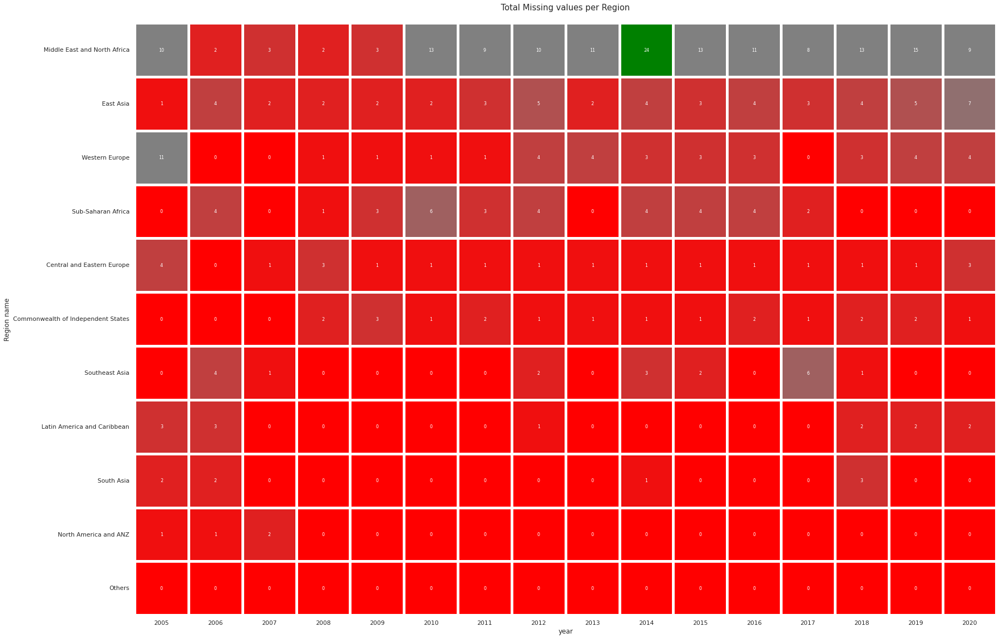

<Figure size 2880x1440 with 0 Axes>

In [12]:
years = sorted(set(df2["year"]))

colors = ["red",'gray','gray',"green"]
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", colors)

list_continents_heatmap = (list(continents)+["Others"])*len(years)
list_year_continent_heatmap = sorted(years*len((list(continents)+["Others"])))
list_count_continent_heatmap = [0] * len(list_continents_heatmap)

total_dataframe_continent_heatmap = pd.DataFrame({"Region name":list_continents_heatmap,
                                                "year":list_year_continent_heatmap,
                                                "count":list_count_continent_heatmap})

for column_name in nan_columns:
    nan_columns = list(df2.isnull().sum()[df2.isnull().sum()>0].index)
    df_nan_country = df2["Country name"][df2[column_name].isnull()].value_counts()
    list_country_heatmap = list(df_nan_country.index)*len(years)
    list_year_heatmap = sorted(years*len(list(df_nan_country)))
    list_count_heatmap = [0] * len(list_country_heatmap)
    dataframe_country_heatmap = pd.DataFrame({"Country name":list_country_heatmap,
                                      "year":list_year_heatmap,
                                      "count":list_count_heatmap})
    
    dataframe_continent_heatmap = pd.DataFrame({"Region name":list_continents_heatmap,
                                                "year":list_year_continent_heatmap,
                                                "count":list_count_continent_heatmap})
    
    for year in years:
        dataframe_year = df2[df2["year"]==year]
        dataframe_histplot = dataframe_year["Country name"][dataframe_year[column_name].isnull()]
        for country in list(dataframe_histplot):
            dataframe_country_heatmap["count"][(dataframe_country_heatmap["year"] == year) & (dataframe_country_heatmap["Country name"] == country)] = 1
            if country not in countries_df:
                country_to_continent = "Others"
            else:
                country_to_continent = list(set(df["Regional indicator"][df["Country name"] == country]))[0]
            dataframe_continent_heatmap["count"][(dataframe_continent_heatmap["year"] == year) & (dataframe_continent_heatmap["Region name"] == country_to_continent)] += 1
    total_dataframe_continent_heatmap["count"] += dataframe_continent_heatmap["count"]
    
    dataframe_country_heatmap = dataframe_country_heatmap.pivot("Country name", "year", "count")
    new_index = dataframe_country_heatmap.mean(axis=1).sort_values(ascending=False).index
    dataframe_country_heatmap = dataframe_country_heatmap.reindex(new_index)
    
    sns.set(rc={'figure.figsize':(40,20)})
    plt.title("Missing values in " + column_name + " per Country\n", fontsize=15)
    sns.heatmap(dataframe_country_heatmap,
                square=True,
                linewidth=5,
                cmap=cmap,
                cbar=False,
                annot=True,
                annot_kws={"size": 8})
    plt.figure()
    
    
    dataframe_continent_heatmap = dataframe_continent_heatmap.pivot("Region name", "year", "count")
    new_index = dataframe_continent_heatmap.mean(axis=1).sort_values(ascending=False).index
    dataframe_continent_heatmap = dataframe_continent_heatmap.reindex(new_index)
    
    plt.title("Missing values in " + column_name + " per Region\n", fontsize=15)
    sns.heatmap(dataframe_continent_heatmap,
                square=True,
                linewidth=5,
                cmap=cmap,
                cbar=False,
                annot=True,
                annot_kws={"size": 8})
    plt.figure()

    
total_dataframe_continent_heatmap.name = "Regional indicator"
total_dataframe_continent_heatmap = total_dataframe_continent_heatmap.pivot("Region name", "year", "count")
new_index = total_dataframe_continent_heatmap.mean(axis=1).sort_values(ascending=False).index
total_dataframe_continent_heatmap = total_dataframe_continent_heatmap.reindex(new_index)

plt.title("Total Missing values per Region\n", fontsize=15)
sns.heatmap(total_dataframe_continent_heatmap,
            square=True,
            linewidth=5,
            cmap=cmap,
            cbar=False,
            annot=True,
            annot_kws={"size": 8})
plt.figure()

We can interpret the missing values in several ways, indeed the cause may be due to an issue with the collecter or from the source.
We can observe missing values in some specific region during some specific years and for some specific factors, missing values from factors that require global information may be due to some missing informations during period time of an event as a war or a pandemic... Or because the country itself is not well develloped or have restictions to produce the informations, surveys also contains missing values, in this case the sources are individual population where maybe they were not willing to answer or the pollster could not access to the respondents.

It could be interesting to match any political, economical events to the missing values.

####  Nullity Matrix

'The sparkline at right summarizes the general shape of the data completeness and points out \nthe rows with the maximum and minimum nullity in the dataset.'

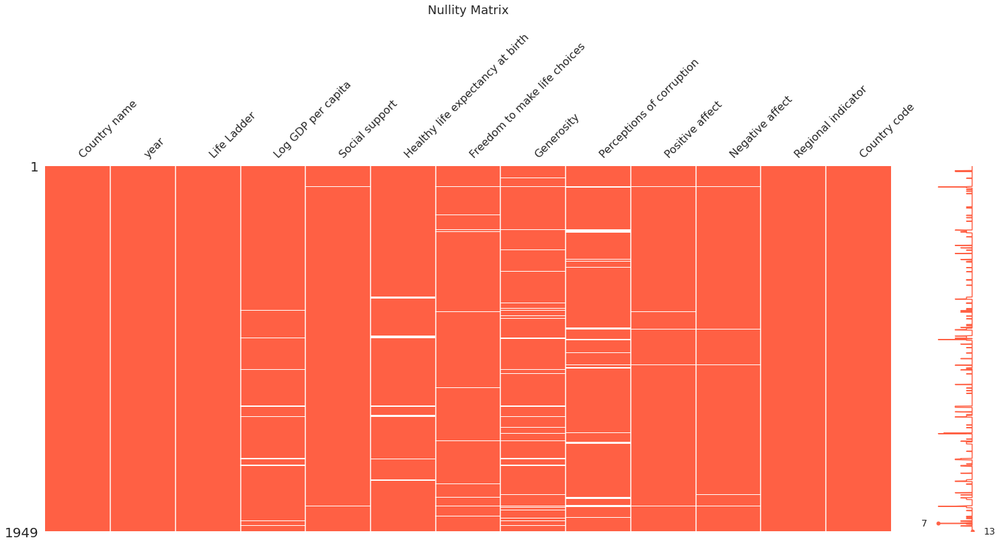

In [13]:
msno.matrix(df2, color=(1, 0.38, 0.27))
plt.title("Nullity Matrix\n", fontsize=18)

'''The sparkline at right summarizes the general shape of the data completeness and points out 
the rows with the maximum and minimum nullity in the dataset.'''

#### Nullity Histogram

Text(0.5, 1.0, 'Nullity Histogram\n')

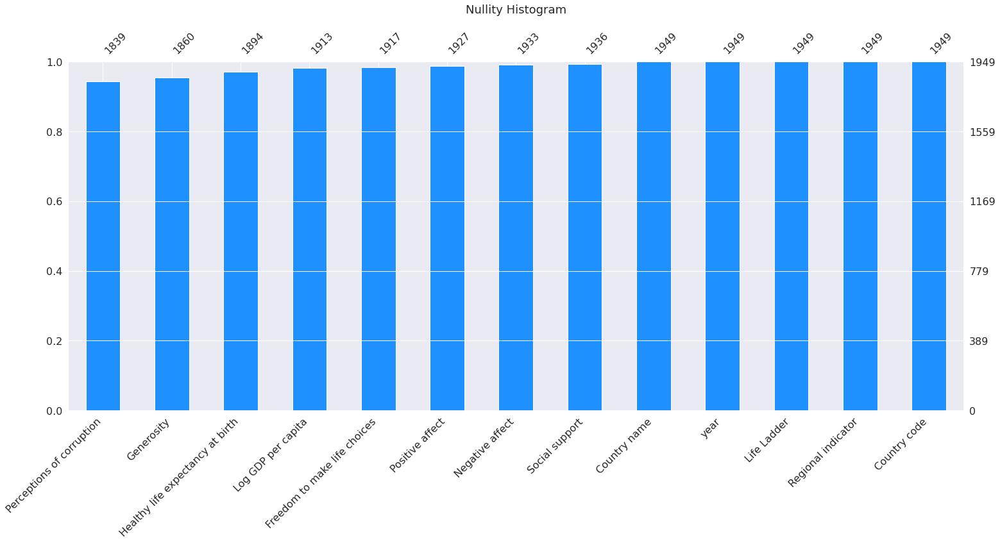

In [14]:
msno.bar(df2,color="dodgerblue", sort="ascending")
plt.title("Nullity Histogram\n", fontsize=18)

#### Nullity Heatmap (Pearson Correlation)

'-1 Exact Negative correlation represents that if the value of one variable is present then the value of other variables is definitely absent.\n0 No correlation represents that variables values present or absent do not have any effect on one another.\n1 Exact Positive correlation represents that if the value of one variable is present then the value of the other is definitely present.'

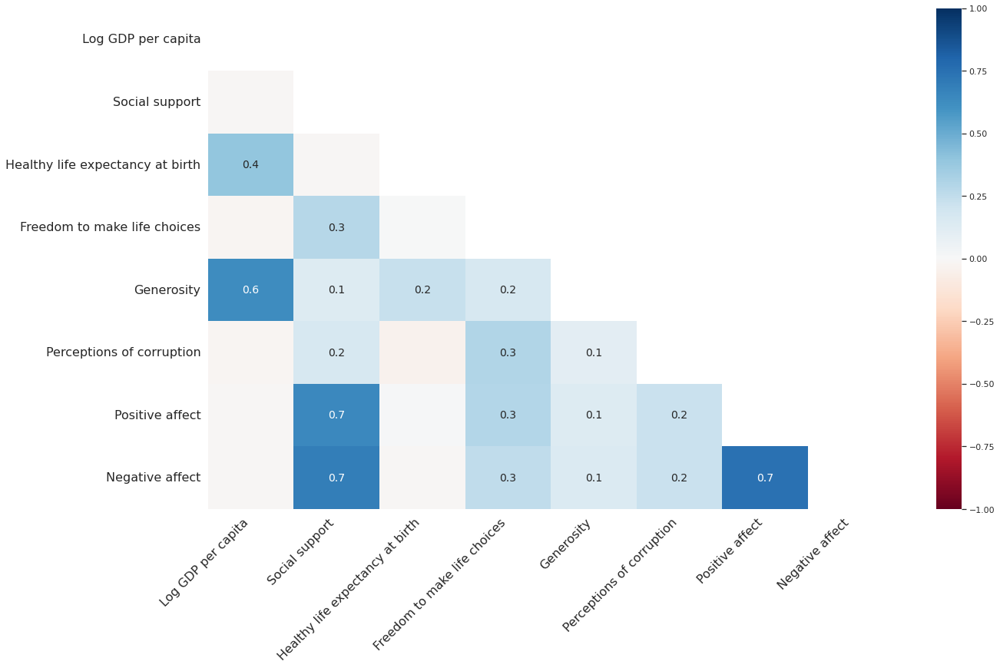

In [15]:
msno.heatmap(df2)
'''-1 Exact Negative correlation represents that if the value of one variable is present then the value of other variables is definitely absent.
0 No correlation represents that variables values present or absent do not have any effect on one another.
1 Exact Positive correlation represents that if the value of one variable is present then the value of the other is definitely present.'''

#### Nullity Dendrogram

<AxesSubplot:>

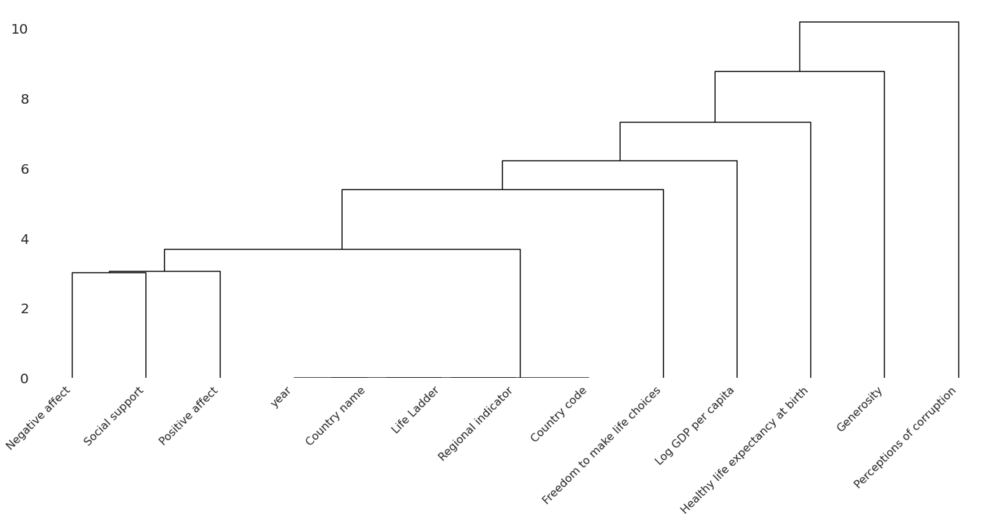

In [16]:
msno.dendrogram(df2, method="centroid", orientation="top")

<AxesSubplot:>

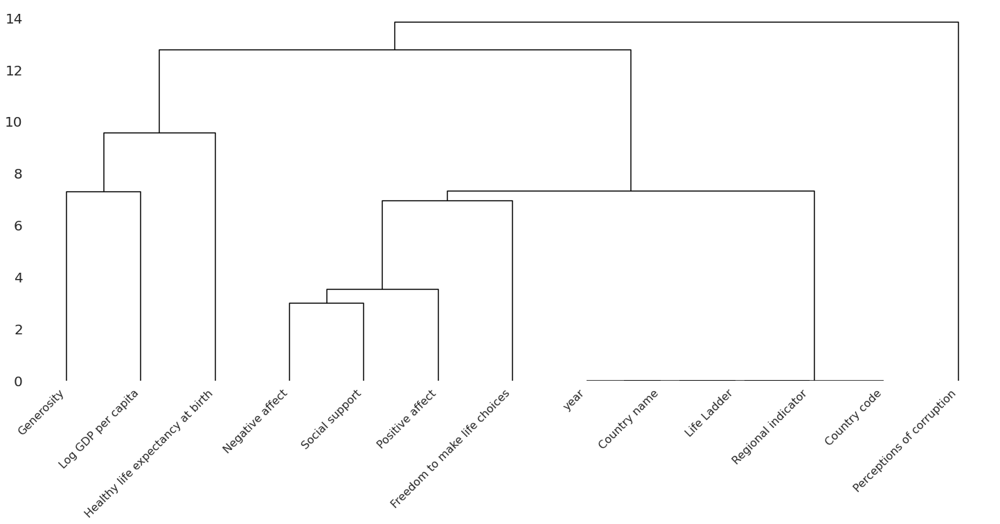

In [17]:
msno.dendrogram(df2, method="ward", orientation="top")

We can observe from the [Nullity-Heatmap-(Pearson-Correlation)](#Nullity-Heatmap-(Pearson-Correlation)) that the missing values from social factors in particular, **Social support**, **Positive** and **Negative affect** can be explained each other. The same observation can be done with the **Generosity** and the **Log GDP per capita**

From the [Nullity Dendrogram](#Nullity-Dendrogram) we can conclude that we can build 5 or more Missing values clusters, first one contains the **year**, **Country name** and **Life Ladder** variables which have a deep connection in term of Missing values (indeed they do not contain any Missing value), we can also observe an high connection between **Social support**, **Positive** and **Negative affect** factors which is confirmed by the [Nullity-Heatmap-(Pearson-Correlation)](#Nullity-Heatmap-(Pearson-Correlation)), we can interpret that the poll procedure for getting **Social support**, **Positive** and **Negative affect** is the same, indeed from the [Nullity Matrix](#Nullity Matrix), those missing values are for the same records. 

We observe less connection between the missing values from **Generosity**, **Log GDP per capita** and **Healthy life expectancy at birth** and small connection for others factors that are clustered itself.

Note that we also have complete missing records in some years for some countries, indeed it does not appears in the missing value analysis (where it can miss one survey over the others), we can determine it by the fact that some countries have records in the first years of the **World Happiness Report** (from 2005) and others countries does not have ([Country](#Time---Country)). It could be interesting to make extrapolation for getting those missing records.

## Descriptive Statistics

Let us now focus on the available data and mostly on **Life Ladder (Happiness score)** and start to describe the data we have and extract the most information possible.

### Univariate Analysis

We will display charts to visualize the distrubition of each the features, it will allow to determine if any of the features follow any specific trend/distribution or contains outliers and it will help us to apply required data transformation for some statistical model in the next.

From [Detailed information about each of the factors](#Detailed-information-about-each-of-the-factors) we know that range value from **Life Ladder (Happiness score)** is 0 to 10, let us set a threshold of **5** as the limit of happy/unhappy. 

In [18]:
threshold_happy = 5

df_hap = df2.copy(deep=True)
df_hap["Happy"] = [1 if value > threshold_happy else 0 for value in df_hap["Life Ladder"]]

In [19]:
df_hap.describe()

,year,Life Ladder,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,Happy
count,1949.000000,1949.000000,1913.000000,1936.000000,1894.000000,1917.000000,1860.000000,1839.000000,1927.000000,1933.000000,1949.000000
mean,2013.216008,5.466705,9.368453,0.812552,63.359374,0.742558,0.000103,0.747125,0.710003,0.268544,0.636224
std,4.166828,1.115711,1.154084,0.118482,7.510245,0.142093,0.162215,0.186789,0.107100,0.085168,0.481209
min,2005.000000,2.375000,6.635000,0.290000,32.300000,0.258000,-0.335000,0.035000,0.322000,0.083000,0.000000
25%,2010.000000,4.640000,8.464000,0.749750,58.685000,0.647000,-0.113000,0.690000,0.625500,0.206000,0.000000
50%,2013.000000,5.386000,9.460000,0.835500,65.200000,0.763000,-0.025500,0.802000,0.722000,0.258000,1.000000
75%,2017.000000,6.283000,10.353000,0.905000,68.590000,0.856000,0.091000,0.872000,0.799000,0.320000,1.000000
max,2020.000000,8.019000,11.648000,0.987000,77.100000,0.985000,0.698000,0.983000,0.944000,0.705000,1.000000


#### Box Plot

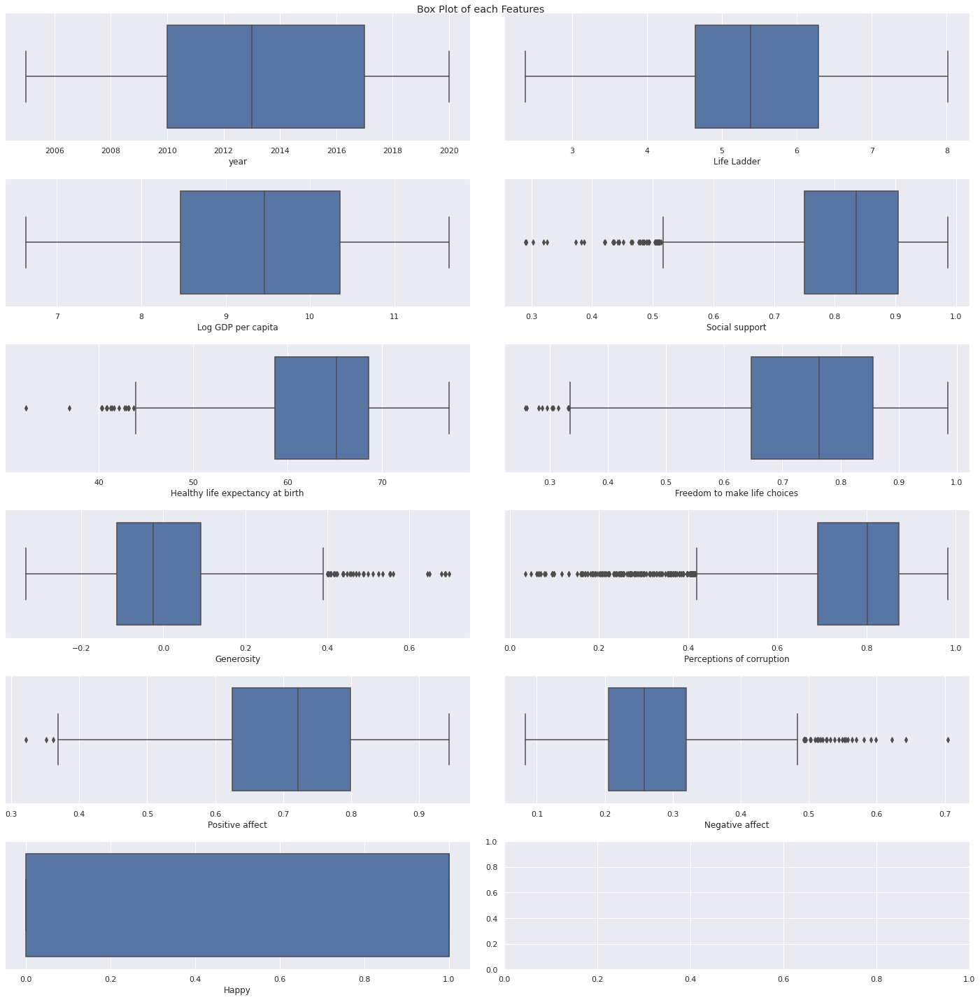

In [20]:
fig, axes = plt.subplots(6, 2, figsize=(20, 20))
fig.suptitle('Box Plot of each Features')
for column_name, ax in zip(list(df_hap.describe().columns), axes.flat):
    fig.tight_layout()
    sns.boxplot(data=df_hap, x=df_hap[column_name], ax=ax)

#### Violin Plot

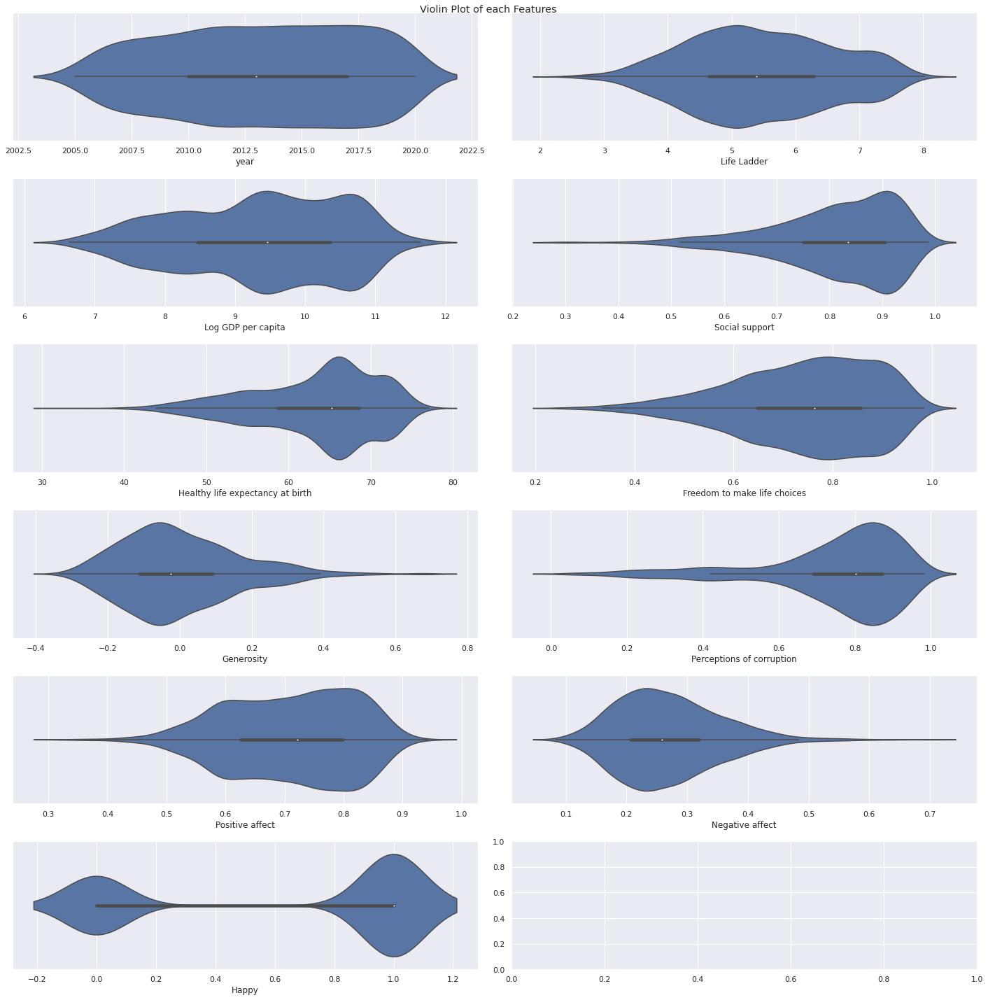

In [21]:
fig, axes = plt.subplots(6, 2, figsize=(20, 20))
fig.suptitle('Violin Plot of each Features')
for column_name, ax in zip(list(df_hap.describe().columns), axes.flat):
    fig.tight_layout()
    sns.violinplot(data=df_hap, x=df_hap[column_name], ax=ax)

#### Histogram

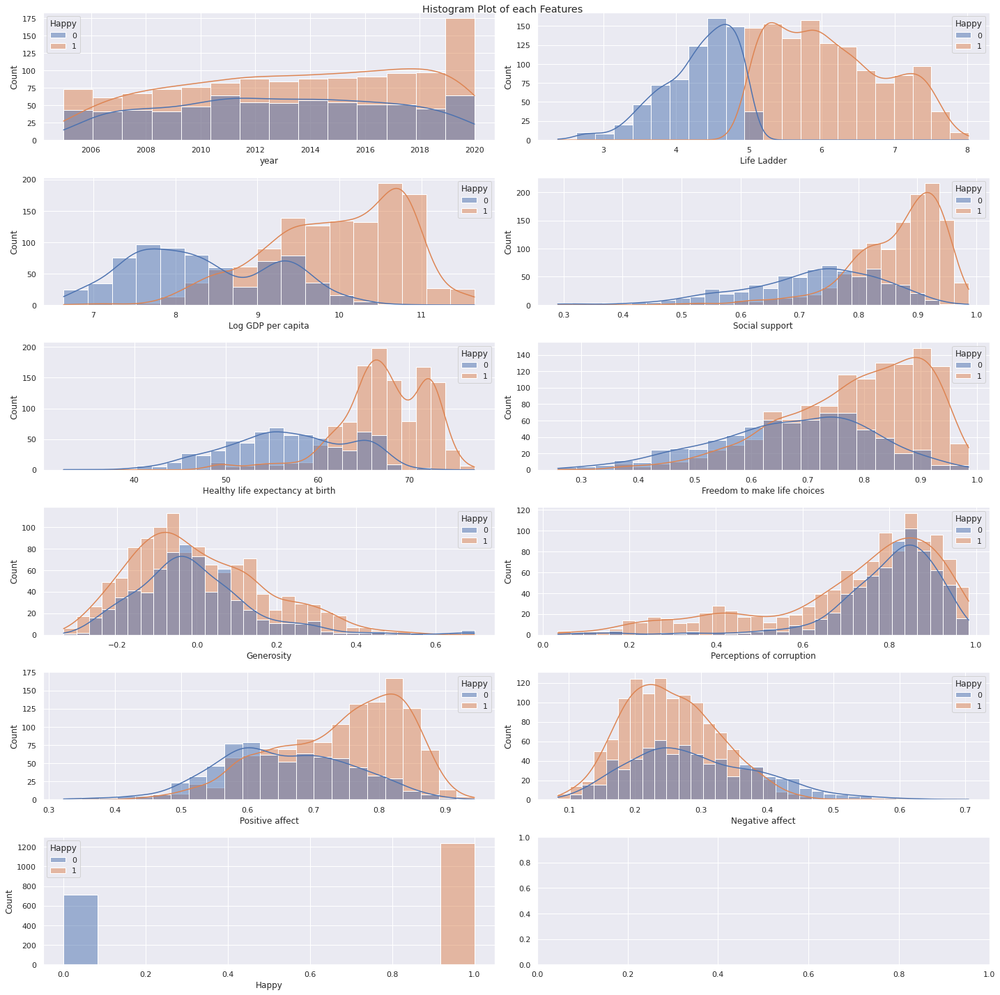

In [22]:
fig, axes = plt.subplots(6, 2, figsize=(20, 20))
fig.suptitle('Histogram Plot of each Features')
for column_name, ax in zip(list(df_hap.describe().columns), axes.flat):
    fig.tight_layout()
    sns.histplot(data=df_hap, x=df_hap[column_name], ax=ax, kde=True, hue="Happy")

From those charts we can observe some trends regarding the **Life Ladder (Happiness score)**, happy countries tend to have logically higher **Positive affect**, and lower **Negative affect**, higher **Freedom to make life choices** and higher **Healthy life expectancy at birth**, higher **Social support** and higher **GDP per capita** than unhappy country

### Multivariate Analysis

Let us explain the **Life Ladder (Happiness score)** factor using multivariate analysis, previously we only analyzed each features "alone", now we will see how **Life Ladder (Happiness score)** can be explained by the other factors.

As we observed before from [Histogram](#Histogram), there are some trends between **Life Ladder (Happiness score)** and **Log GDP per capita**, **Freedom to make life choices**, **Healthy life expectancy at birth** and **Social support**, less with **Positive affect** and far less with **Perceptions of Corruption** and **Negative affect**, we can observe and measure that from the following charts

#### Pair Plot

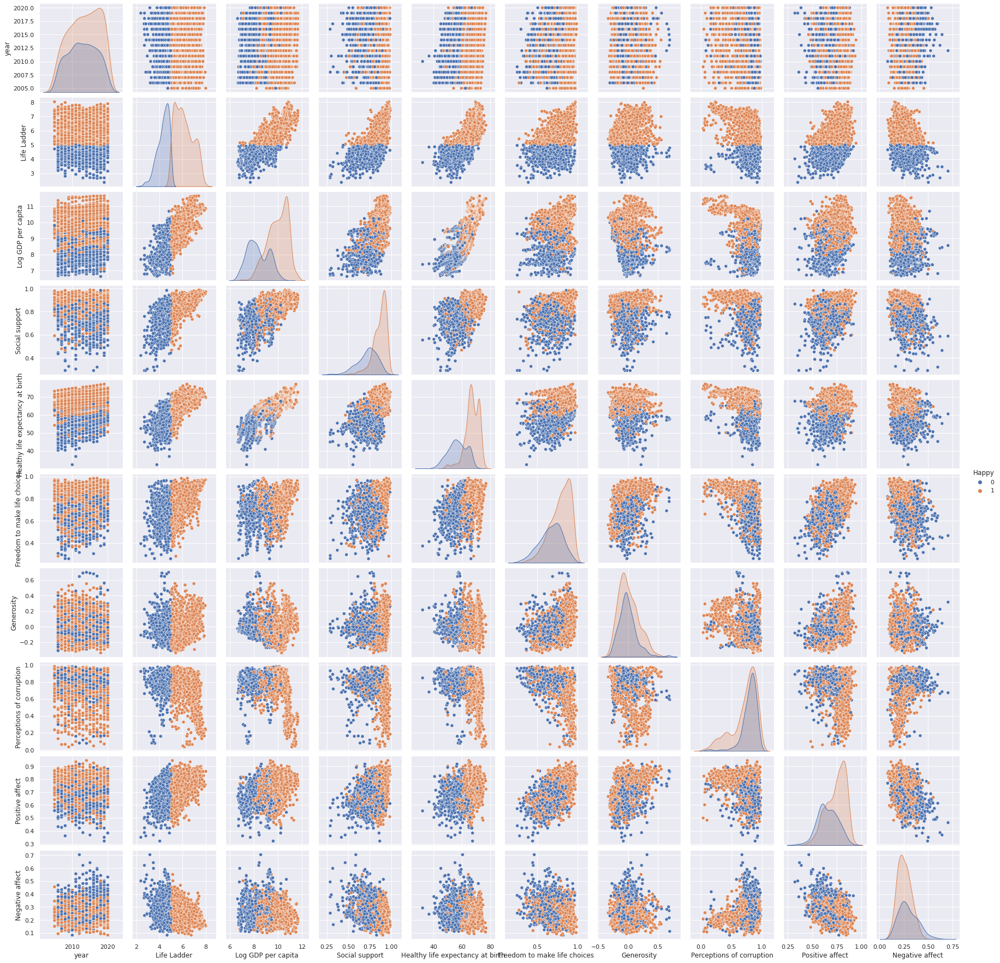

In [23]:
sns.pairplot(df_hap,hue="Happy")

#### Correlation Matrix

Let's use different measure for the correlation instead of using only the linear correlation measure (Pearson Correlation Matrix), indeed we can see that our data have some monotonic shape.

##### Pearson Correlation Matrix

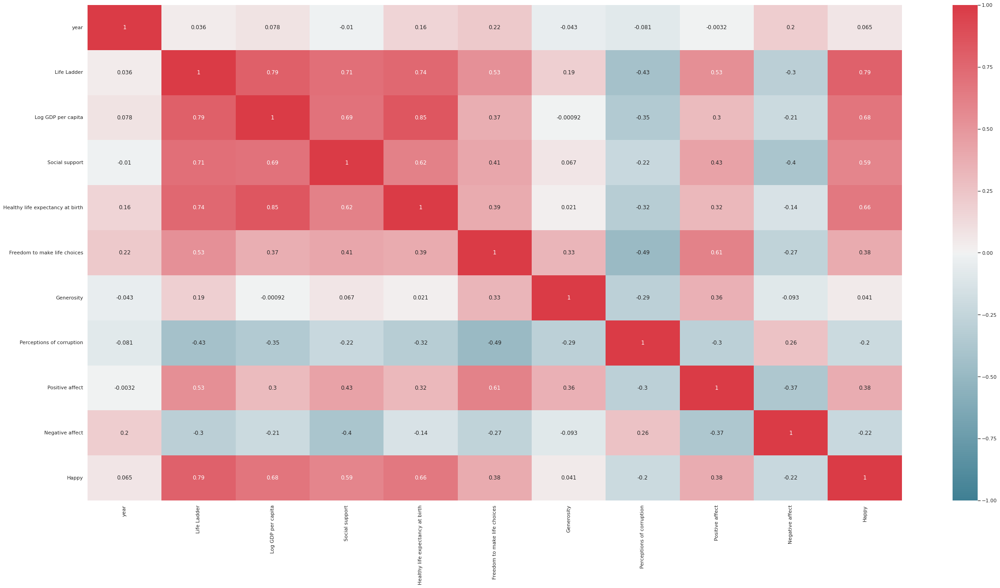

In [24]:
sns.heatmap(df_hap.corr(method="pearson"), 
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap = sns.diverging_palette(220, 10, as_cmap=True));

##### Kendall Correlation Matrix

This correlation measure based on concordance value will allow to find more relationship in monotonic shape data instead of the linear one

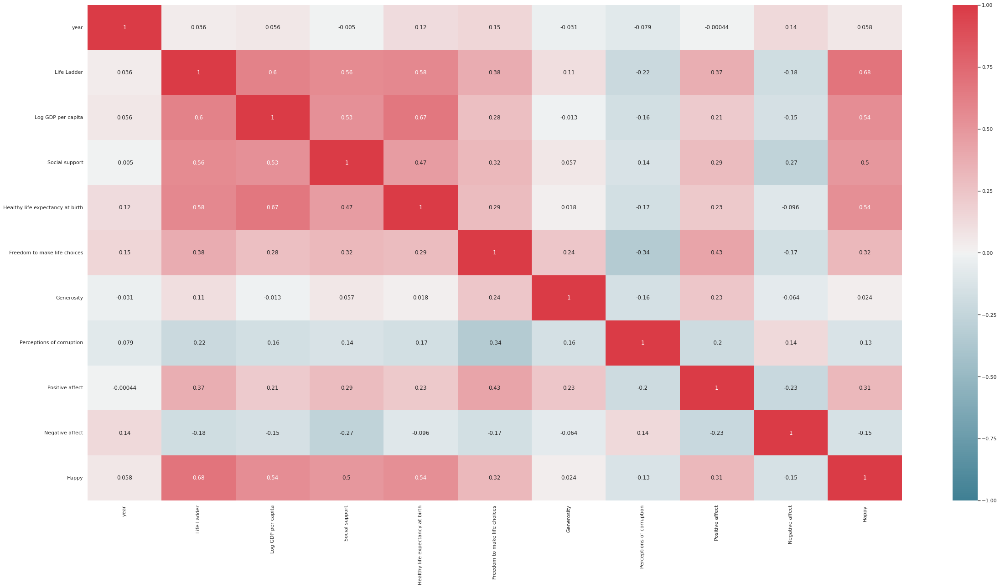

In [25]:
sns.heatmap(df_hap.corr(method="kendall"), 
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap = sns.diverging_palette(220, 10, as_cmap=True));

##### Spearman Correlation Matrix

This correlation measure based on rank value will allow to find more relationship as the Kendall one instead of linear one

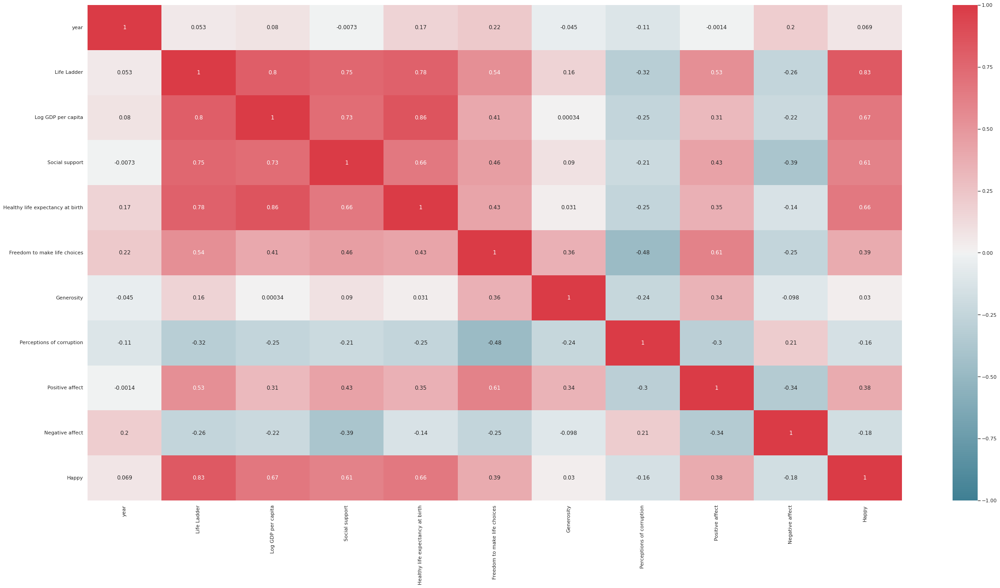

In [26]:
sns.heatmap(df_hap.corr(method="spearman"), 
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap = sns.diverging_palette(220, 10, as_cmap=True));

From the [Pair Plot](#Pair-Plot) and the [Correlation Matrix](#Correlation-Matrix) ([Pearson Correlation Matrix](#Pearson-Correlation-Matrix), [Kendall Correlation Matrix](#Kendall-Correlation-Matrix), [Spearman Correlation Matrix](#Spearman-Correlation-Matrix)) we can interpret that there are some strong positive relationships between some features, like the **Life Ladder (Happiness score)** and **Log GDP per capita** (0.80), **Healthy life expectancy at birth** (0.78) and **Social support** (0.75), and a moderate positive relationship with **Freedom to make life choices** (0.54) and **Positive affect** (0.53), and a weak negative relationship with **Perceptions of Corruption** (-0.32) and **Negative affect** (-0.26).

We can also make interpretation between the others features, high **Log GDP per capita** tend to have high **Healthy life expectancy at birth** and **Social support**

#### Location

Now let's see the behavior through parts of the world, indeed we observed all the factors in worldwide while the population behavior can be different through the differents region over the world

##### Region

<Figure size 2880x1440 with 0 Axes>

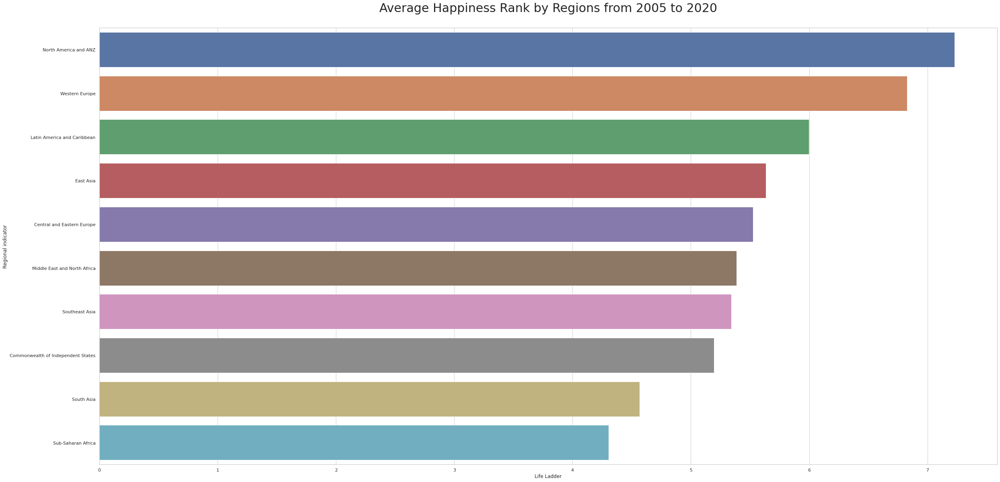

<Figure size 2880x1440 with 0 Axes>

In [27]:
df_happiness_rank_continent = df2.groupby("Regional indicator")["Life Ladder"].mean().sort_values(ascending=False)
df_happiness_rank_continent = pd.DataFrame({'Regional indicator':df_happiness_rank_continent.index, 'Life Ladder':df_happiness_rank_continent.values})

sns.set_theme(style="whitegrid")
plt.title("Average Happiness Rank by Regions from 2005 to 2020\n", fontsize=30)
sns.barplot(x="Life Ladder", y="Regional indicator", data=df_happiness_rank_continent)
plt.figure()

<Figure size 2880x1440 with 0 Axes>

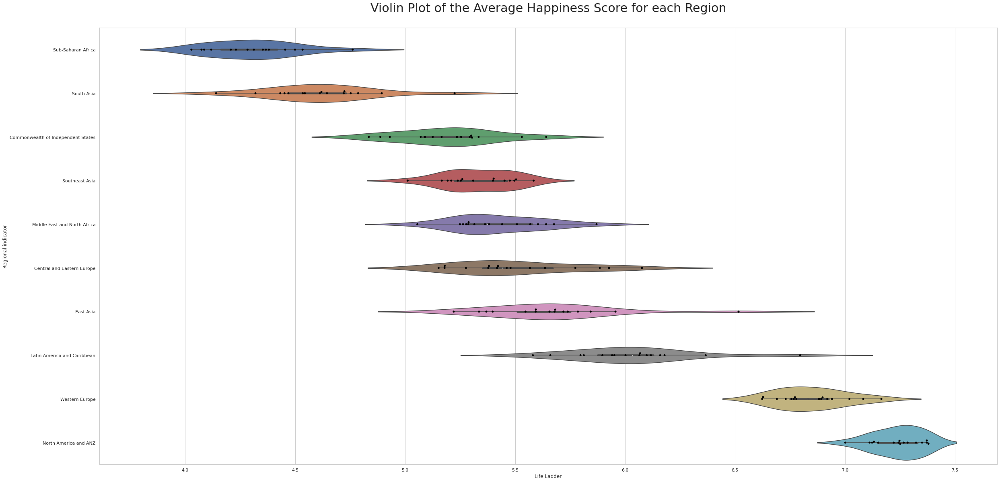

<Figure size 2880x1440 with 0 Axes>

In [28]:
df_continent_year_mean = df2.groupby(["Regional indicator","year"]).mean().sort_values(by="Life Ladder", ascending=True)
df_continent_year_mean = pd.DataFrame({'Regional indicator':[value[0] for value in df_continent_year_mean.index], 
                                        'year':[value[1] for value in df_continent_year_mean.index],
                                       'Life Ladder':list(df_continent_year_mean["Life Ladder"])})

plt.title("Violin Plot of the Average Happiness Score for each Region\n", fontsize=30)
sns.violinplot(x="Life Ladder", y="Regional indicator",
                    data=df_continent_year_mean)
sns.swarmplot(x="Life Ladder", y="Regional indicator",
                    data=df_continent_year_mean, color="0")
plt.figure()

<Figure size 2880x1440 with 0 Axes>

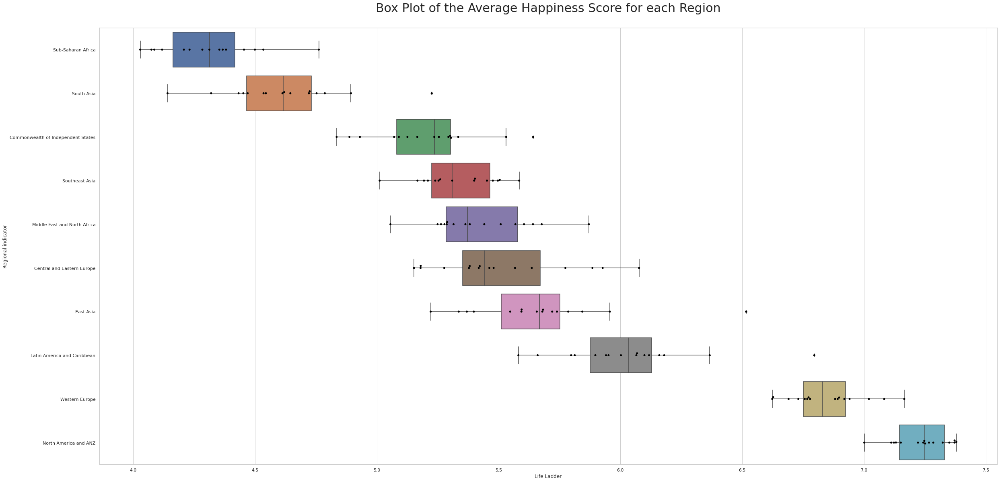

<Figure size 2880x1440 with 0 Axes>

In [29]:
plt.title("Box Plot of the Average Happiness Score for each Region\n", fontsize=30)
sns.boxplot(x="Life Ladder", y="Regional indicator",
                    data=df_continent_year_mean)
sns.swarmplot(x="Life Ladder", y="Regional indicator",
                    data=df_continent_year_mean, color="0")
plt.figure()

##### Country

<Figure size 2880x1440 with 0 Axes>

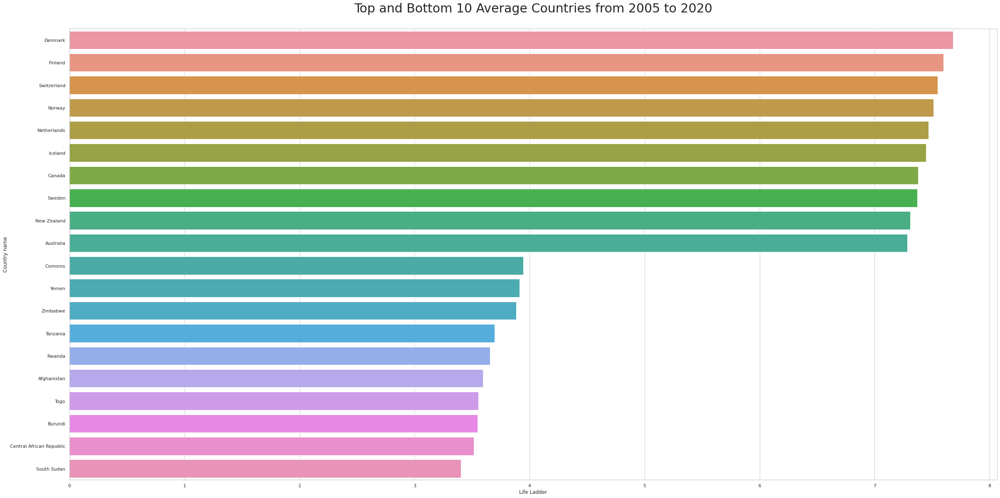

<Figure size 2880x1440 with 0 Axes>

In [30]:
df_happiness_rank_country = df2.groupby("Country name")["Life Ladder"].mean().sort_values(ascending=False)
df_happiness_rank_country = pd.DataFrame({'Country name':df_happiness_rank_country.index, 'Life Ladder':df_happiness_rank_country.values})

top_param = 10

df_happiness_rank_country_top = df_happiness_rank_country[:top_param]
df_happiness_rank_country_bottom = df_happiness_rank_country.sort_values(by=["Life Ladder"],ascending=True)[:top_param].sort_values(by=["Life Ladder"],ascending=False)

df_happiness_rank_country_top_bottom = df_happiness_rank_country_top.append(df_happiness_rank_country_bottom)

sns.set_theme(style="whitegrid")
plt.title("Top and Bottom " + str(top_param) + " Average Countries from 2005 to 2020\n", fontsize=30)
sns.barplot(x="Life Ladder", y="Country name", data=df_happiness_rank_country_top_bottom)
plt.figure()

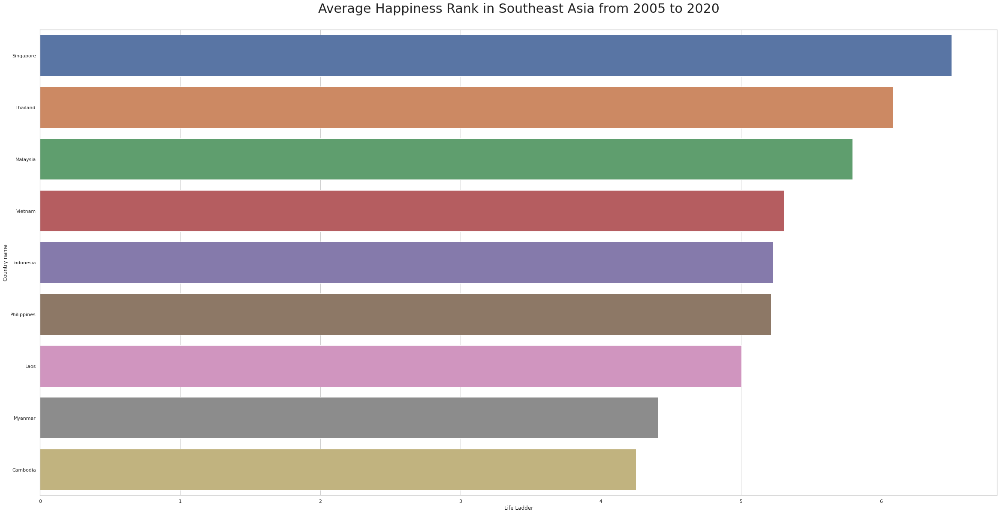

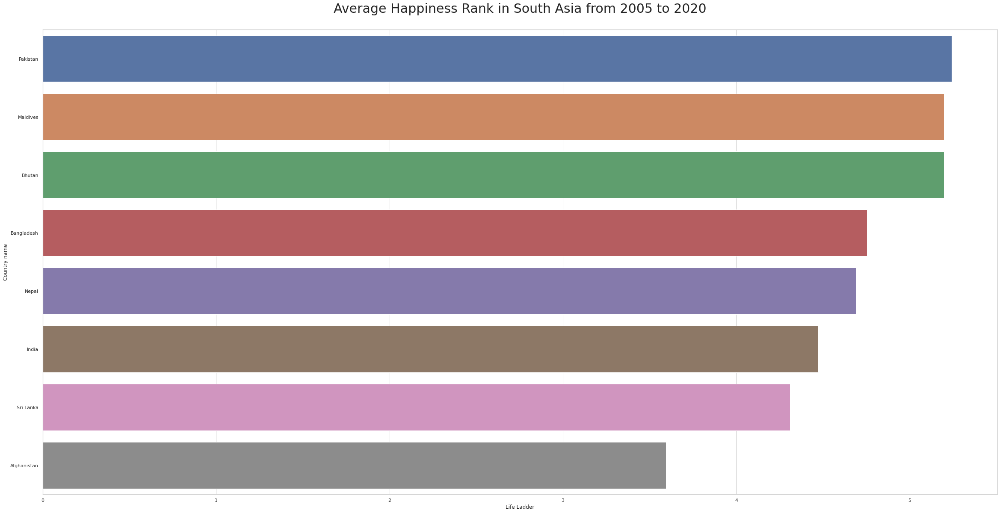

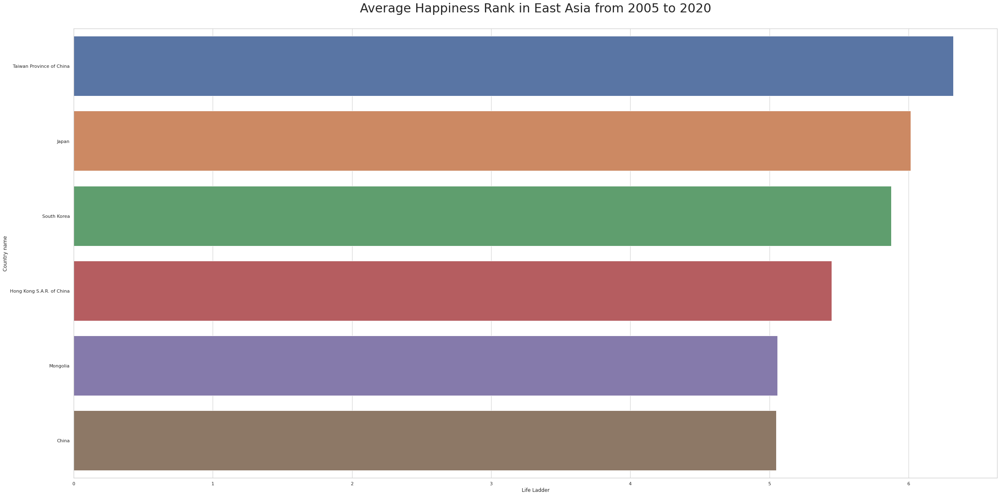

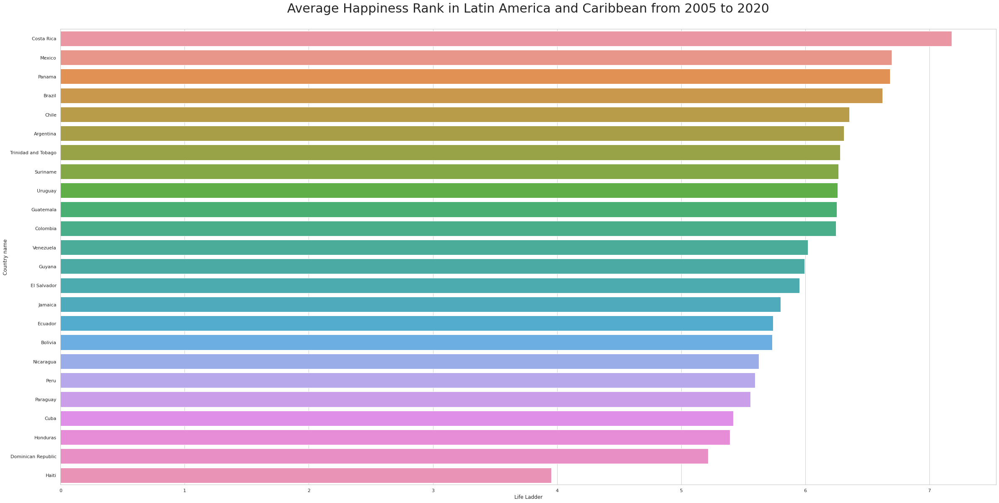

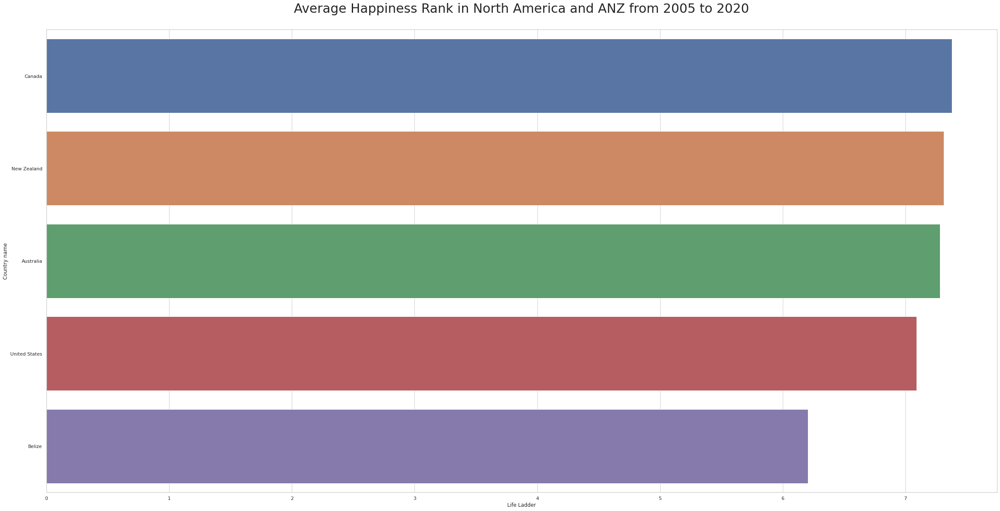

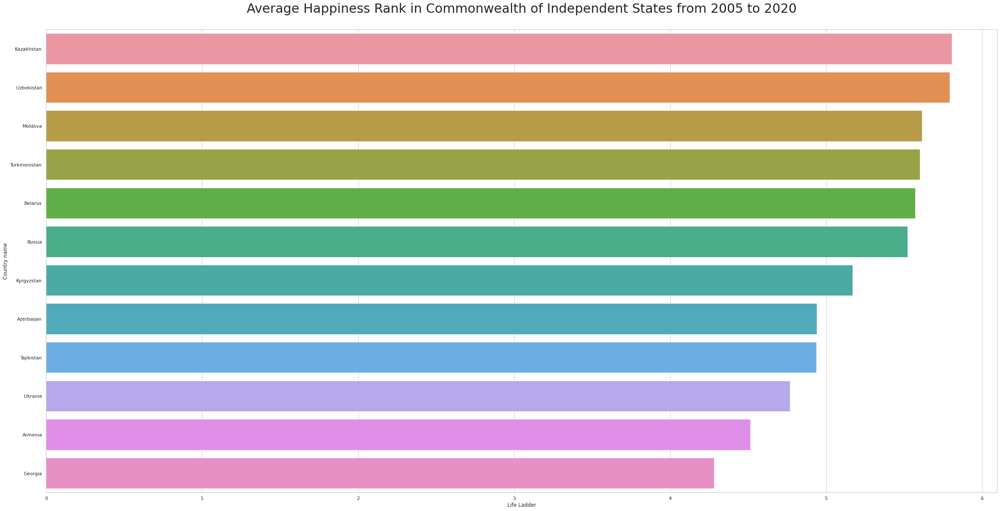

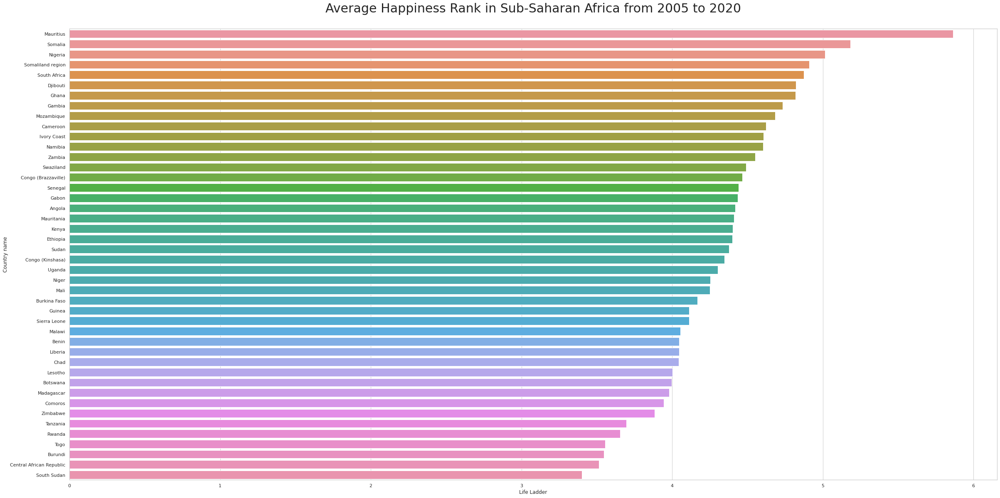

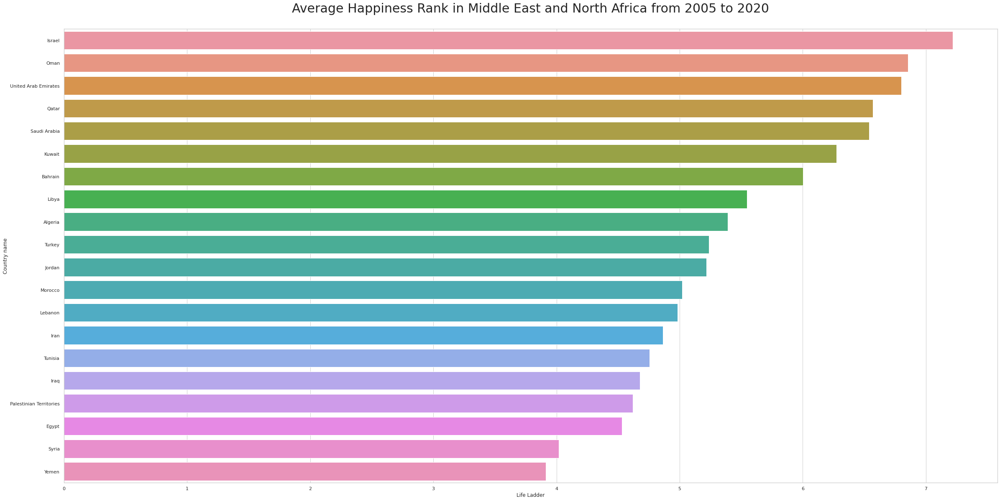

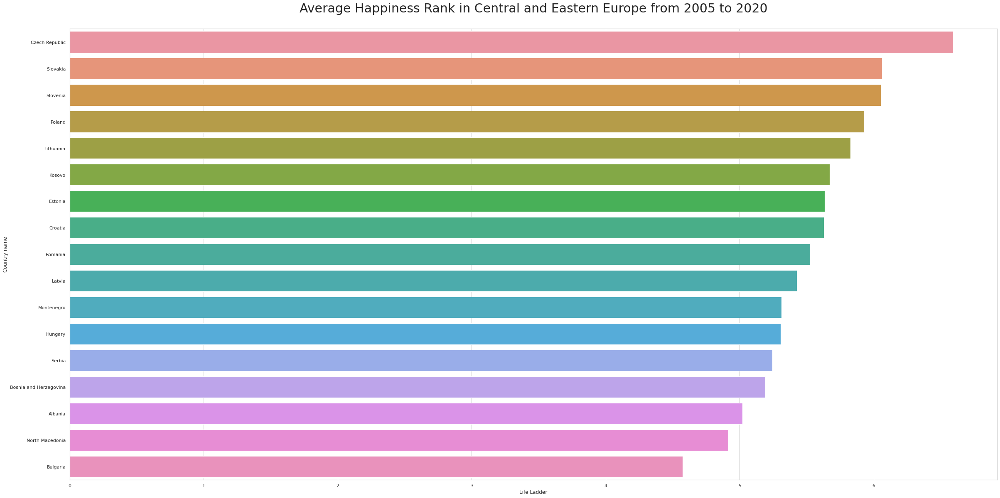

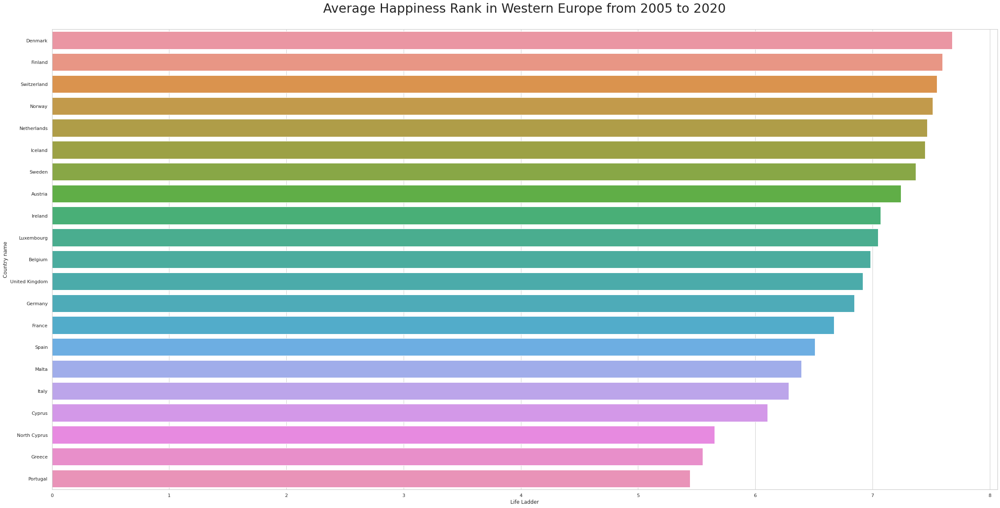

<Figure size 2880x1440 with 0 Axes>

In [31]:
df_happiness_rank_continent_country = df2.groupby(["Regional indicator","Country name"])["Life Ladder"].mean().sort_values(ascending=False)

for continent in continents:
    df_happiness_rank_continent_country_mem = df_happiness_rank_continent_country.iloc[df_happiness_rank_continent_country.index.get_level_values('Regional indicator') == continent]
    df_happiness_rank_continent_country_mem = pd.DataFrame({'Country name':[value[1] for value in df_happiness_rank_continent_country_mem.index], 
                                                        'Life Ladder':df_happiness_rank_continent_country_mem.values})

    sns.set_theme(style="whitegrid")
    plt.title("Average Happiness Rank in " + continent + " from 2005 to 2020\n", fontsize=30)
    sns.barplot(x="Life Ladder", y="Country name", data=df_happiness_rank_continent_country_mem)
    plt.figure()

##### World Map

In [32]:
fig = px.choropleth(df2, locations="Country code",
                    color="Life Ladder", 
                    hover_name="Country name",
                    color_continuous_scale=px.colors.sequential.Plasma)

fig.show()

Averagely, from 2005 to 2020, the happiest countries seem to be in **Europe** and **North America and ANZ** while the less happier countries seem to be in **Sub-Saharan Africa** and **South Asia**. But this is not so meaningful, we can observe in some regions that some countries are outlier, some countries are more happy than the others countries from the region as **Pakistan**, **Maldives** and **Bhutan** in **South Asia**, **Taiwan Province of China** in **East Asia**, **Costa Rica** in **Latin America and Caribbean** and **Kazakhstan** and **Uzbekistan** in **Southeast Asia**.

#### Time

Let us see now the happiness score over time, if countries get happier or sadder over the years, note that the results above are an average over the past 15 years, the happiness may vary over the time, so it could be not so meaningful as we see, not only some countries happiness score can be low and other higher in the same region, but also in time, the happiness score could be high or low at the beginning and respectively get lower or higher over the time.

Let's plot the box and violin plot of happiness score for each region and each years to have an overview of how happiness score can vary in region and in time

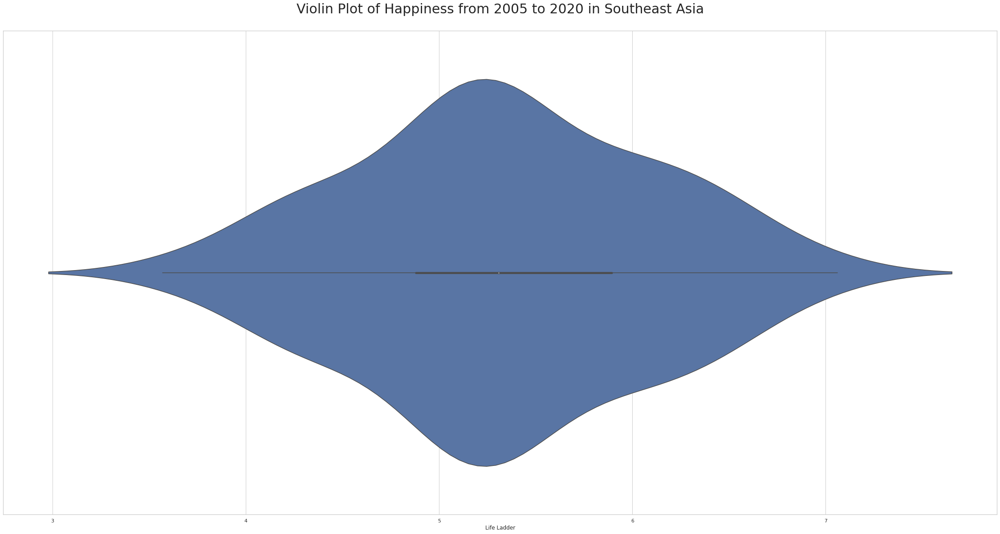

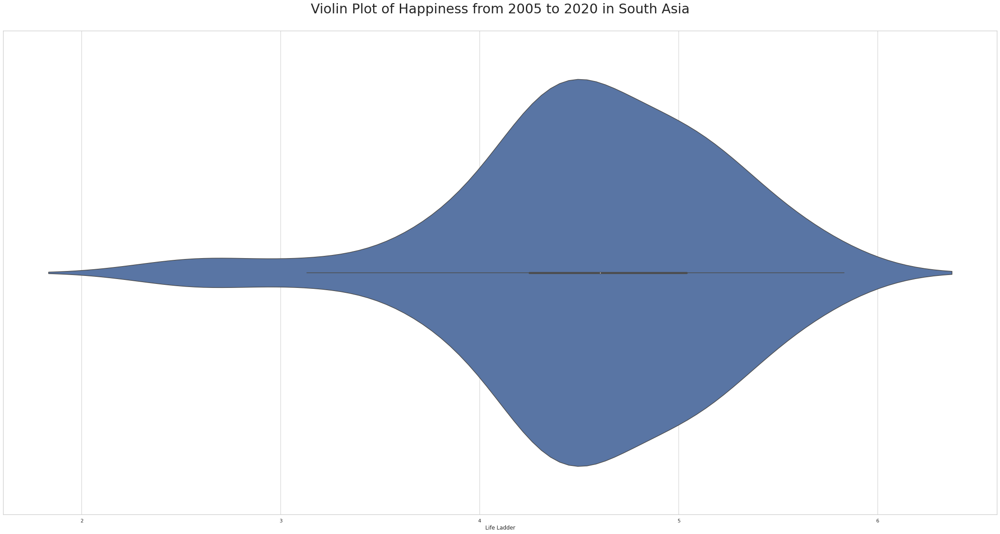

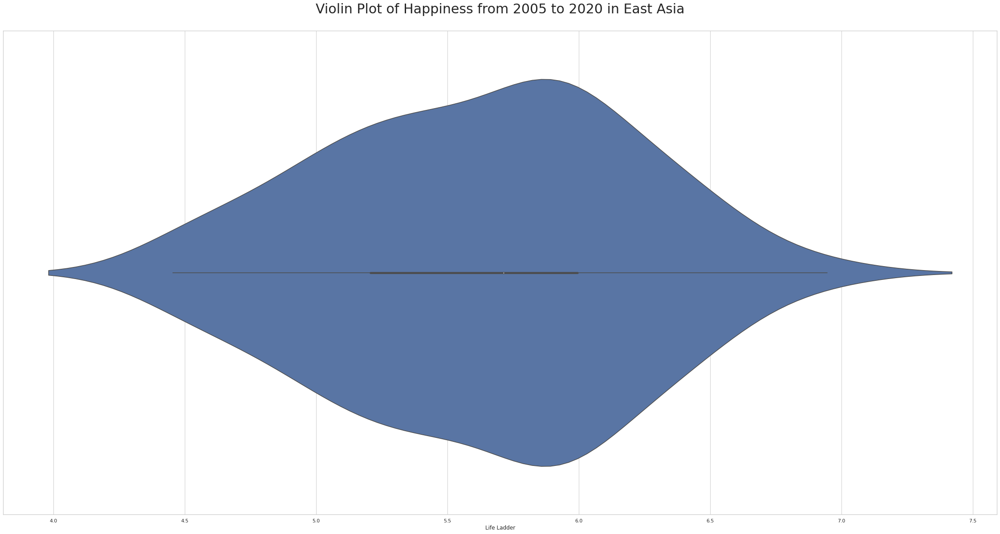

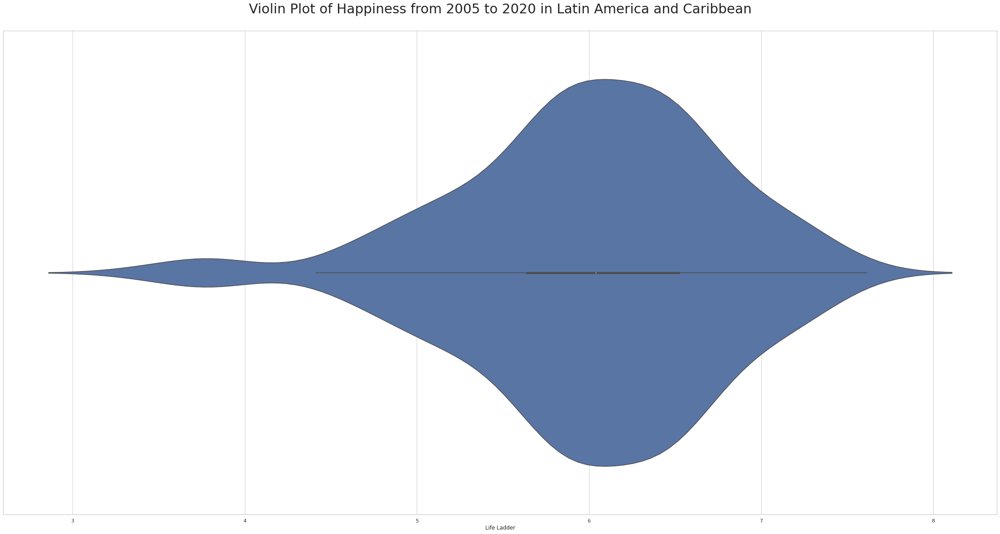

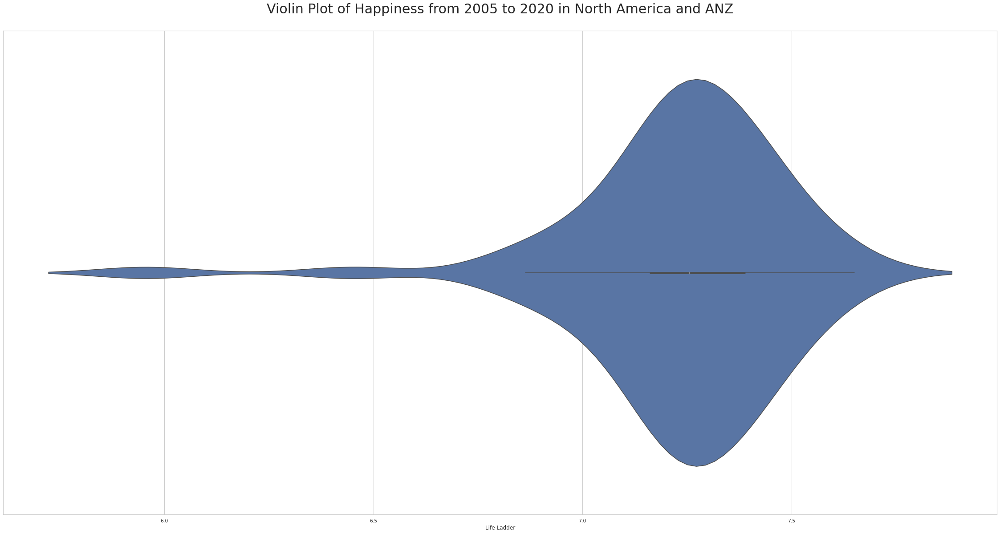

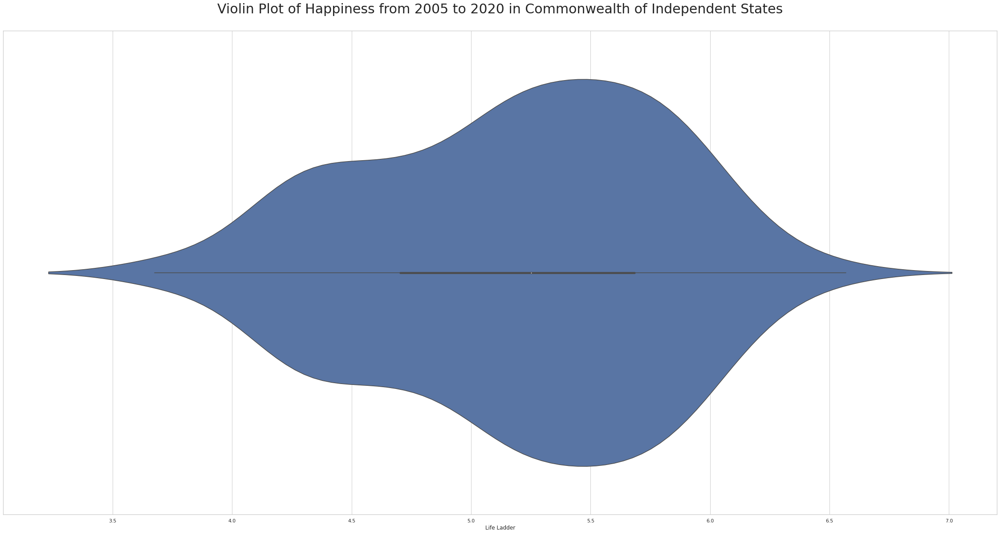

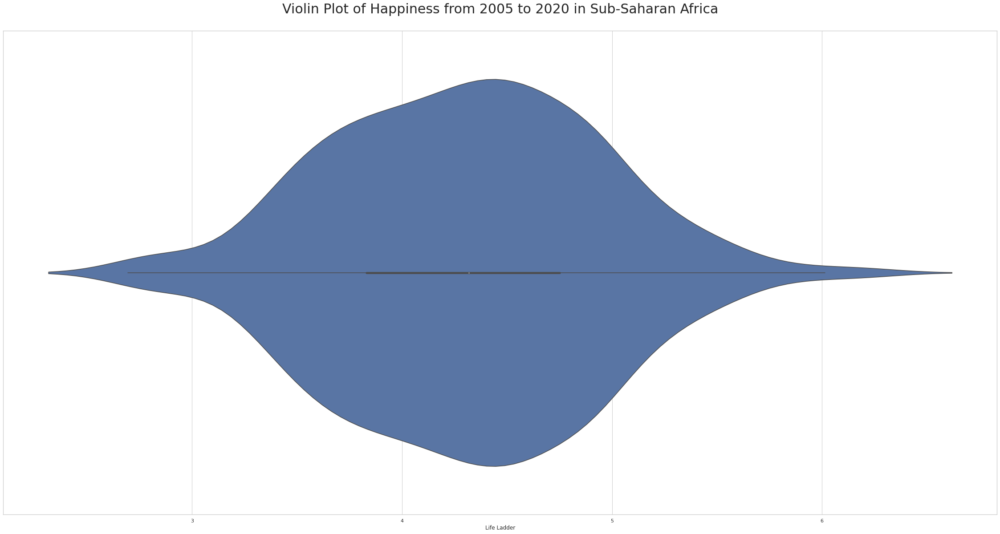

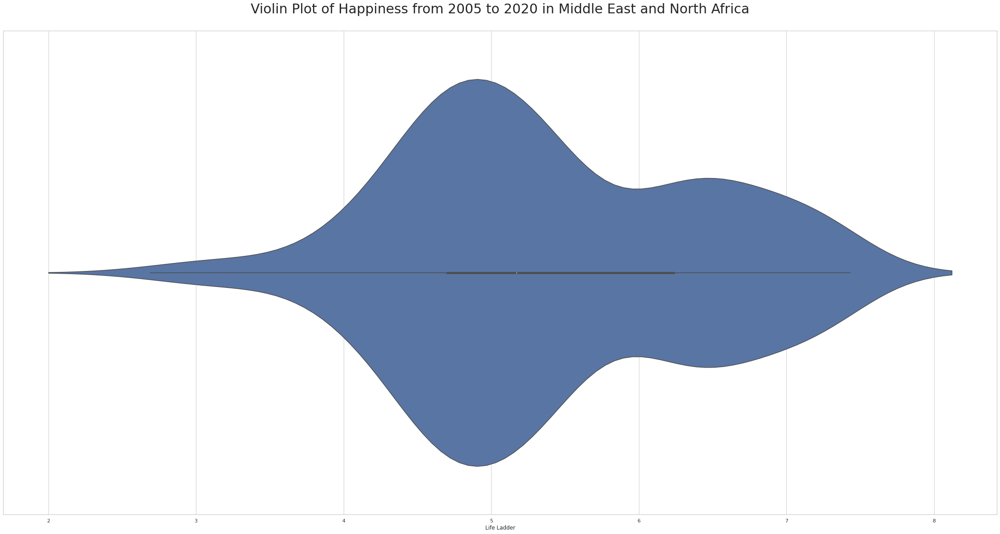

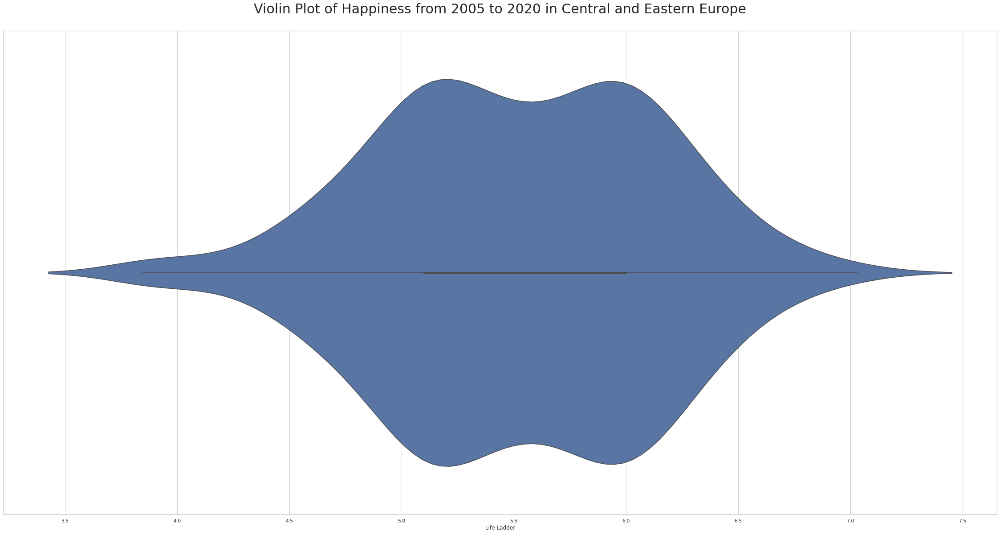

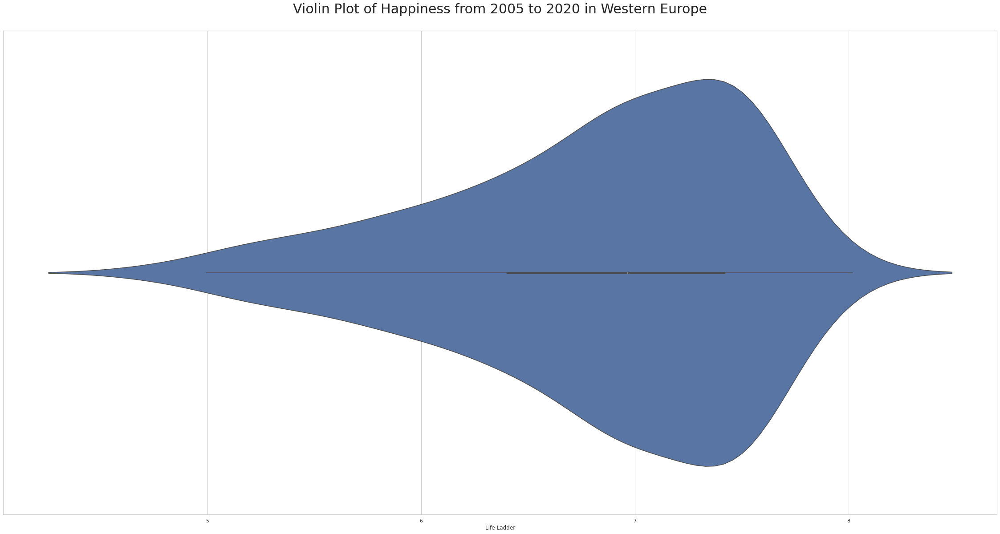

<Figure size 2880x1440 with 0 Axes>

In [47]:
sd = []
mu = []
sd_region = []
for continent in continents:
    df_continent_country = df2[["Country name", "Life Ladder"]][df2["Regional indicator"] == continent]
    sd.append(df_continent_country.describe().loc["std"][0])
    mu.append(df_continent_country.describe().loc["mean"][0])
    sd_region.append(continent)
    plt.title('Violin Plot of Happiness from 2005 to 2020 in ' + continent + "\n", fontsize=30)
    sns.violinplot(data=df_continent_country, x="Life Ladder")
    plt.figure()
    
df_region_sd = pd.DataFrame({"Regional indicator":sd_region,"Mean":mu,"Standard Deviation":sd}).sort_values(by=['Mean','Standard Deviation'], ascending=False)

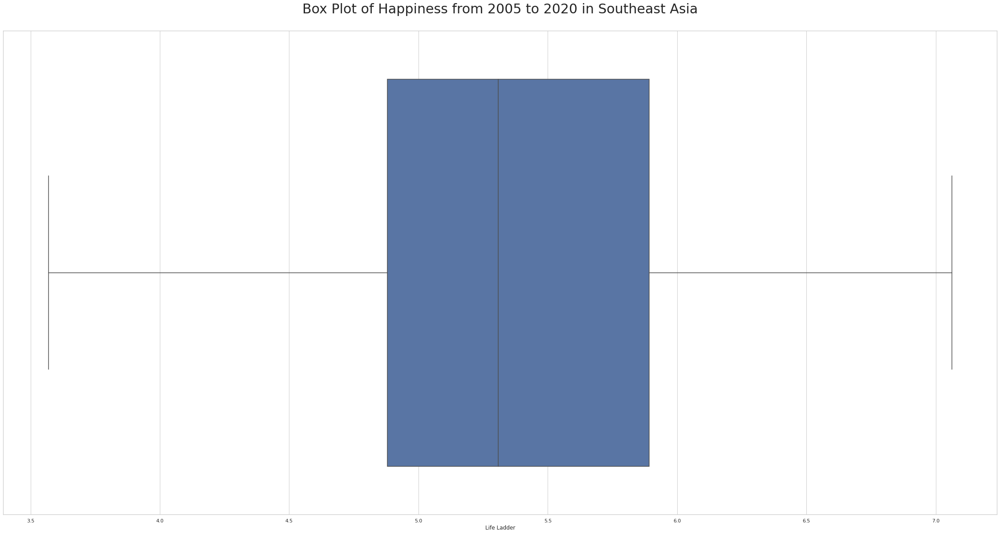

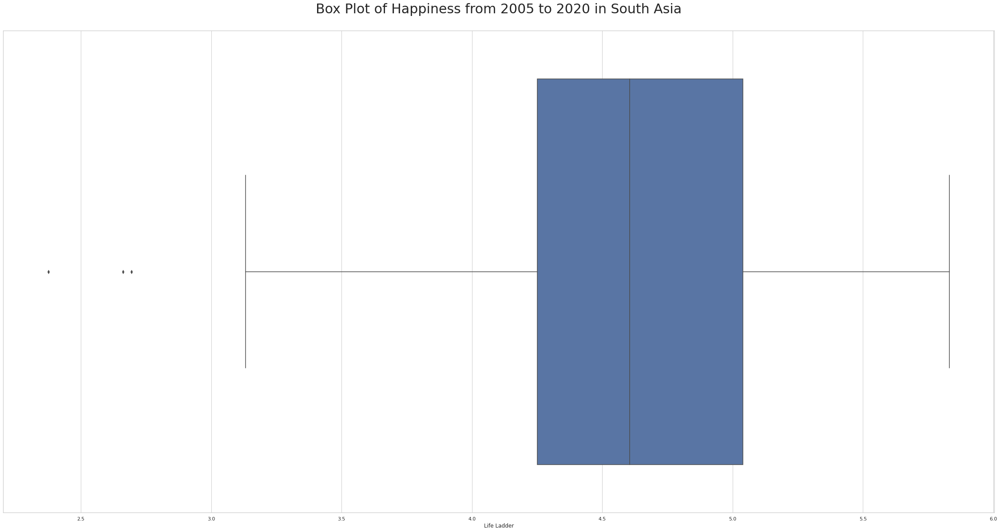

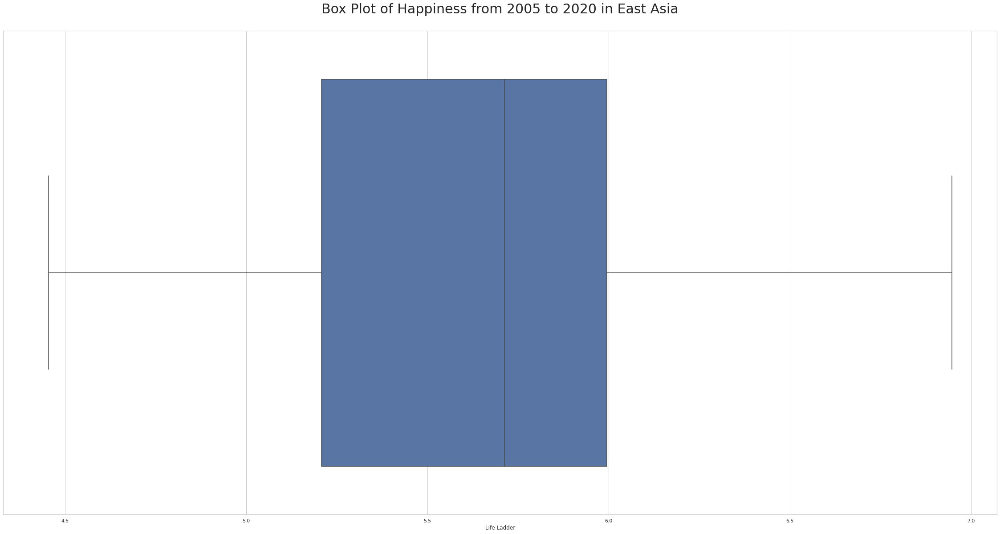

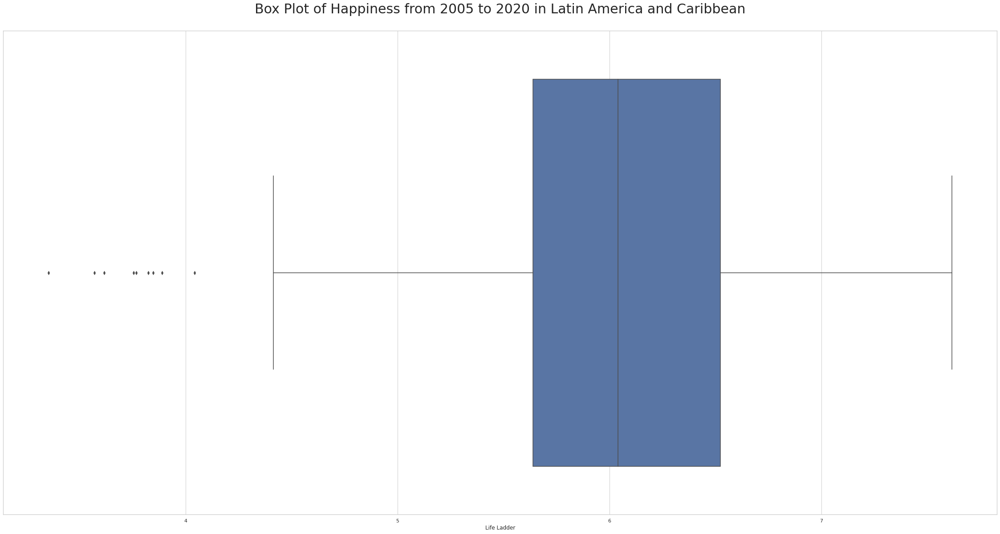

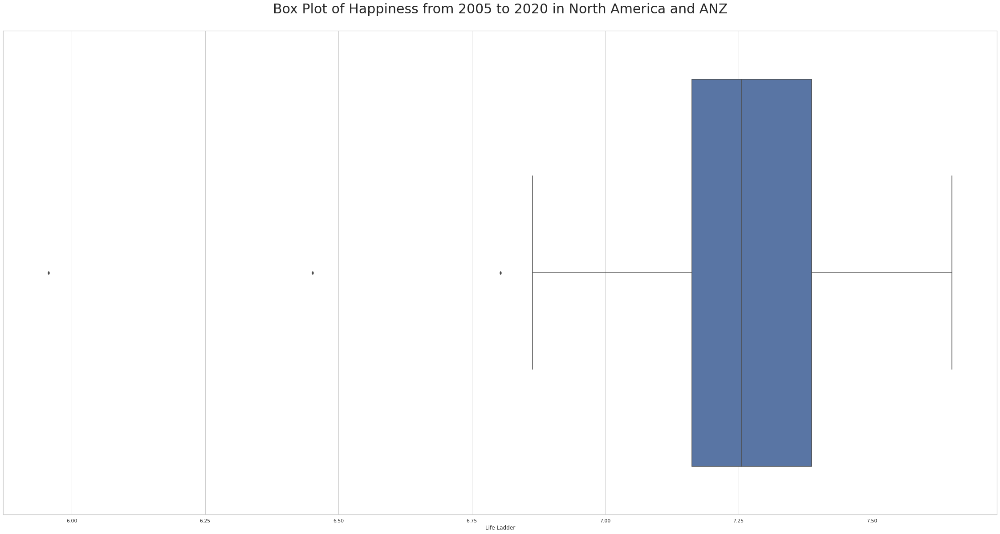

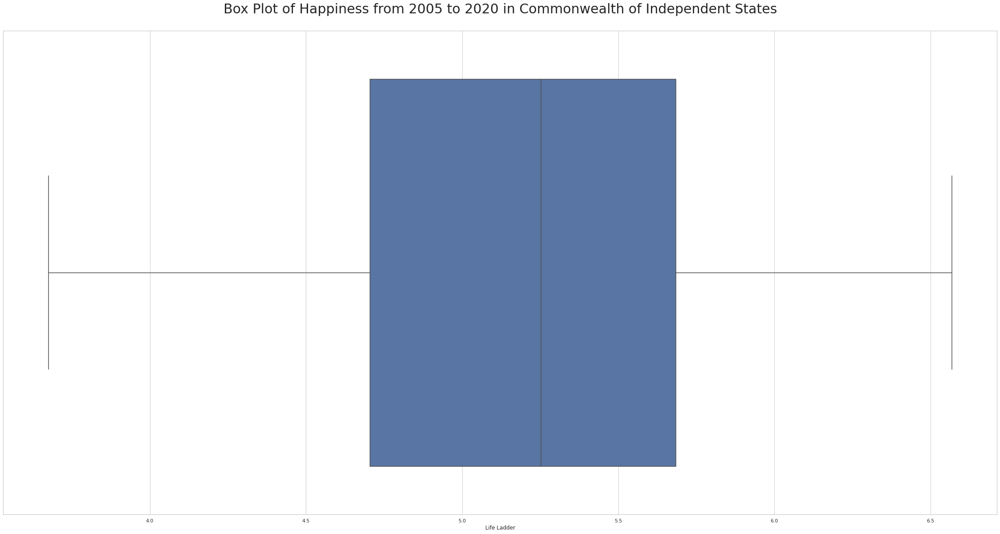

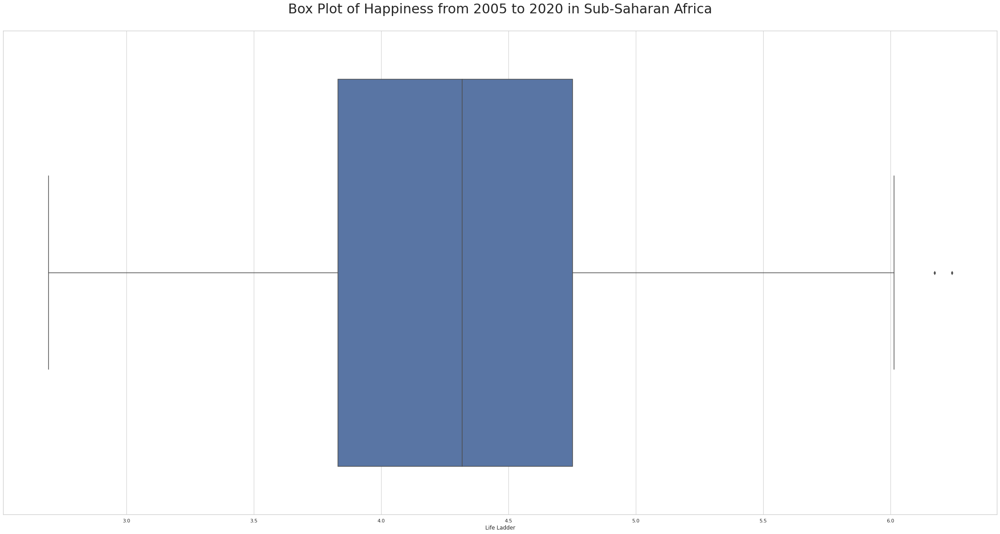

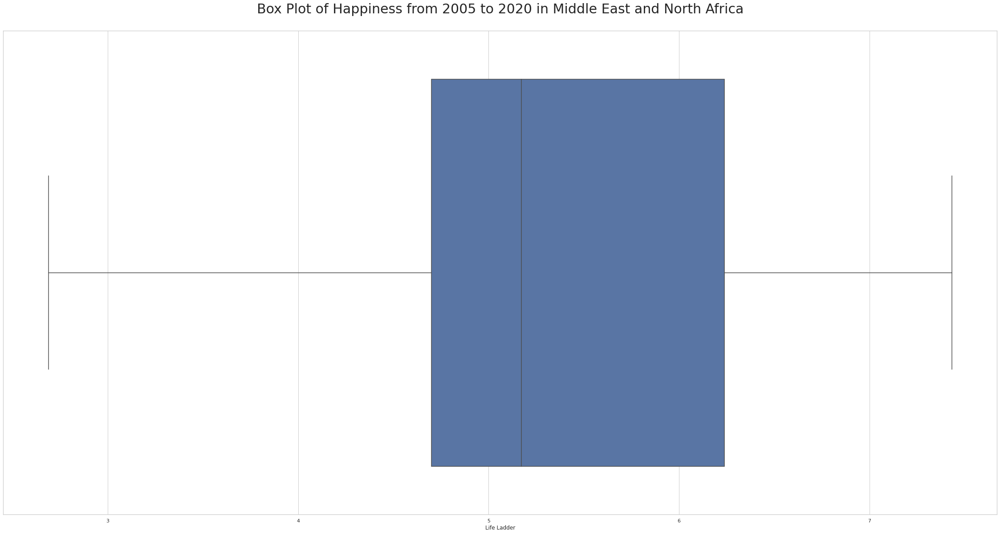

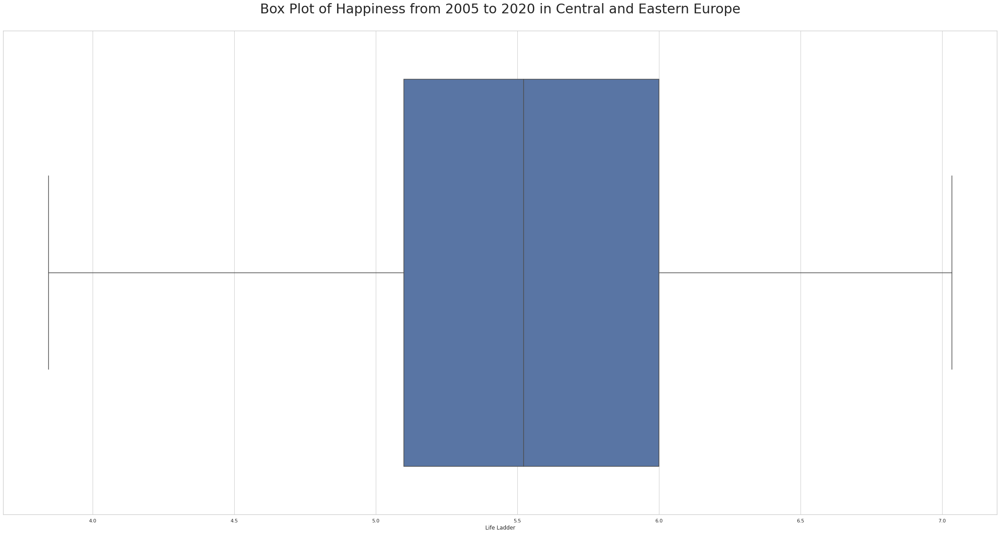

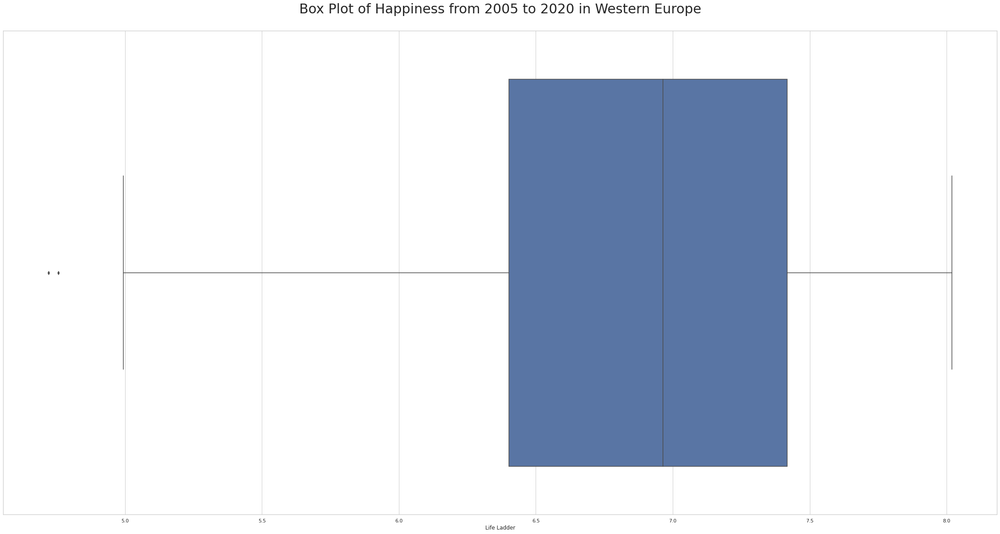

<Figure size 2880x1440 with 0 Axes>

In [43]:
for continent in continents:
    df_continent_country = df2[["Country name", "Life Ladder"]][df2["Regional indicator"] == continent]
    plt.title('Box Plot of Happiness from 2005 to 2020 in ' + continent + "\n", fontsize=30)
    sns.boxplot(data=df_continent_country, x="Life Ladder")
    plt.figure()

##### Student's t-test and Welch's t-test

Here we can see the Mean and the Standard Deviation of all countries' happiness records over the years from 2005 to 2020 for each region

In [48]:
df_region_sd

,Regional indicator,Mean,Standard Deviation
4,North America and ANZ,7.228300,0.264488
9,Western Europe,6.826756,0.709928
3,Latin America and Caribbean,5.997345,0.763827
2,East Asia,5.633451,0.571513
8,Central and Eastern Europe,5.525680,0.617481
7,Middle East and North Africa,5.387237,1.014944
0,Southeast Asia,5.341181,0.764344
5,Commonwealth of Independent States,5.194894,0.619650
1,South Asia,4.567782,0.661706
6,Sub-Saharan Africa,4.303405,0.633965


Let's perform the **Student's t-test** and **Welch's t-test** (since some of our sample to compare have different variance) over the values of happiness score of each region to test if happiness in regions are the same of different

In [69]:
error_percent = 0.05
alpha = 0.05

for i in range(len(list_continents)-1):
    for j in range(i+1,len(list_continents)):
        var_1 = list(df_region_sd["Standard Deviation"][df_region_sd["Regional indicator"] == list_continents[i]])[0]**2
        var_2 = list(df_region_sd["Standard Deviation"][df_region_sd["Regional indicator"] == list_continents[j]])[0]**2
        a = list(df2["Life Ladder"][df2["Regional indicator"] == list_continents[i]])
        b = list(df2["Life Ladder"][df2["Regional indicator"] == list_continents[j]])
        if ((var_1 * (1-error_percent)) <= var_2 <= ((var_1 * (1-error_percent)))) or ((var_2 * (1-error_percent)) <= var_1 <= ((var_2 * (1-error_percent)))):
            #if variance is the same
            _, p_value = ttest_ind(a, b, equal_var = True)
        else:
            #if variance is not the same
            _, p_value = ttest_ind(a, b, equal_var = False)
        
        if p_value <= alpha:
            print("Reject that " + list_continents[i] + " and " + list_continents[j] + " have the same expected value.")
        else:
            print("We don't reject that " + list_continents[i] + " and " + list_continents[j] + " have the same expected value.")

Reject that Southeast Asia and South Asia have the same expected value.
Reject that Southeast Asia and East Asia have the same expected value.
Reject that Southeast Asia and Latin America and Caribbean have the same expected value.
Reject that Southeast Asia and North America and ANZ have the same expected value.
We don't reject that Southeast Asia and Commonwealth of Independent States have the same expected value.
Reject that Southeast Asia and Sub-Saharan Africa have the same expected value.
We don't reject that Southeast Asia and Middle East and North Africa have the same expected value.
Reject that Southeast Asia and Central and Eastern Europe have the same expected value.
Reject that Southeast Asia and Western Europe have the same expected value.
Reject that South Asia and East Asia have the same expected value.
Reject that South Asia and Latin America and Caribbean have the same expected value.
Reject that South Asia and North America and ANZ have the same expected value.
Reject

Here we can interpret that the following region have binary the same expected values:

- **Middle East and North Africa** and **Central and Eastern Europe**
- **East Asia** and **Central and Eastern Europe**
- **Southeast Asia** and **Middle East and North Africa**
- **Southeast Asia** and **Commonwealth of Independent States**

We can observe those results on the above box plot of [Region](#Region)

##### Time - Region

As we can see regions contains outliers (country that are happier or sadder than the group), and we can also oberve an high variance, let us see now the happiness score in details over the years and the regions and countries

<Figure size 2880x1440 with 0 Axes>

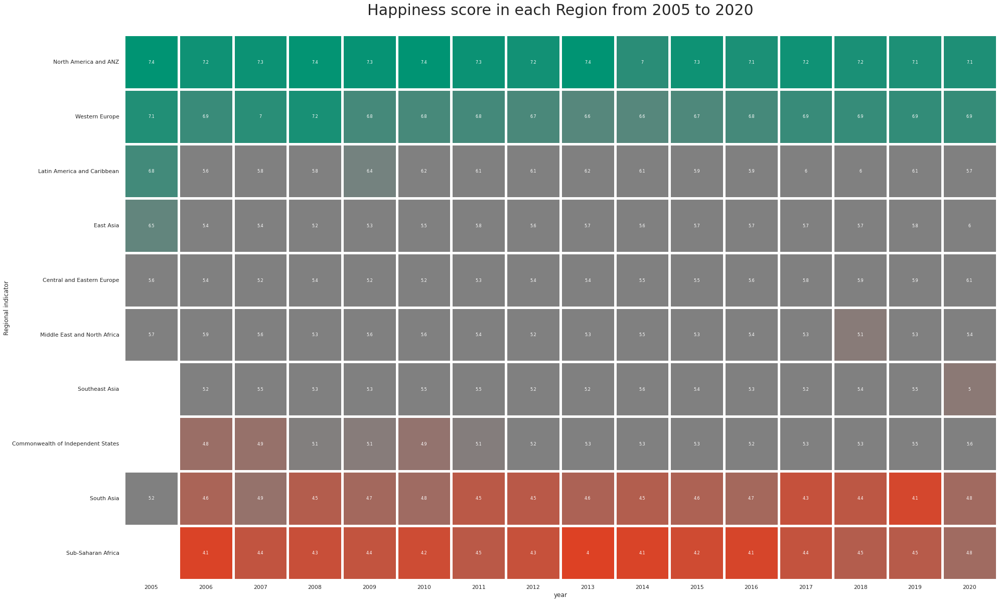

<Figure size 2880x1440 with 0 Axes>

In [1538]:
df_continent_year_mean_pivot = df_continent_year_mean.pivot("Regional indicator", "year", "Life Ladder")
new_index = df_continent_year_mean_pivot.mean(axis=1).sort_values(ascending=False).index
df_continent_year_mean_pivot = df_continent_year_mean_pivot.reindex(new_index)

plt.title("Happiness score in each Region from 2005 to 2020\n", fontsize=30)
sns.heatmap(df_continent_year_mean_pivot,
            square=True,
            linewidth=5,
            cmap=cmap,
            cbar=False,
            annot=True,
            annot_kws={"size": 8})
plt.figure()

<Figure size 2880x1440 with 0 Axes>

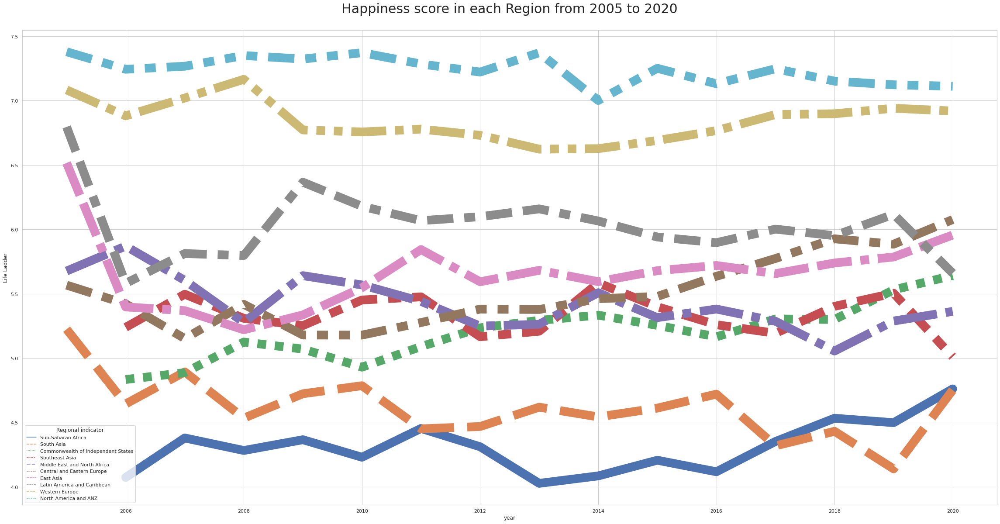

<Figure size 2880x1440 with 0 Axes>

In [1539]:
plt.title("Happiness score in each Region from 2005 to 2020\n", fontsize=30)
sns.lineplot(data=df_continent_year_mean, 
             x="year", 
             y="Life Ladder", 
             hue="Regional indicator", 
             style="Regional indicator",
             linewidth=20,
            legend="auto")
plt.figure()

We can observe slight variation in time for some region which may be due to some political, economical... events happened in some countries of the concerned region (or even the full region). But we don't see any huge variation where a region has definitvely became happy or unhappy.

##### Time - Country

Let us see now observe the variation of happiness on country level

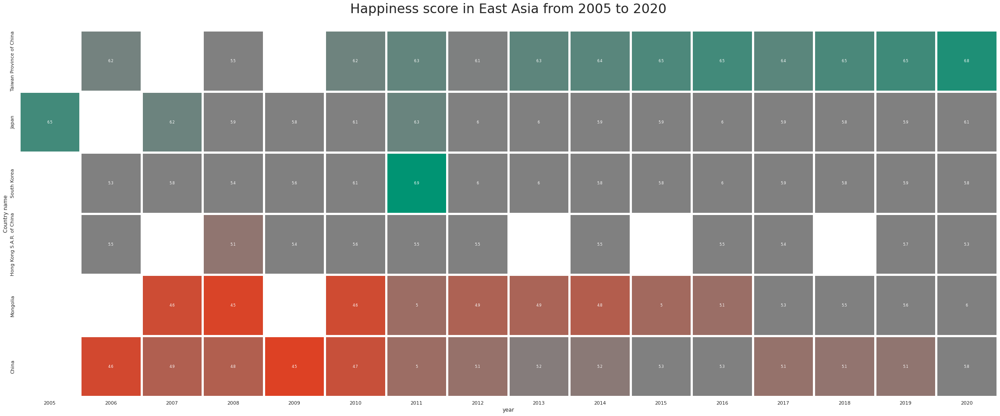

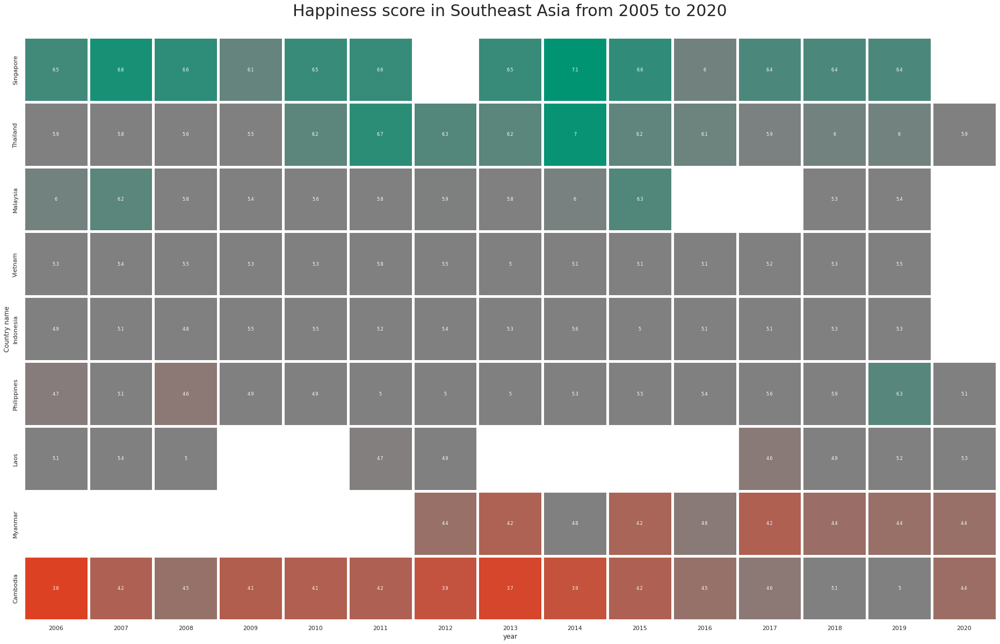

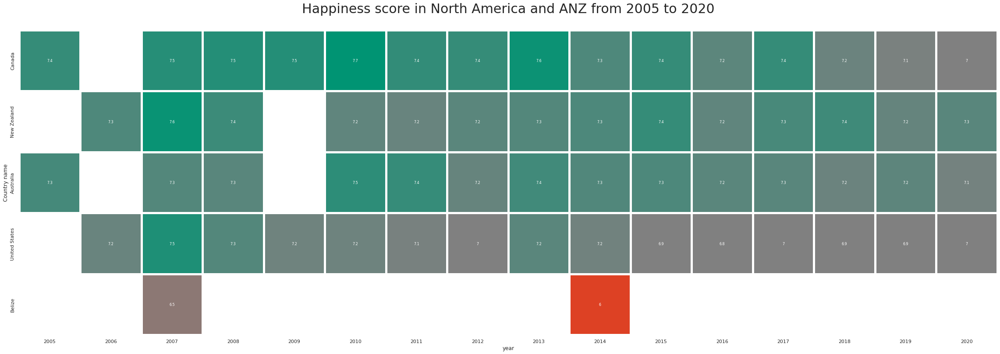

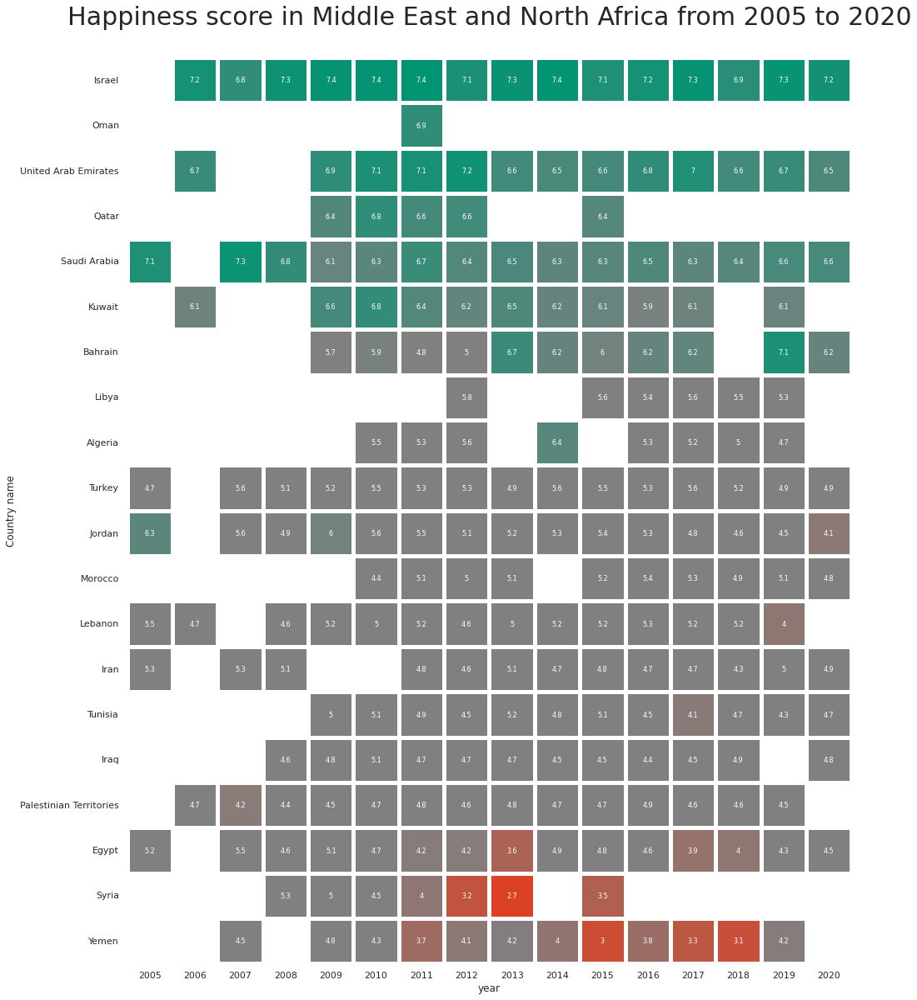

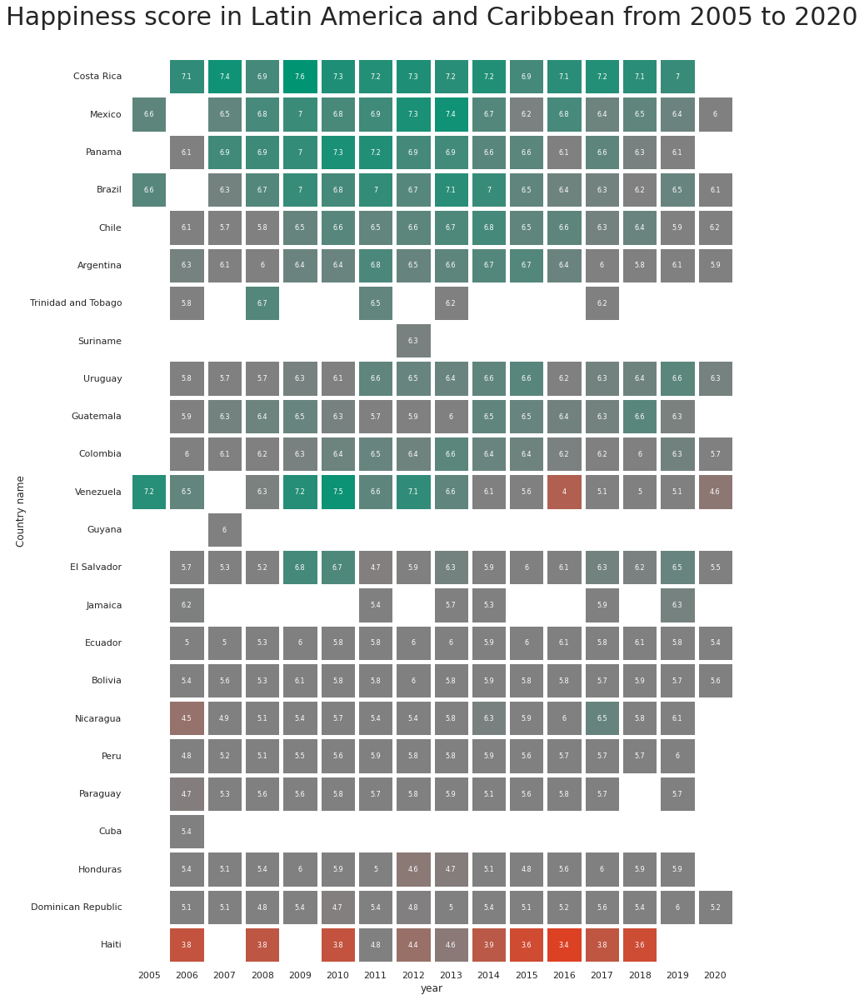

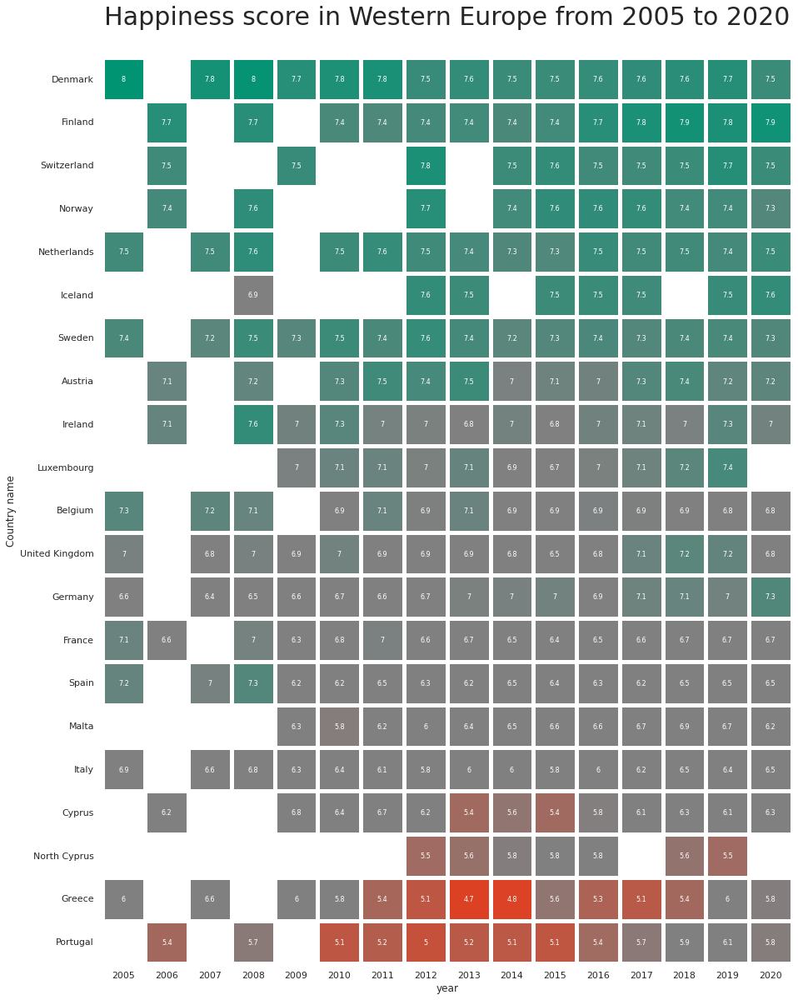

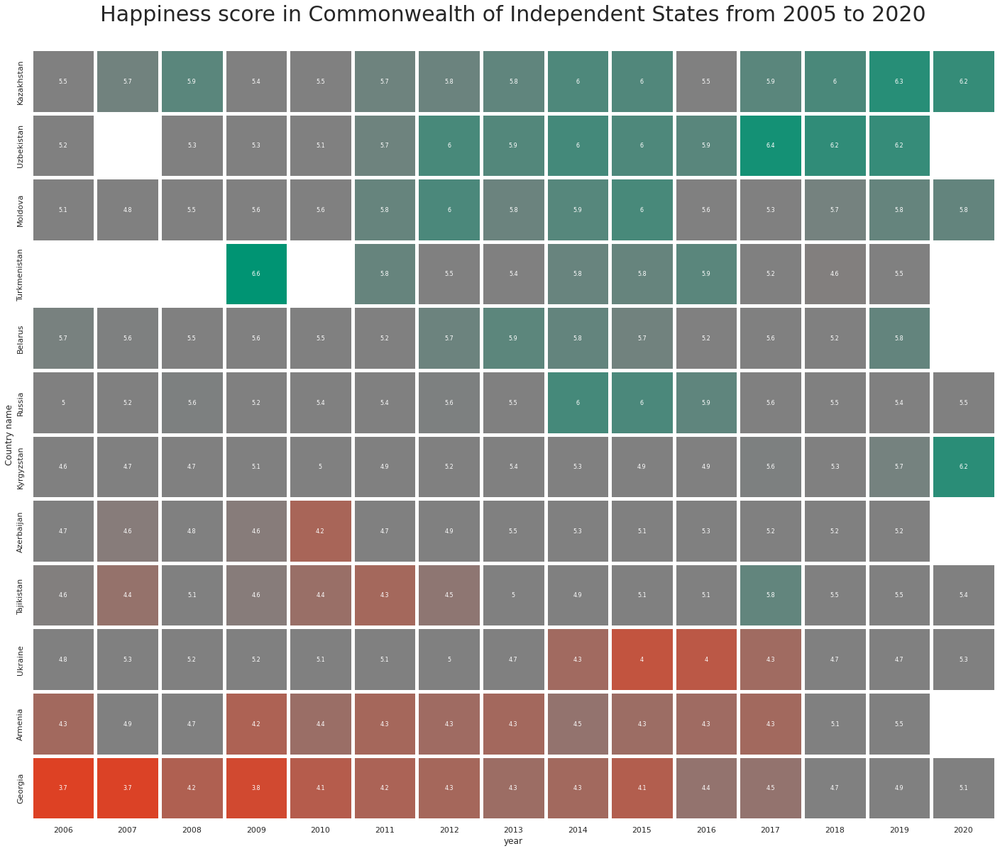

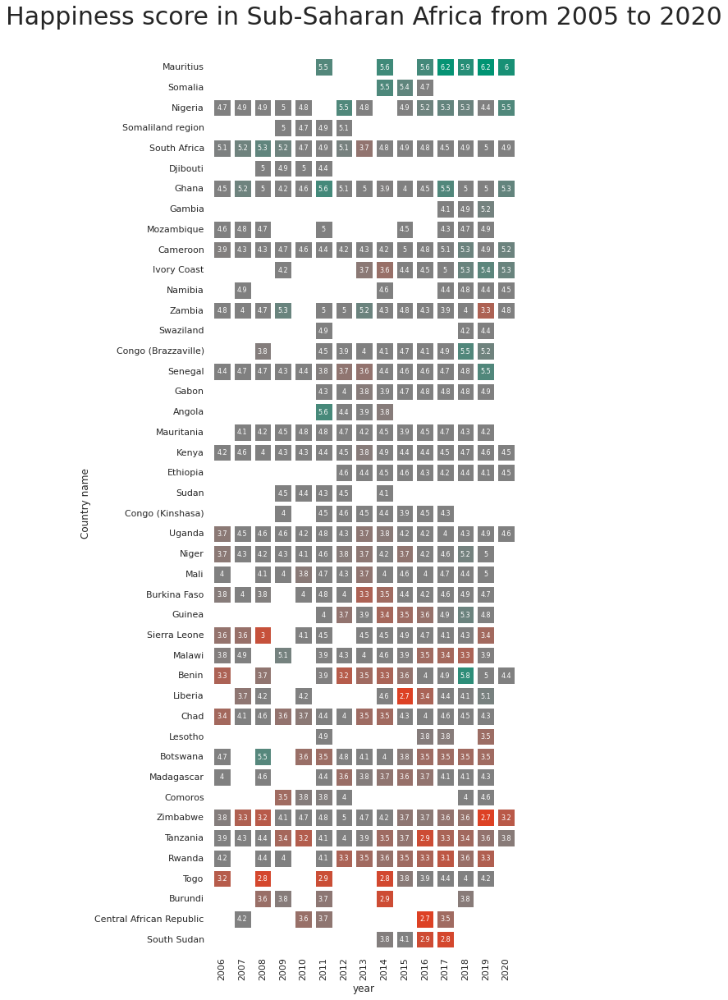

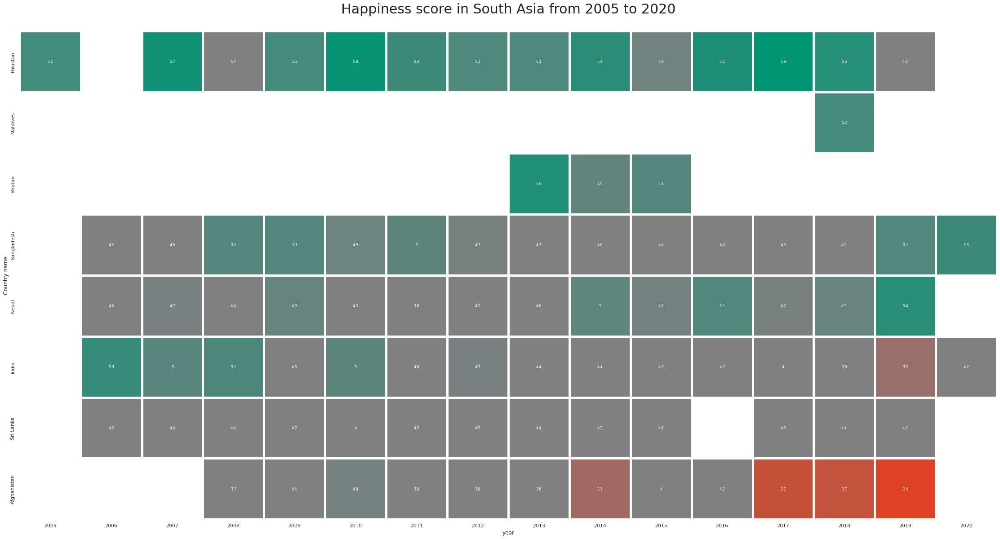

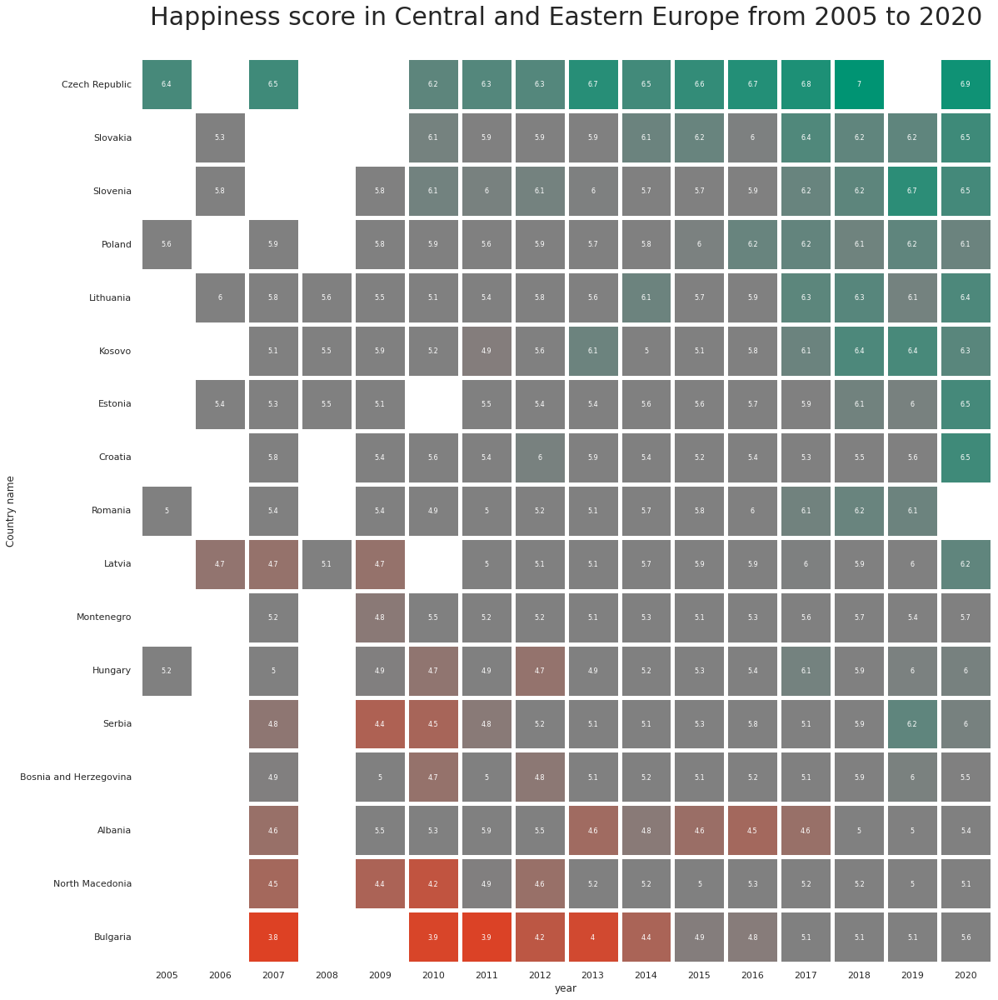

<Figure size 2880x1440 with 0 Axes>

In [1540]:
for continent in continents:
    df_continent_country_year = df2[["Country name", "year", "Life Ladder"]][df2["Regional indicator"] == continent]
    
    df_continent_country_year = df_continent_country_year.pivot("Country name", "year", "Life Ladder")
    new_index = df_continent_country_year.mean(axis=1).sort_values(ascending=False).index
    df_continent_country_year = df_continent_country_year.reindex(new_index)
    
    plt.title("Happiness score in " + continent + " from 2005 to 2020\n", fontsize=30)
    sns.heatmap(df_continent_country_year,
                square=True,
                linewidth=5,
                cmap=cmap,
                cbar=False,
                annot=True,
                annot_kws={"size": 8})
    plt.figure()

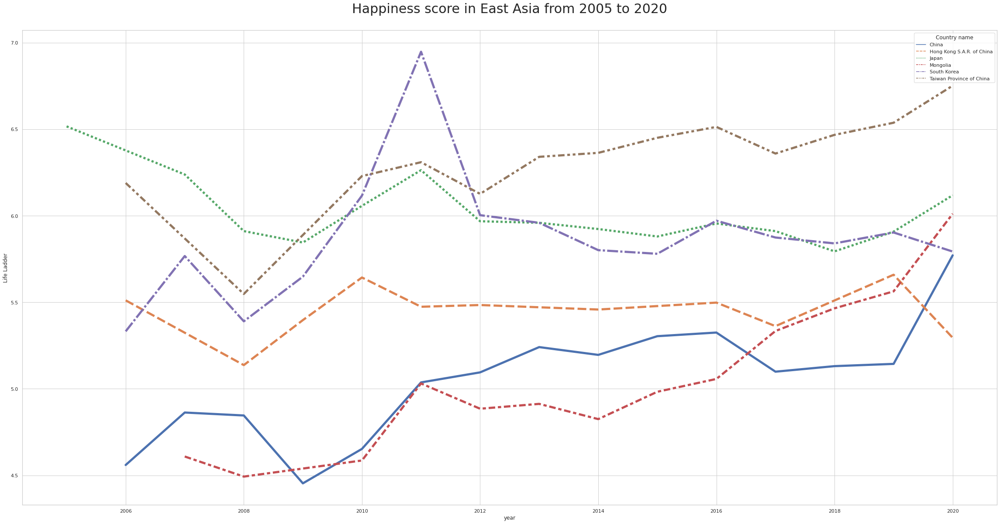

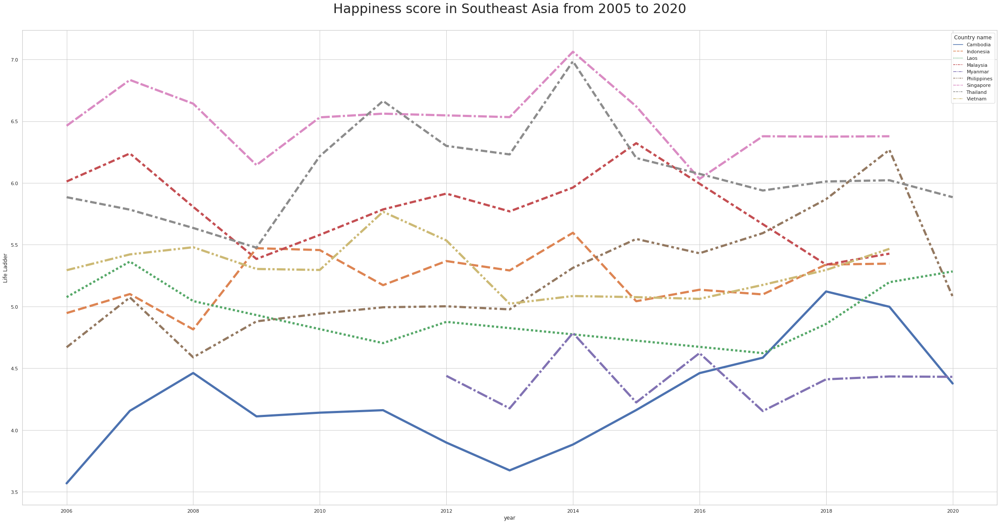

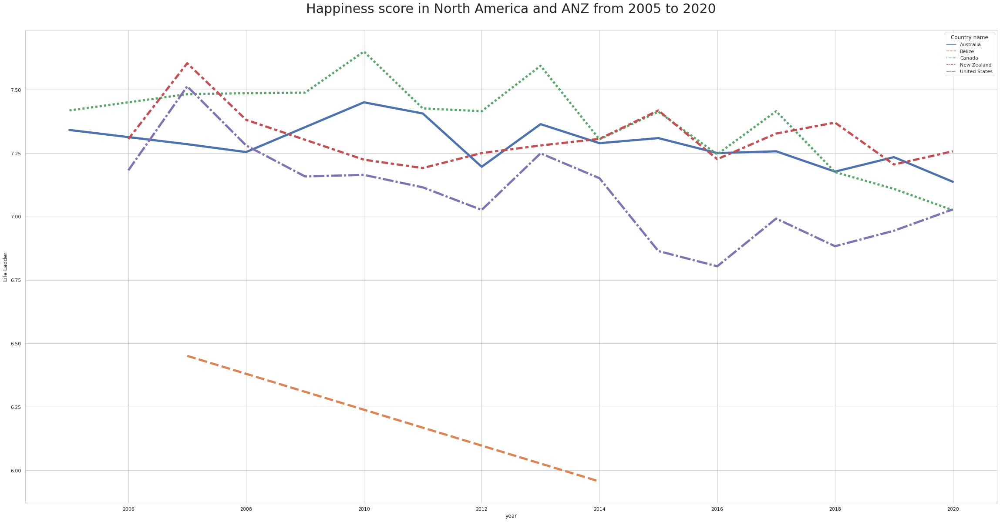

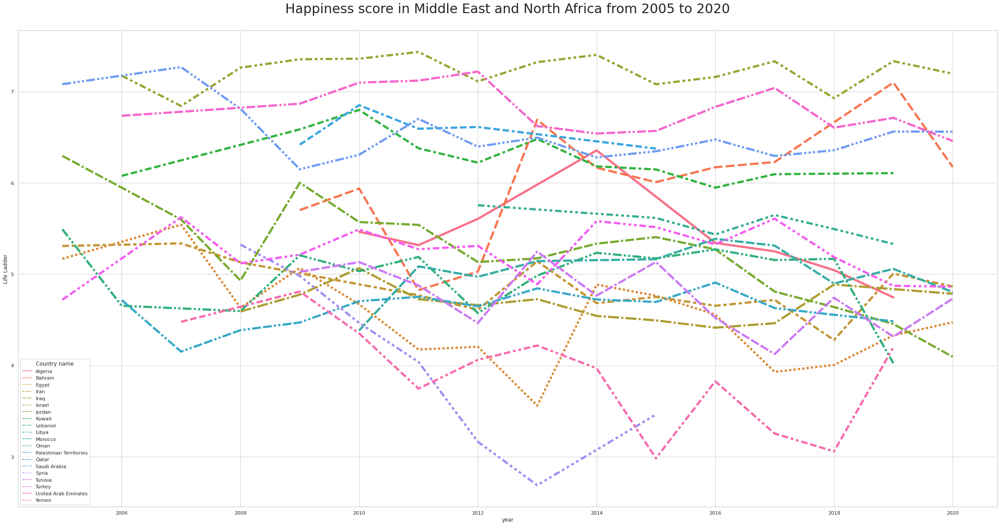

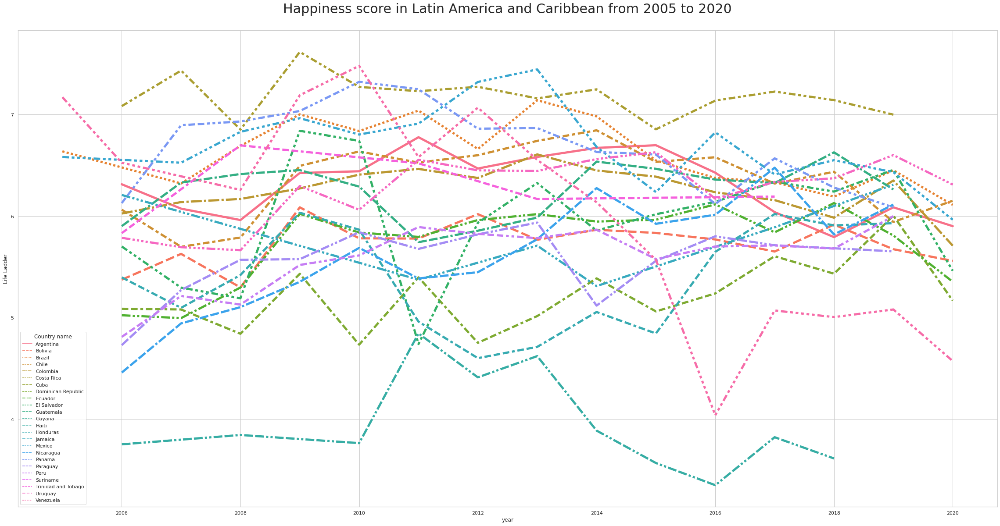

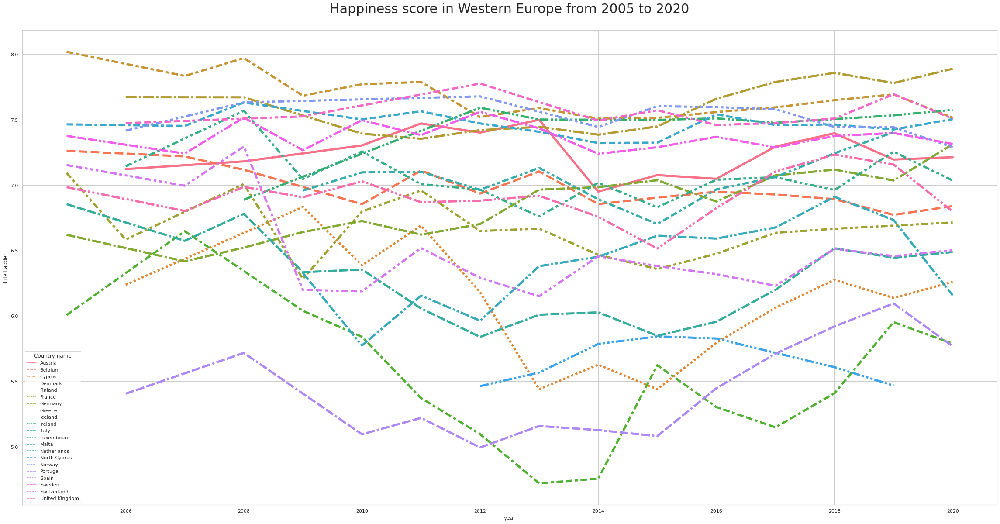

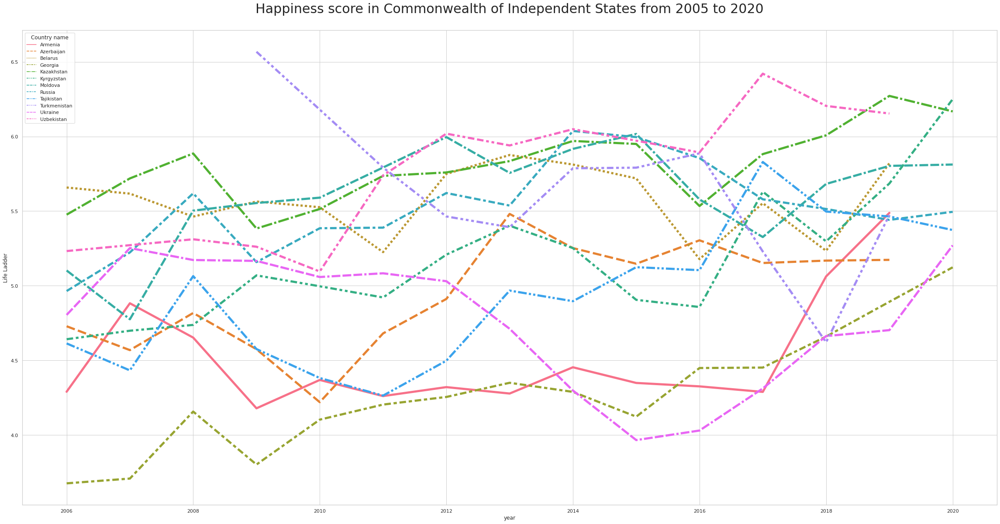

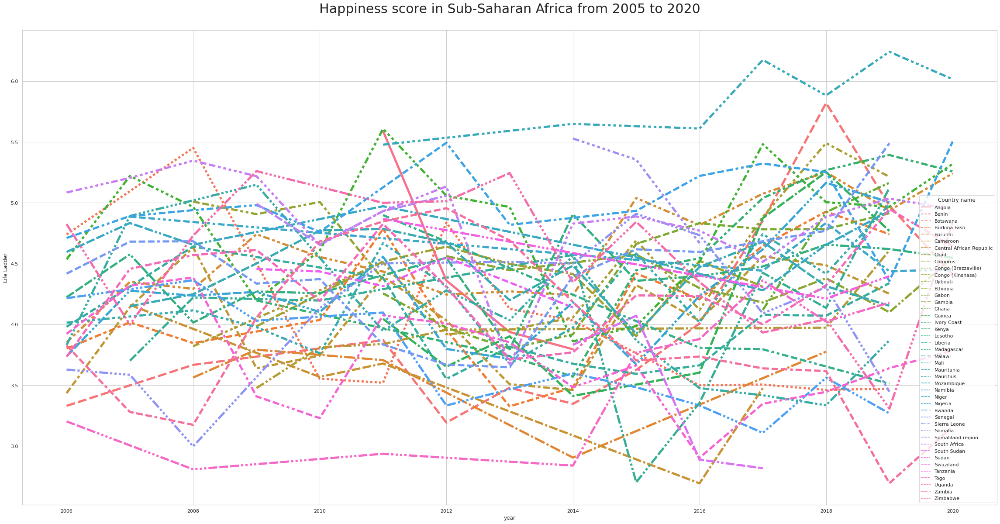

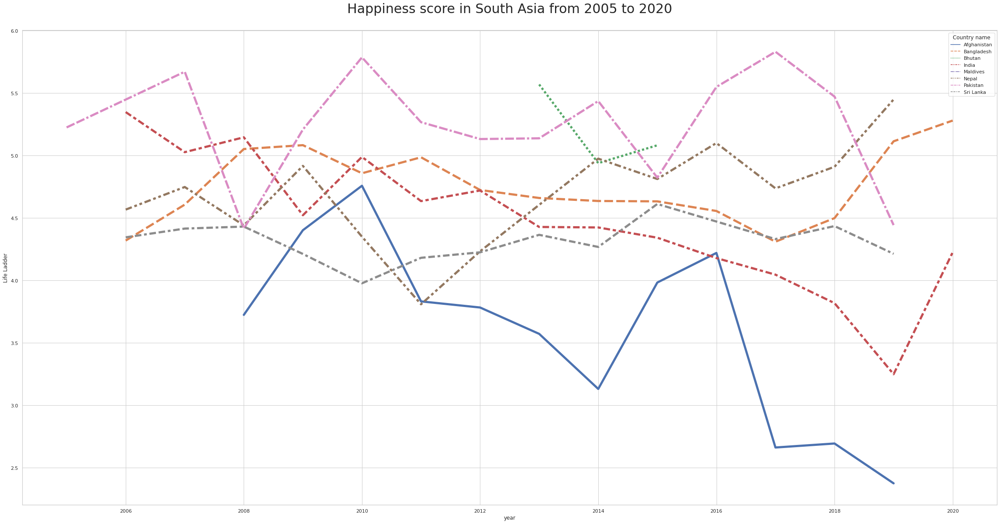

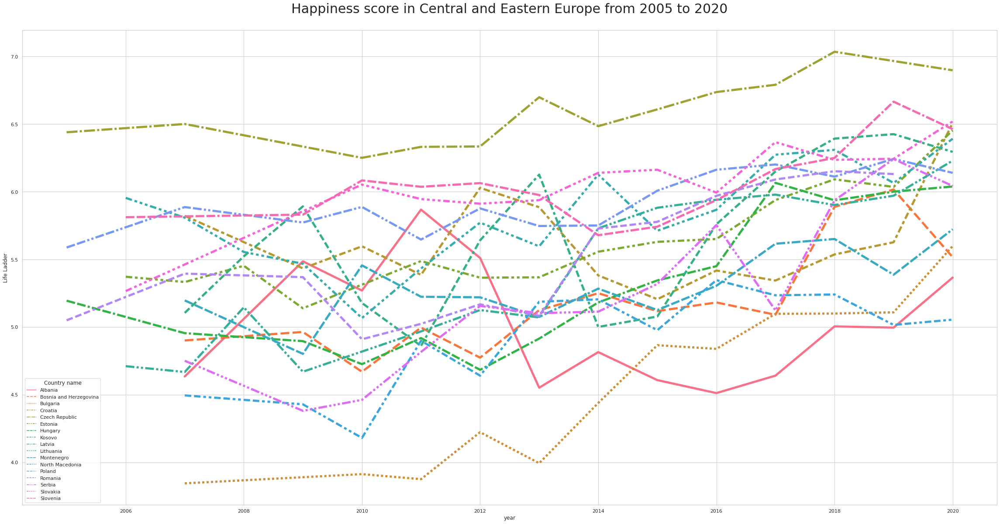

<Figure size 2880x1440 with 0 Axes>

In [1541]:
for continent in continents:
    df_continent_country_year = df2[["Country name", "year", "Life Ladder"]][df2["Regional indicator"] == continent]
    plt.title("Happiness score in " + continent + " from 2005 to 2020\n", fontsize=30)
    sns.lineplot(data=df_continent_country_year, 
                 x="year", 
                 y="Life Ladder", 
                 hue="Country name", 
                 style="Country name",
                 linewidth=5,
                legend="auto")
    plt.figure()

##### Variation of Happiness through the time

We can observe that some countries are getting happier and other countries getting sadder, let's plot the variation of happiness from 2005 to 2020

<Figure size 2880x1440 with 0 Axes>

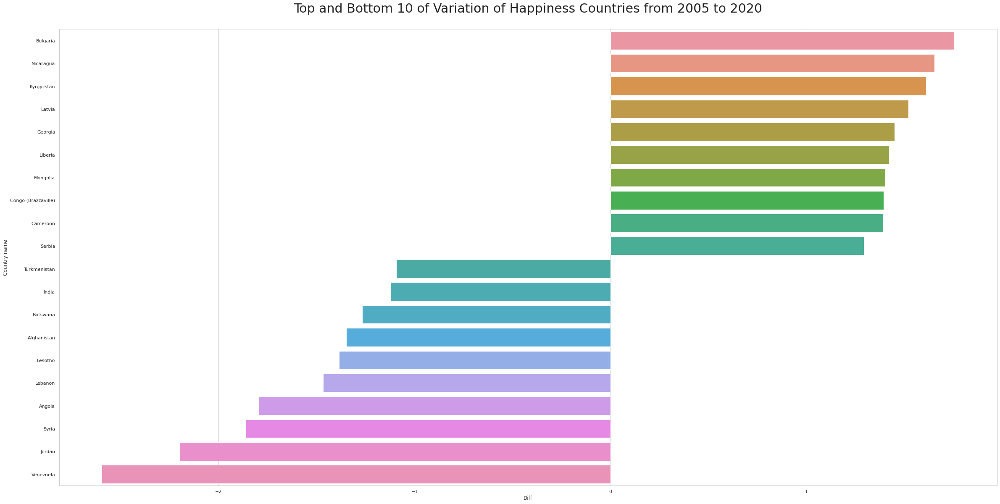

<Figure size 2880x1440 with 0 Axes>

In [1542]:
df2_sub = df2[["Country name","Regional indicator","year","Life Ladder"]].sort_values(by=["Country name","year"],ascending=True)
list_variation = []

for country in countries:
    continent = list(set(df2_sub["Regional indicator"][df2_sub["Country name"] == country]))[0]
    df_diff = df2_sub[["Life Ladder","year"]][a["Country name"] == country]
    diff_life_ladder = list(df_diff["Life Ladder"])[-1] - list(df_diff["Life Ladder"])[0]
    x_year = [list(df_diff["year"])[0], list(df_diff["year"])[-1]]
    y_life_ladder = [list(df_diff["Life Ladder"])[0], list(df_diff["Life Ladder"])[-1]]
    list_variation.append([country, continent, diff_life_ladder, x_year, y_life_ladder])

df_diff = pd.DataFrame({"Country name":[value[0] for value in list_variation],
                        "Regional indicator":[value[1] for value in list_variation],
                        "Diff":[value[2] for value in list_variation],
                        "Abs Diff":[abs(value[2]) for value in list_variation],
                        "First year":[value[3][0] for value in list_variation],
                        "Last year":[value[3][1] for value in list_variation],
                        "Min value":[value[4][0] for value in list_variation],
                        "Max value":[value[4][1] for value in list_variation]})

df_diff = df_diff.sort_values(by=["Diff"],ascending=False)

top_param_var = 10

df_diff_top = df_diff[:top_param_var]
df_diff_bottom = df_diff.sort_values(by=["Diff"],ascending=True)[:top_param_var].sort_values(by=["Diff"],ascending=False)

df_diff_top_bottom = df_diff_top.append(df_diff_bottom)

sns.set_theme(style="whitegrid")
plt.title("Top and Bottom " + str(top_param) + " of Variation of Happiness Countries from 2005 to 2020\n", fontsize=30)
sns.barplot(x="Diff", y="Country name", data=df_diff_top_bottom)
plt.figure()

<Figure size 2880x1440 with 0 Axes>

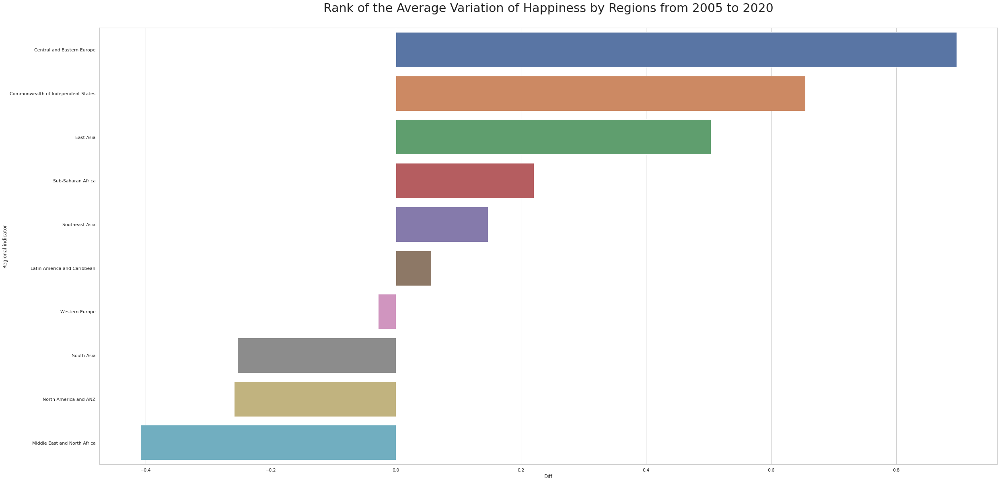

<Figure size 2880x1440 with 0 Axes>

In [1543]:
df_diff_continent_mean = df_diff.groupby(["Regional indicator"]).mean().sort_values(by="Diff", ascending=False)
df_diff_continent_mean = pd.DataFrame({"Regional indicator":df_diff_continent_mean.index, 'Diff':list(df_diff_continent_mean['Diff'])})

sns.set_theme(style="whitegrid")
plt.title("Rank of the Average Variation of Happiness by Regions from 2005 to 2020\n", fontsize=30)
sns.barplot(x="Diff", y="Regional indicator", data=df_diff_continent_mean)
plt.figure()

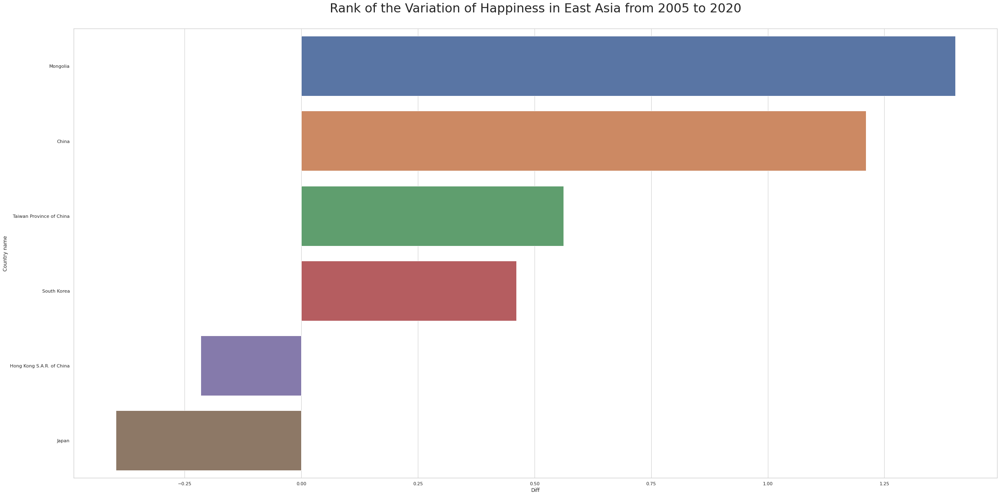

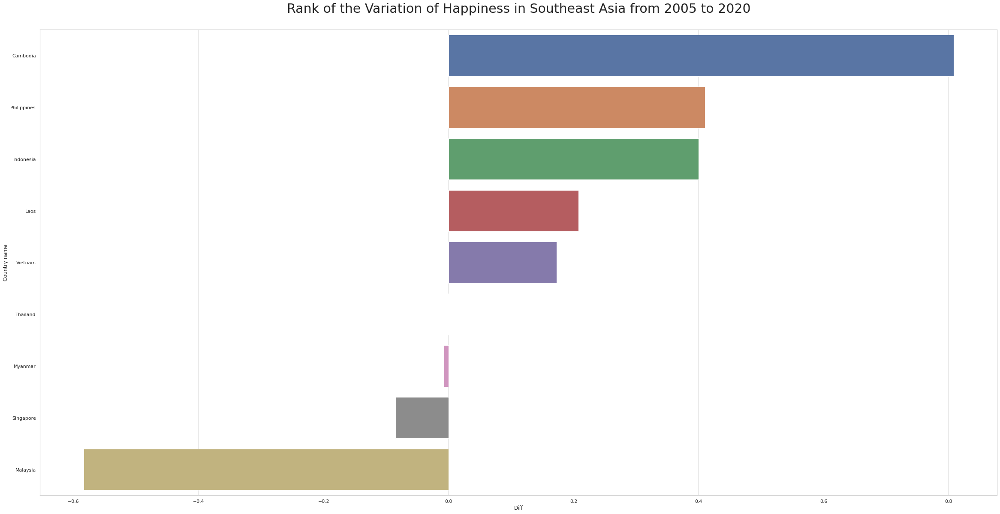

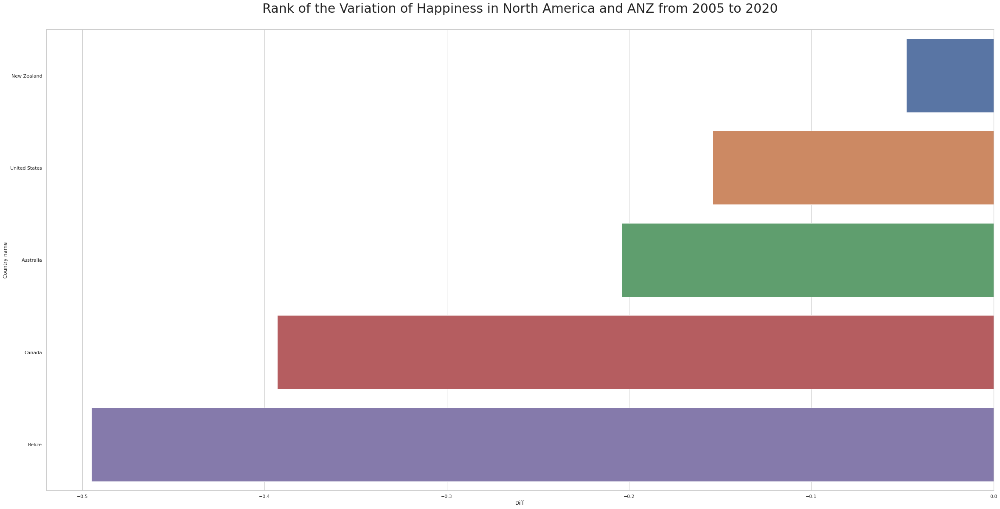

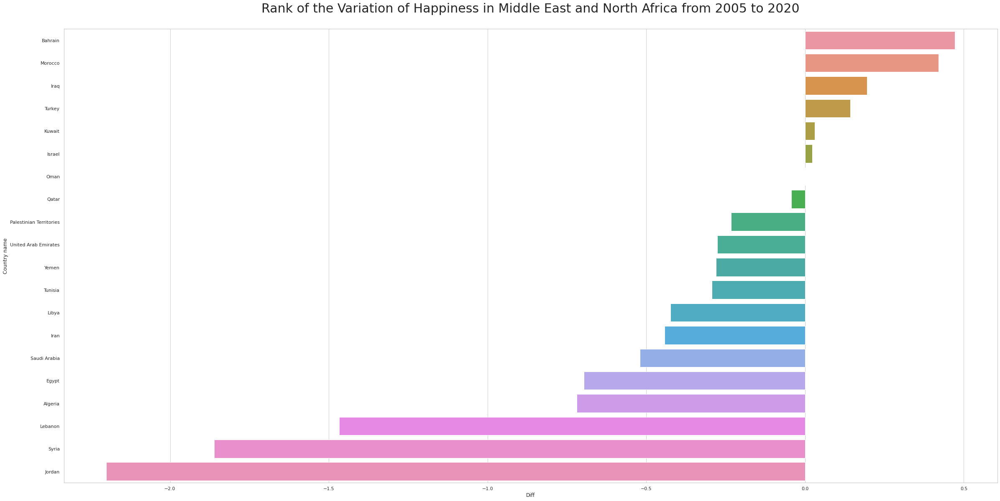

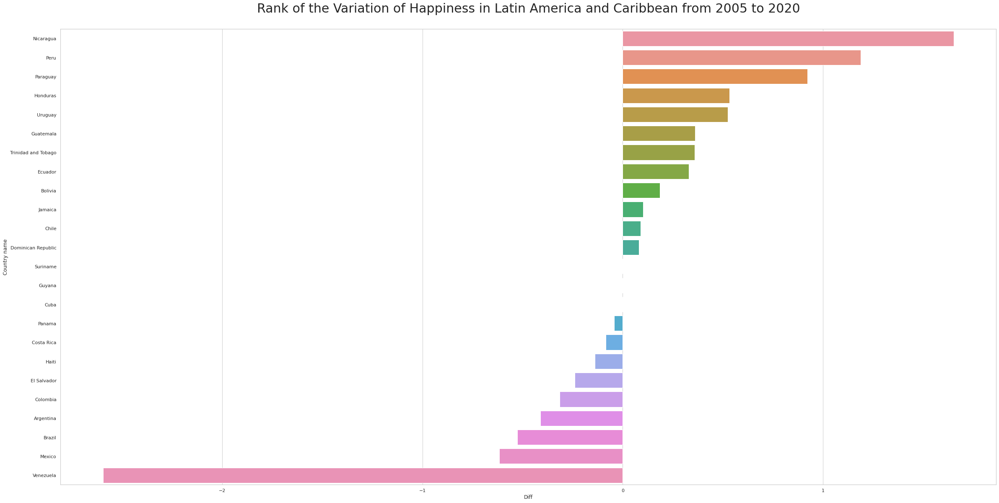

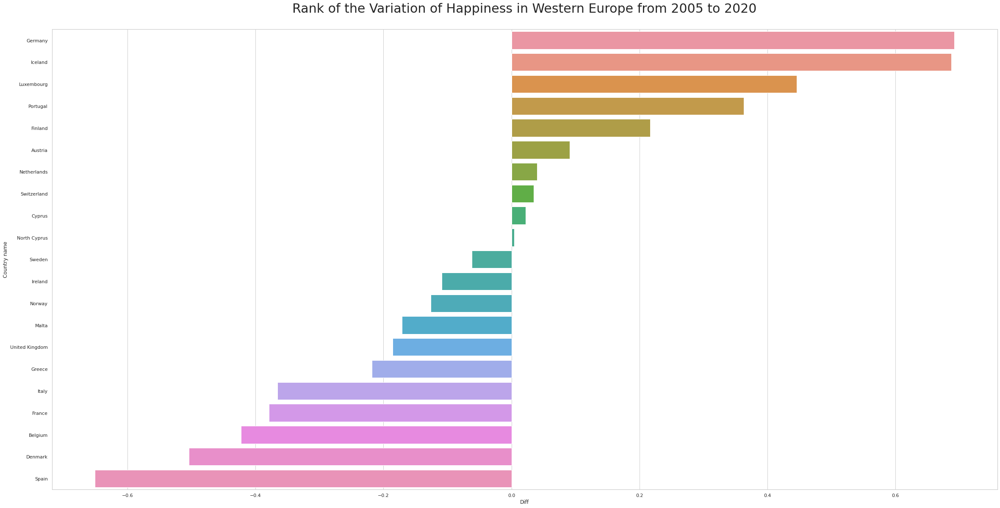

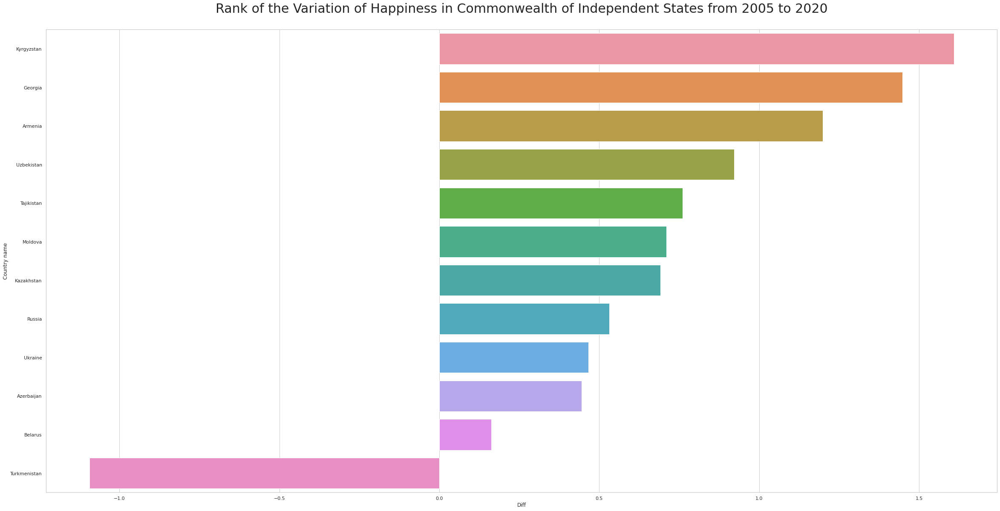

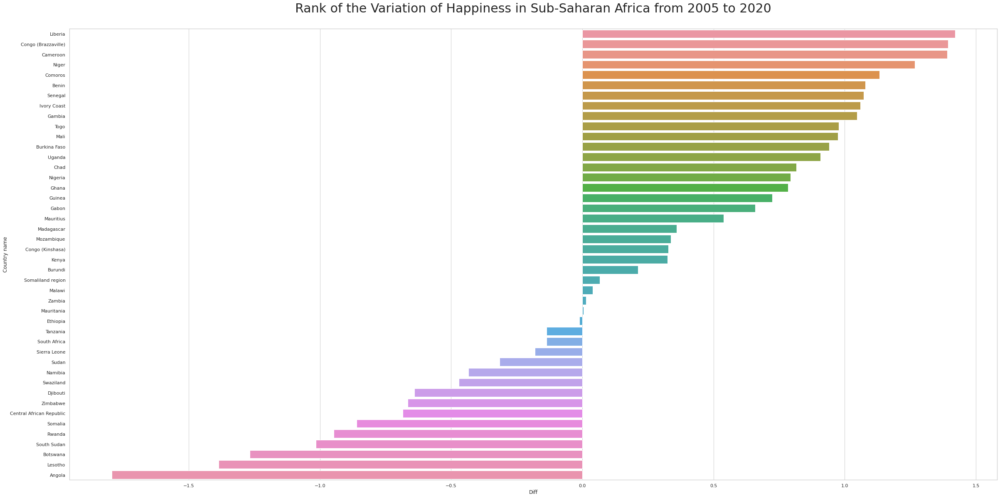

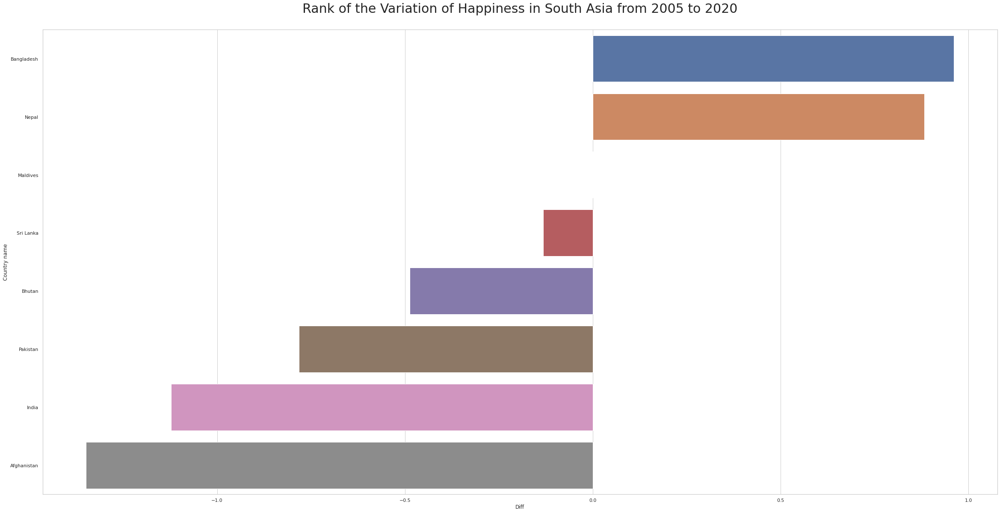

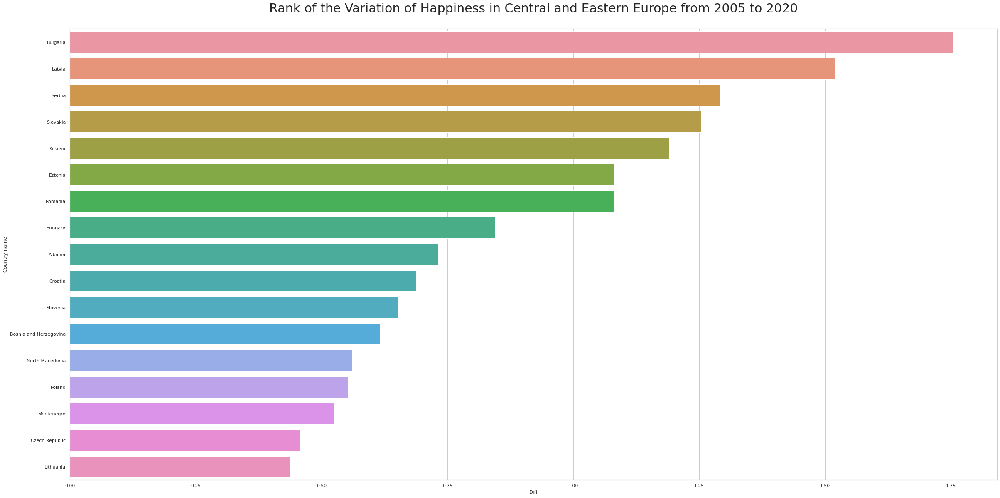

<Figure size 2880x1440 with 0 Axes>

In [1544]:
df_happiness_rank_continent_country = df2.groupby(["Regional indicator","Country name"])["Life Ladder"].mean().sort_values(ascending=False)

for continent in continents:
    df_diff_country = df_diff[df_diff['Regional indicator'] == continent]
    
    sns.set_theme(style="whitegrid")
    plt.title("Rank of the Variation of Happiness in " + continent + " from 2005 to 2020\n", fontsize=30)
    sns.barplot(x="Diff", y="Country name", data=df_diff_country)
    plt.figure()

We can observe some regions who are getting happier since 2005 as **Central and Eastern Europe** and **Commonwealth of Independent States** and others regions who are getting sadder as **Middle East and North Africa**

But as we observed, the variation of happiness in regions is not meaningful, indeed, some countries happiness score cancel out each other and some are even outliers as we can see in the following plots

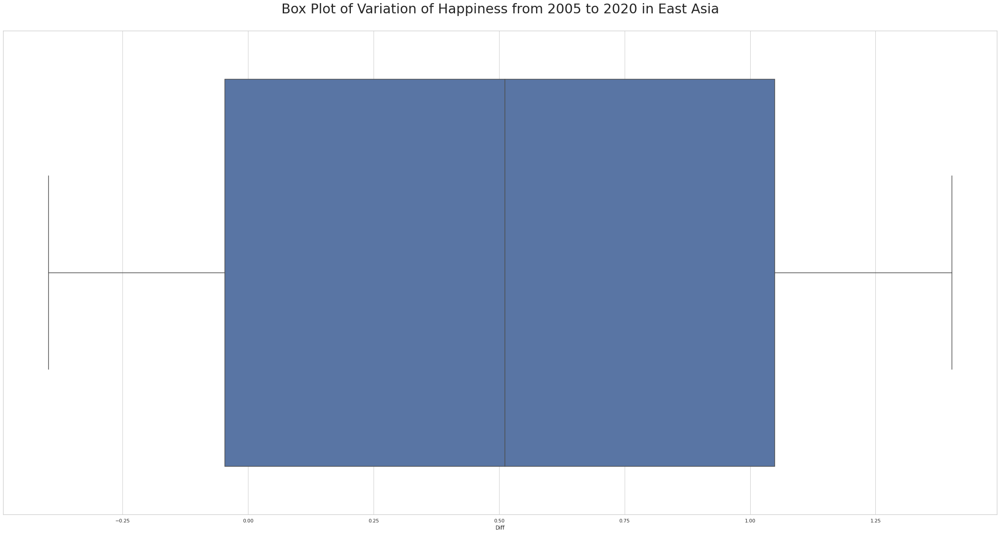

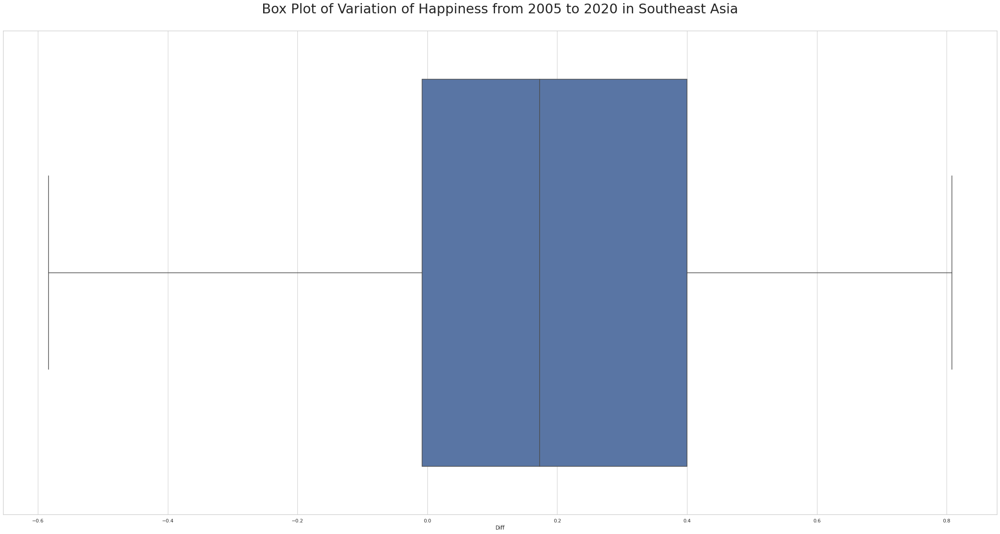

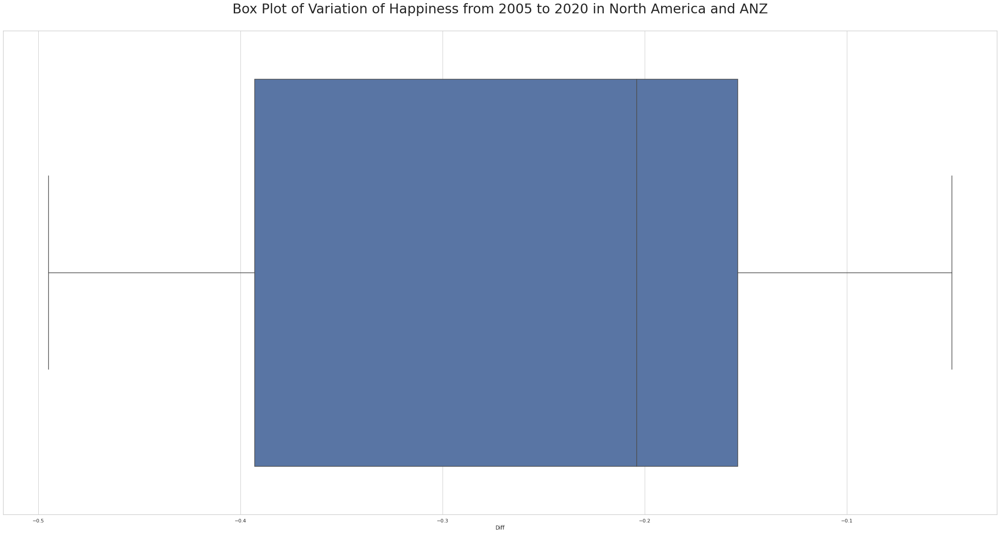

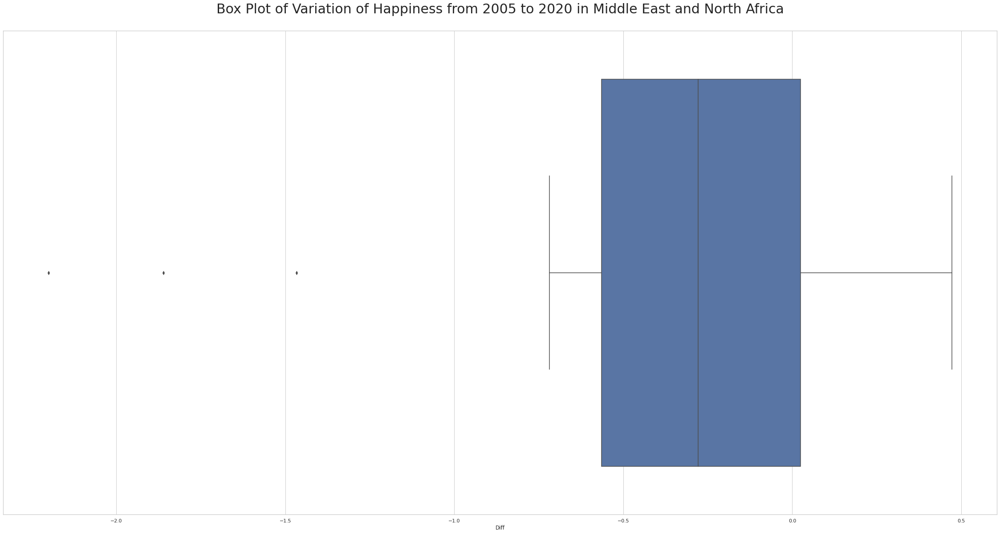

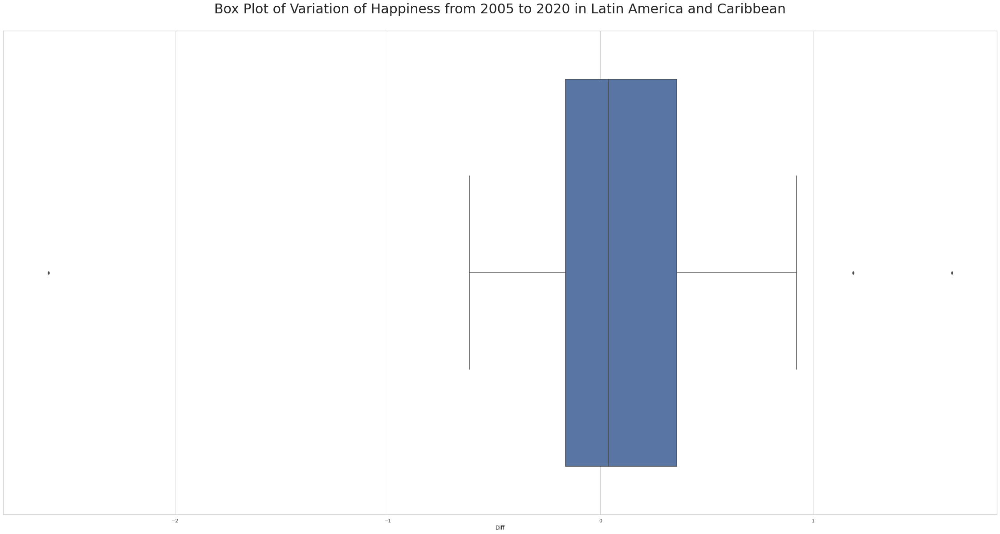

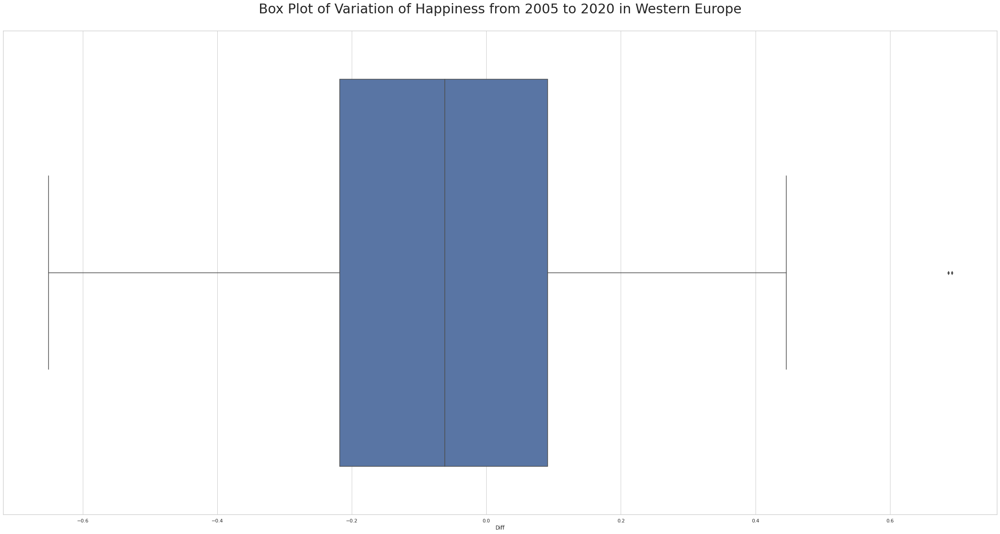

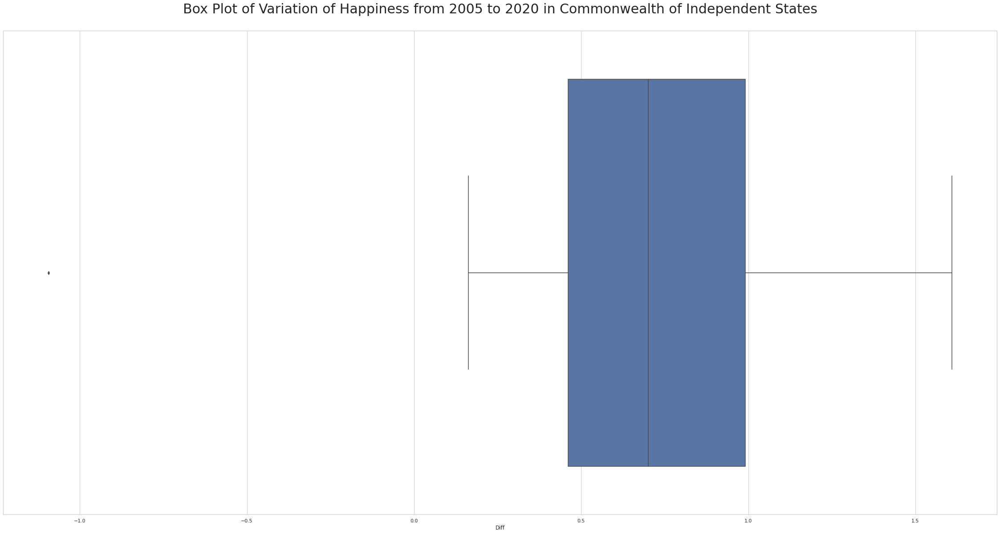

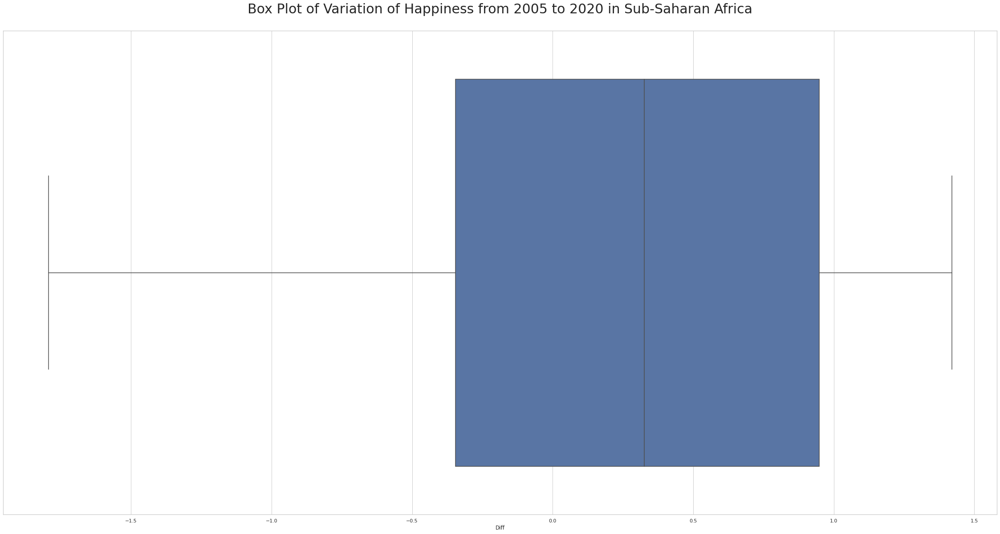

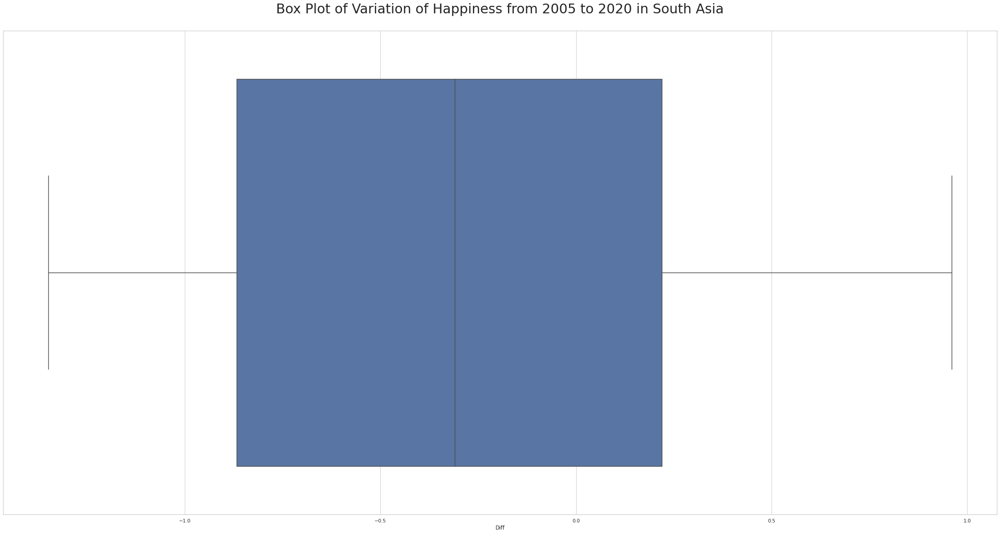

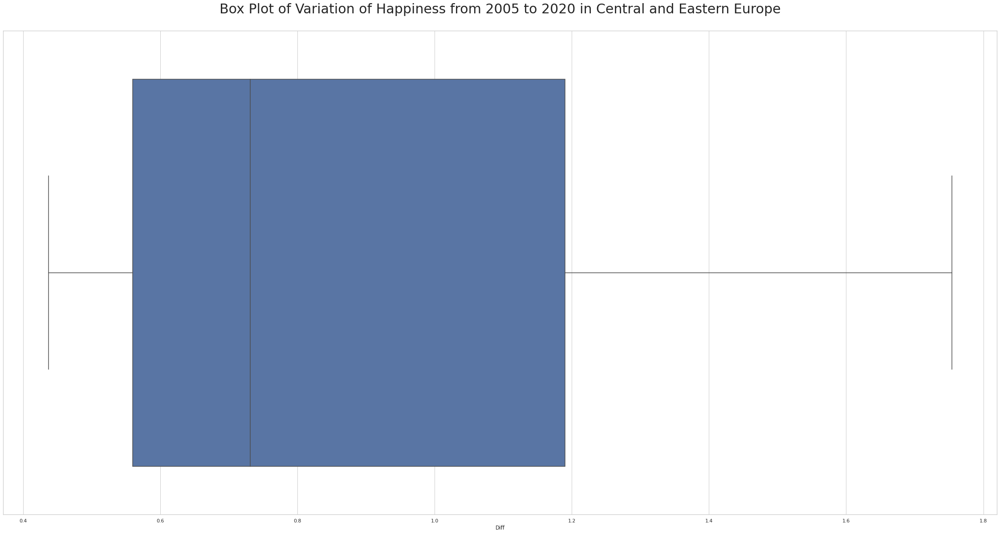

<Figure size 2880x1440 with 0 Axes>

In [1545]:
for continent in continents:
    df_diff_continent = df_diff[df_diff['Regional indicator'] == continent]
    plt.title('Box Plot of Variation of Happiness from 2005 to 2020 in ' + continent + "\n", fontsize=30)
    sns.boxplot(data=df_diff_continent, x="Diff")
    plt.figure()

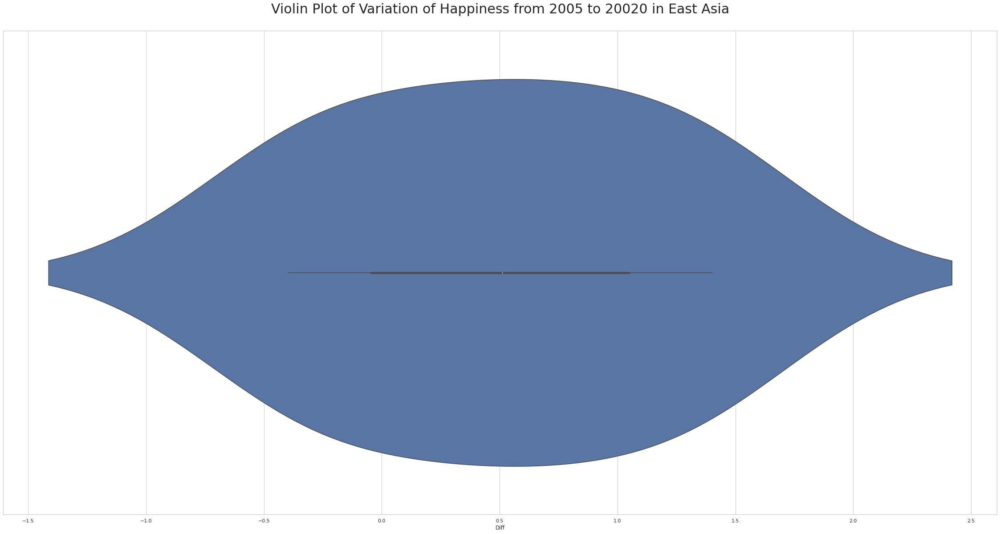

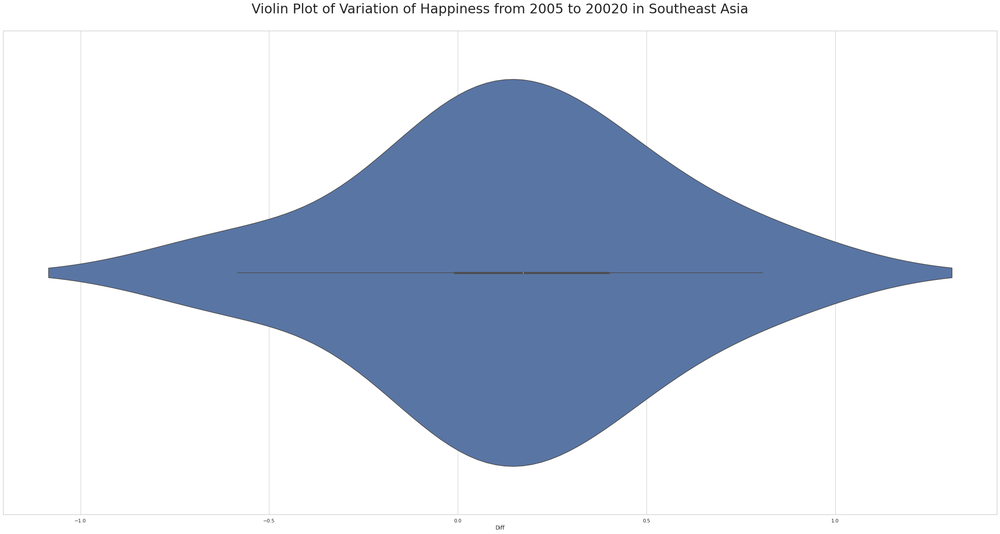

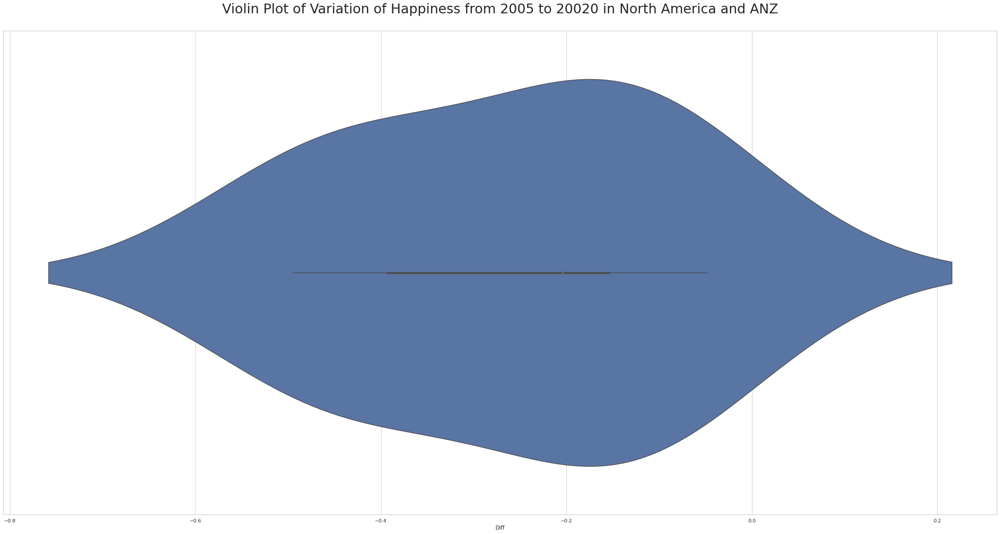

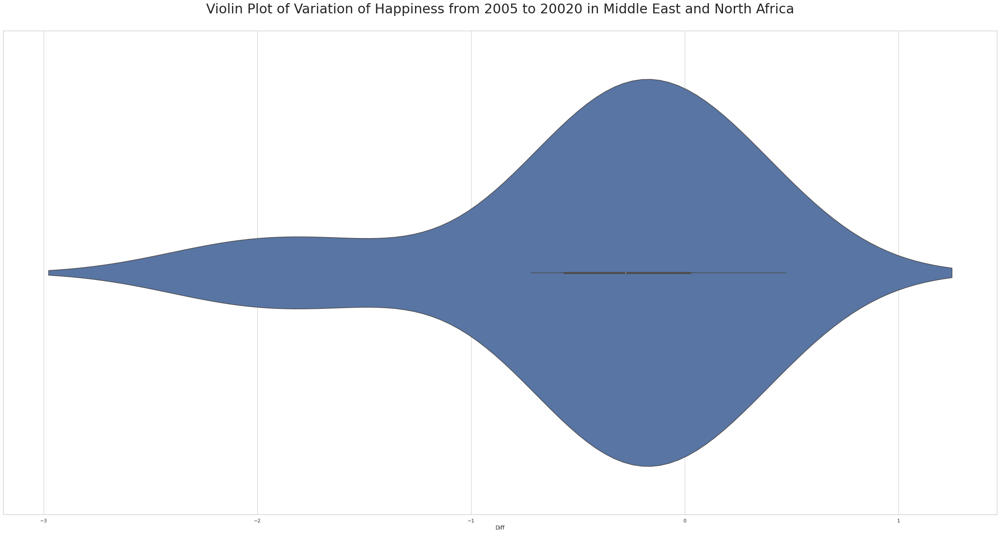

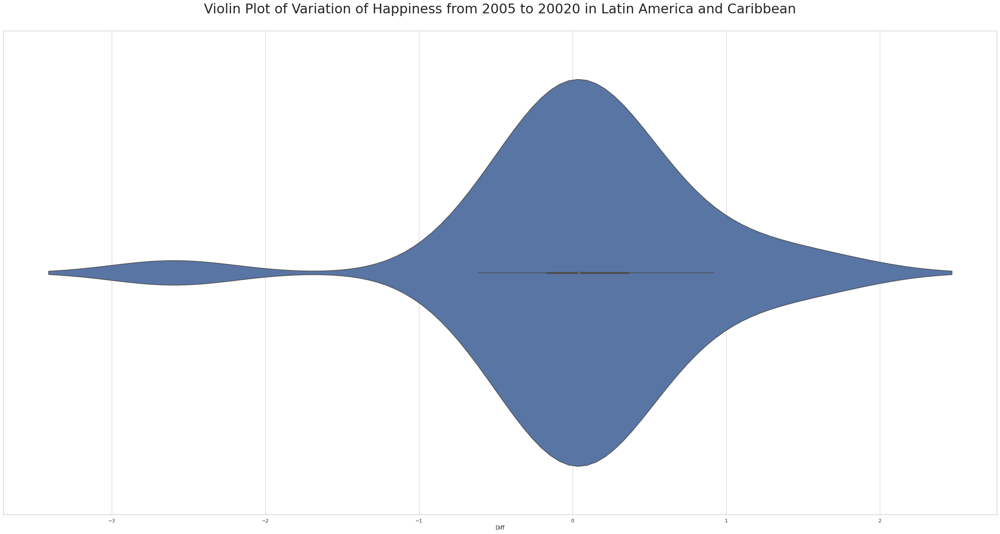

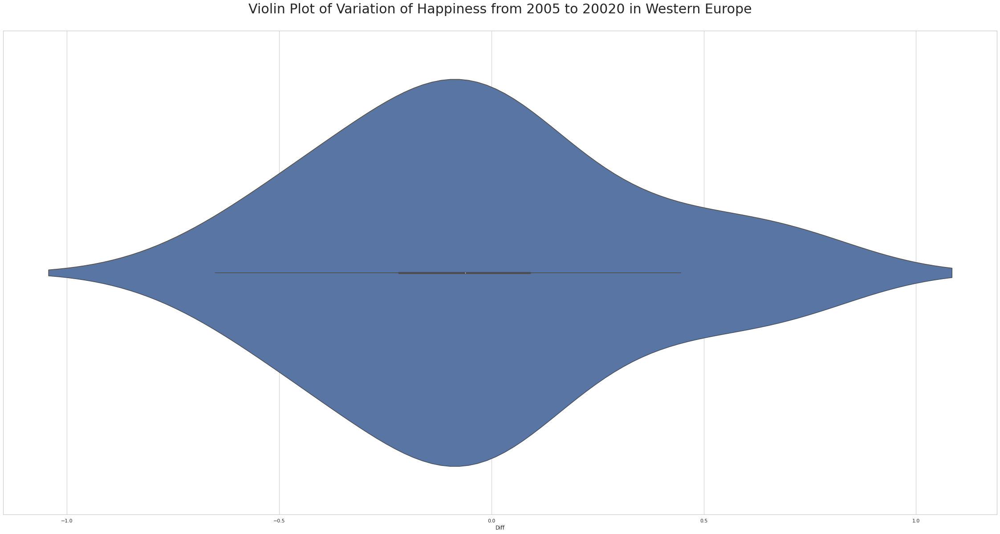

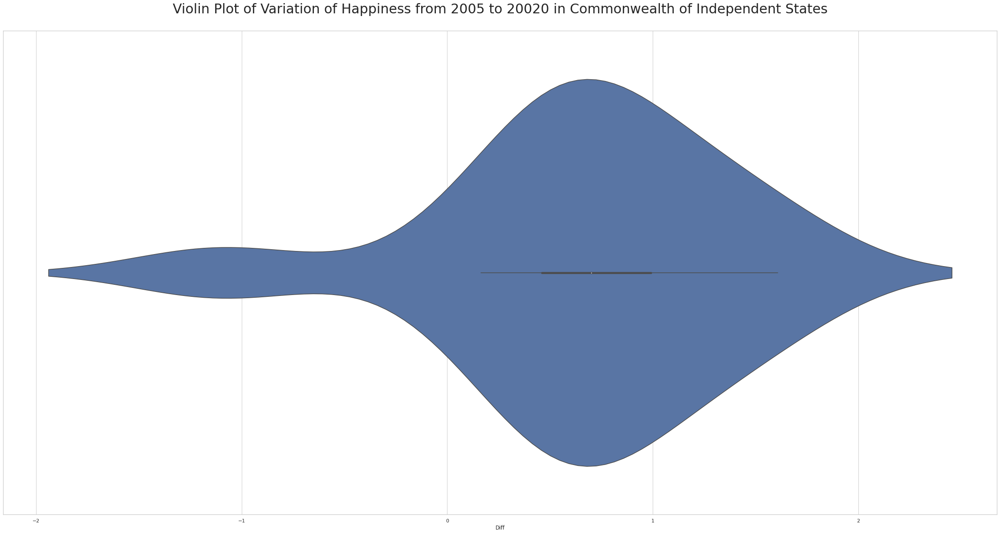

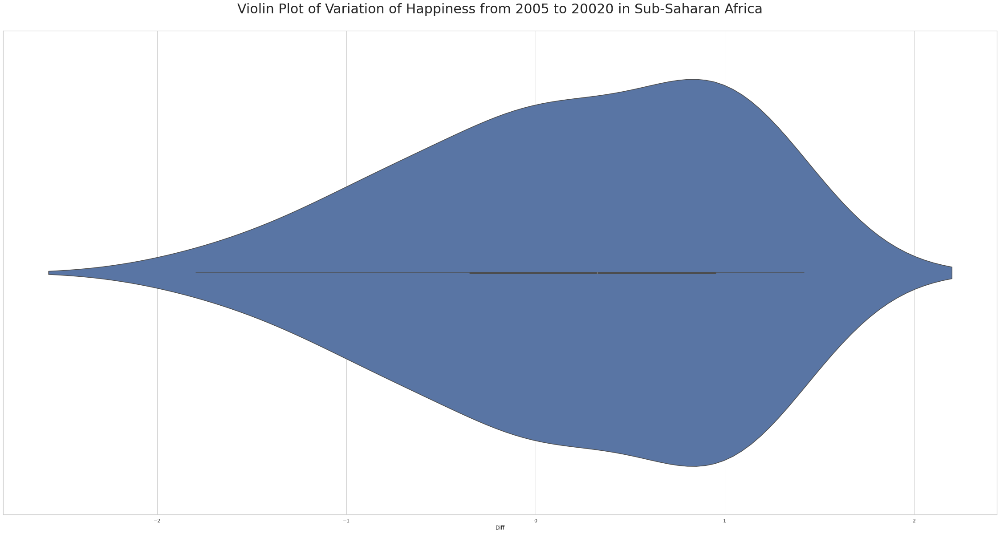

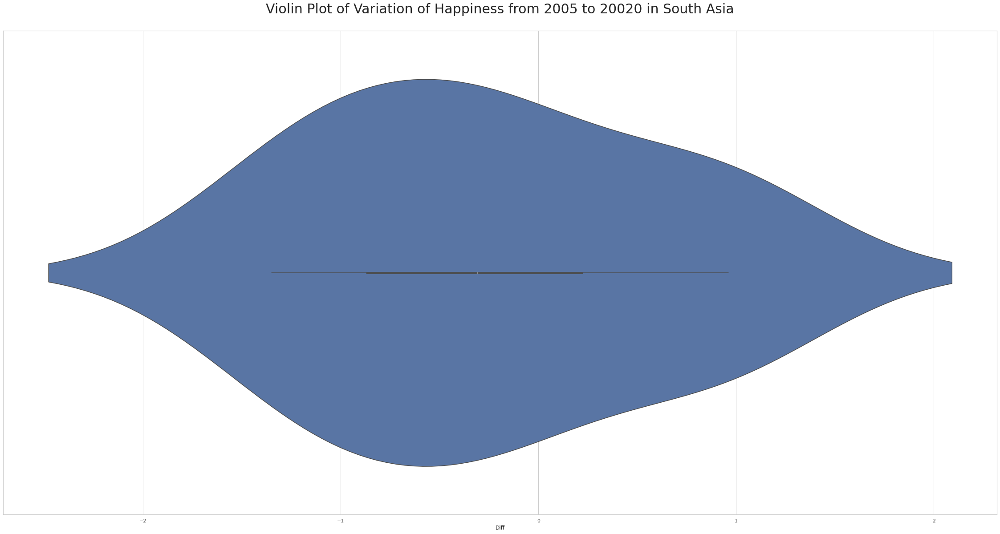

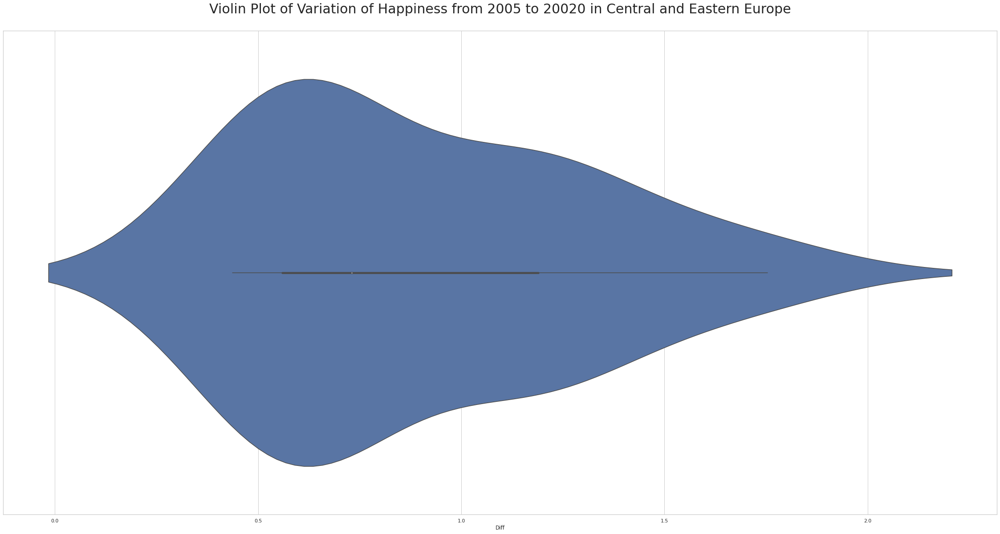

<Figure size 2880x1440 with 0 Axes>

In [1546]:
for continent in continents:
    df_diff_continent = df_diff[df_diff['Regional indicator'] == continent]
    plt.title('Violin Plot of Variation of Happiness from 2005 to 20020 in ' + continent + "\n", fontsize=30)
    sns.violinplot(data=df_diff_continent, x="Diff")
    plt.figure()

We can observe from the plot and the standard deviation of the variation of the happiness that it can vary a lot over the time for some countries within a region like in **South Asia**, **East Asia**, **Middle East and North Africa**, **Latin America and Caribbean**, **Commonwealth of Independent States** and **Sub-Saharan Africa**, but not so much as to raise a country in happiness or sadness except for **Venezuela** surely caused by the socioeconomic and political crisis began in 2013 and for **Jordan** where the government started to implement "open market" principles and selling public sector to reduce government expenditure and stopped support of essential products which caused an increase of the prices.

We can understand that countries tend to stay in the same rank of happiness over related period of time except for countries that are facing crisis.

In conclusion we observe that the happiness score can be moderately explained by the region (location itself), but it's not so meaningful, indeed some countries from some region are outlier from it region, all countries from each region don't vary in the same direction and with the same intensity.

The location itself is not really a direct cause of the happiness, the happiness can be explained by a lot of different factors of the country like its wealth, its politic for the economy, health, education, war, diplomatic relations... All those factors even the region are more to be virtuous circles, with two-way linkages among the factors.

## Data Modeling

### Clustering

#### Naive Clustering

At first sight, with the previous analysis, we can observe 3 clusters of regions for happiness:
- **Sub-Saharan Africa** with **South Asia** (Average Happiness Score: 4.465)
- **Commonwealth of Independent States**, **Southeast Asia**, **Middle East and North Africa**, **Central and Eastern Europe**, **East Asia** and **Latin America and Caribbean** (Average Happiness Score: 5.527)
- **Western Europe** and **North America and ANZ** (AverageHappiness Score: 7.043)

In [1547]:
data_frame_cluster_assumption = df2.copy(deep=True)

list_cluster = []
for i in range(data_frame_cluster_assumption.shape[0]):
    regional_name = data_frame_cluster_assumption["Regional indicator"][i]
    if regional_name in ["Sub-Saharan Africa", "South Asia"]:
        list_cluster.append(0)
    elif regional_name in ["Commonwealth of Independent States", "Southeast Asia", "Middle East and North Africa", "Central and Eastern Europe", "East Asia", "Latin America and Caribbean"]:
        list_cluster.append(1)
    elif regional_name in ["Western Europe", "North America and ANZ"]:
        list_cluster.append(2)
    
    
data_frame_cluster_assumption["Cluster"] = list_cluster

fig = px.choropleth(data_frame_cluster_assumption,
                    locations="Country code",
                    color="Cluster", 
                    hover_name="Country name",
                    color_continuous_scale=px.colors.sequential.Plasma)

fig.show()

But let's use clustering technique to use all the factors to find how the countries can be clustered instead of focusing on the region criteria since it's not a direct cause

Before applying any statistical method we should preprocess the data regarding the method we will use, in our case, we will use 3 clustering methods, **K-Means**, **K-Medoids** and **DBSCAN**, **K-Medoids** is a more robust method regarding outliers than the **K-Means** method and **DBSCAN (Density-Based Spatial Clustering of Applications with Noise)** manage not only the outliers but is very good at clustering arbitrary shape of data.

#### Data Cleaning

First we will remove **year** and the **Country name** of our data set since it will not bring significative information to our problem. We can use One hot encoding but it will significantly increase the dimension then decrease the performance of our above algorithms.

In [1548]:
data_frame_original = df2.copy(deep=True)
list_year = list(data_frame_original['year'])
list_country_name = list(data_frame_original['Country name'])

#Keep only numerical feature
data_frame = data_frame_original[['Life Ladder','Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity','Perceptions of corruption','Positive affect','Negative affect']]

data_frame

,Life Ladder,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect
0,3.724,7.370,0.451,50.80,0.718,0.168,0.882,0.518,0.258
1,4.402,7.540,0.552,51.20,0.679,0.190,0.850,0.584,0.237
2,4.758,7.647,0.539,51.60,0.600,0.121,0.707,0.618,0.275
3,3.832,7.620,0.521,51.92,0.496,0.162,0.731,0.611,0.267
4,3.783,7.705,0.521,52.24,0.531,0.236,0.776,0.710,0.268
...,...,...,...,...,...,...,...,...,...
1944,3.735,7.984,0.768,54.40,0.733,-0.095,0.724,0.738,0.209
1945,3.638,8.016,0.754,55.00,0.753,-0.098,0.751,0.806,0.224
1946,3.616,8.049,0.775,55.60,0.763,-0.068,0.844,0.710,0.212
1947,2.694,7.950,0.759,56.20,0.632,-0.064,0.831,0.716,0.235


##### Missing Data Imputation

The data set contains some missing values and some models and techniques require no missing values while for other models let the missing values can help to extract some meanings from it.

###### k-NN Imputer

To impute the missing data we will use the **k-Nearest Neighbors algorithm (k-NN)** instead to impute the missing data with the mean or the median of features.

In [1549]:
optimal_neighbors = round(data_frame.shape[0]**0.5)
if (optimal_neighbors % 2) == 0: optimal_neighbors += 1

imputer = KNNImputer(n_neighbors=round(data_frame.shape[0]**0.5))

#An article declared that the optimal value for neighbors is n^(1/2) 
#where n is the number of records and the optimal value should be also odd to avoid ties in choice

data_frame_nan_imp = imputer.fit_transform(data_frame)

data_frame_nan_imp  = pd.DataFrame(data_frame_nan_imp)
data_frame_nan_imp.columns = data_frame.columns

data_frame_nan_imp

,Life Ladder,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect
0,3.724,7.370,0.451,50.80,0.718,0.168,0.882,0.518,0.258
1,4.402,7.540,0.552,51.20,0.679,0.190,0.850,0.584,0.237
2,4.758,7.647,0.539,51.60,0.600,0.121,0.707,0.618,0.275
3,3.832,7.620,0.521,51.92,0.496,0.162,0.731,0.611,0.267
4,3.783,7.705,0.521,52.24,0.531,0.236,0.776,0.710,0.268
...,...,...,...,...,...,...,...,...,...
1944,3.735,7.984,0.768,54.40,0.733,-0.095,0.724,0.738,0.209
1945,3.638,8.016,0.754,55.00,0.753,-0.098,0.751,0.806,0.224
1946,3.616,8.049,0.775,55.60,0.763,-0.068,0.844,0.710,0.212
1947,2.694,7.950,0.759,56.20,0.632,-0.064,0.831,0.716,0.235


##### Data Transformation

For model performance reasons our data should be standardized (especially for K-Means/K-Medoid, variance for features should be equal each other), but since we are planning to use other models than clustering, and most of machine learning model is based on the assumption that variable are gaussian we will apply a power transformation technique.

###### Yeo-Johnson Transformation

Since our features contains negative values we will apply **Yeo-Johnson** transformation

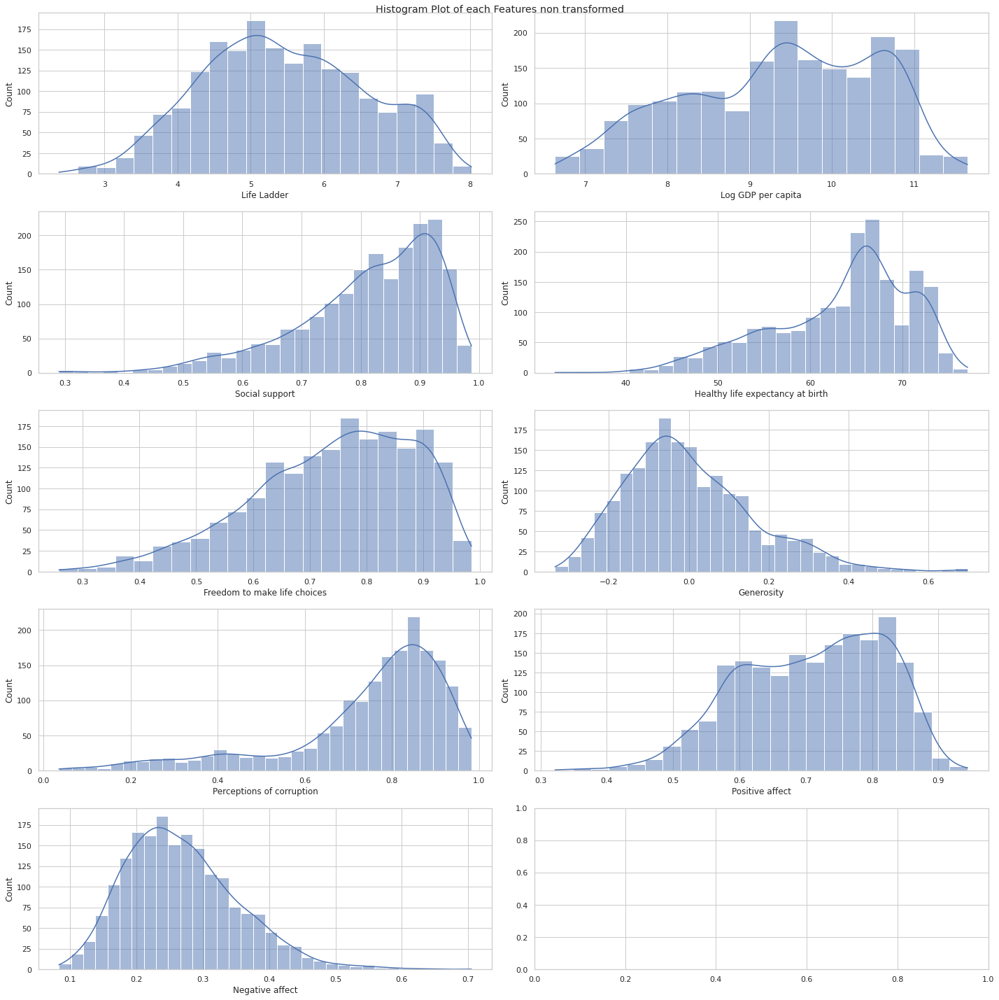

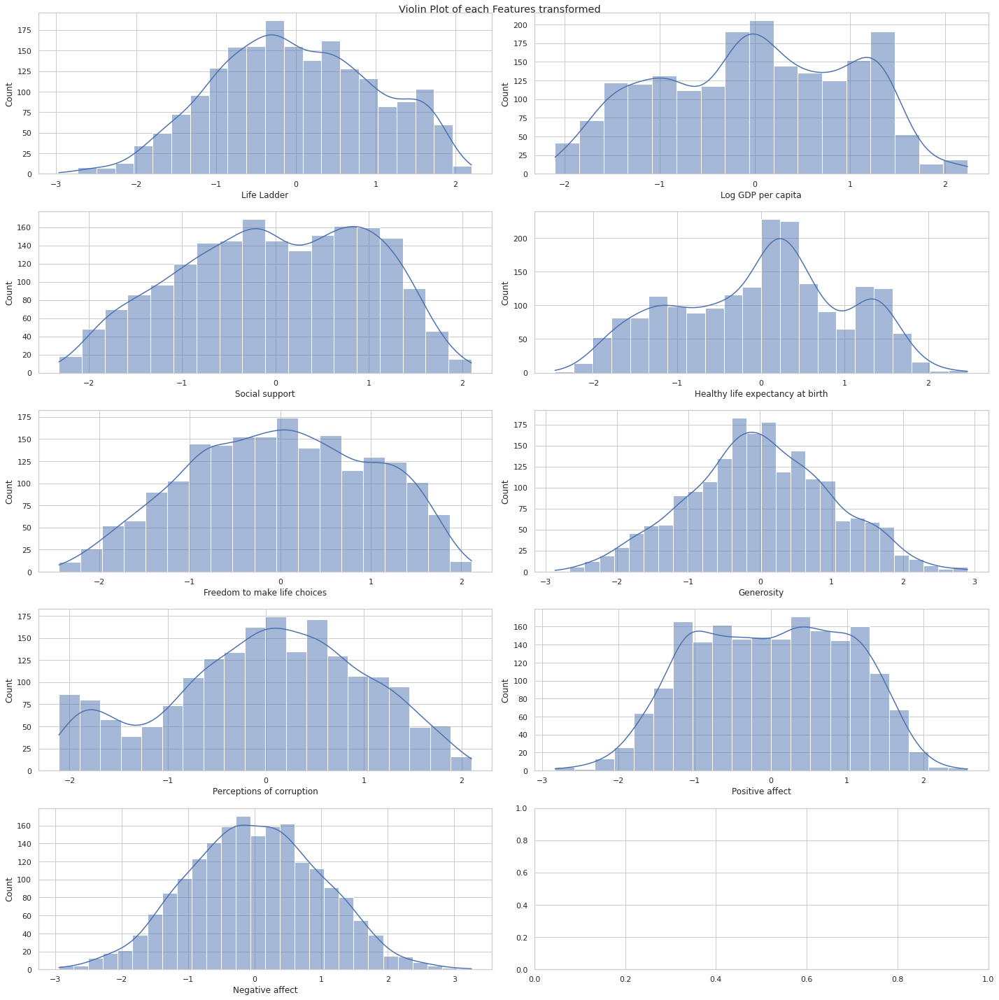

In [1550]:
pt = PowerTransformer(method='yeo-johnson')
pt.fit(data_frame_nan_imp)
data_frame_transf = pd.DataFrame(pt.transform(data_frame_nan_imp))
data_frame_transf.columns = data_frame.columns

fig, axes = plt.subplots(5, 2, figsize=(20, 20))
fig.suptitle('Histogram Plot of each Features non transformed')
for column_name, ax in zip(list(data_frame.columns), axes.flat):
    fig.tight_layout()
    sns.histplot(data=data_frame, x=data_frame[column_name], ax=ax, kde=True)
    
fig, axes = plt.subplots(5, 2, figsize=(20, 20))
fig.suptitle('Violin Plot of each Features transformed')
for column_name, ax in zip(list(data_frame_transf.columns), axes.flat):
    fig.tight_layout()
    sns.histplot(data=data_frame_transf, x=data_frame_transf[column_name], ax=ax, kde=True)
    

We can observe the transformation in the preprocessed data, indeed the new distribution are more likely to follow the standard normal distribution

##### Data Reduction

###### Principal Component Analysis

Let's now "reduce the dimension" of the data by removing the highly correlated variable, for that we will use **PCA** techniques to remove multi-collinear features, but for our case we will keep the same number of components as our initial number of features which is not high.

For the clustering method, PCA can help by giving a direction for the clusters.

In [1551]:
pca = PCA()
pca.fit(data_frame_transf)

print("{} components were used for PCA which explain {}% of the variability in the original data.".format(len(pca.explained_variance_ratio_),pca.explained_variance_ratio_.sum()*100))

data_frame_PCA = pca.transform(data_frame_transf)

data_frame_PCA = pd.DataFrame(data_frame_PCA)

data_frame_PCA

9 components were used for PCA which explain 99.99999999999997% of the variability in the original data.


,0,1,2,3,4,5,6,7,8
0,3.468468,-1.454894,0.072468,-0.136658,0.937630,0.799385,-0.960030,-0.388374,0.012850
1,2.804571,-1.543779,-0.146845,-0.152890,1.036846,0.252867,-0.617243,-0.683144,-0.033779
2,2.583831,-1.466531,0.416293,0.612822,0.891798,-0.587595,-0.052243,-0.758677,-0.048122
3,3.176185,-1.497696,0.235003,0.505467,1.268131,-0.770751,-0.153835,-0.028933,0.090625
4,2.859096,-1.932633,0.131624,-0.156363,0.908681,-1.053933,-0.264618,0.187292,0.234886
...,...,...,...,...,...,...,...,...,...
1944,1.715727,-1.144529,-1.017726,0.953909,-0.526666,-0.074942,0.193541,0.603873,0.107656
1945,1.581370,-1.342311,-0.961287,0.584283,-1.076210,-0.355422,0.100473,0.807451,0.199156
1946,1.905031,-0.890640,-1.102801,0.211557,-0.442288,0.477896,-0.158786,0.626307,0.091523
1947,2.690215,-0.784680,-0.956072,0.255881,-0.181757,-0.115398,-0.019501,1.474369,0.191313


#### K-Means

The performance metric we will use for the **K-Means** algorithm is the **silhouette score** and the **elbow method**

For n_clusters = 2 The average silhouette_score is : 0.2769752234594219
For n_clusters = 3 The average silhouette_score is : 0.21813398926672187
For n_clusters = 4 The average silhouette_score is : 0.21394352556719026
For n_clusters = 5 The average silhouette_score is : 0.19626118787850202
For n_clusters = 6 The average silhouette_score is : 0.19559243637626847
For n_clusters = 7 The average silhouette_score is : 0.18122348927368873
For n_clusters = 8 The average silhouette_score is : 0.18341528980295735
For n_clusters = 9 The average silhouette_score is : 0.18861223146104975


<Figure size 2880x1440 with 0 Axes>

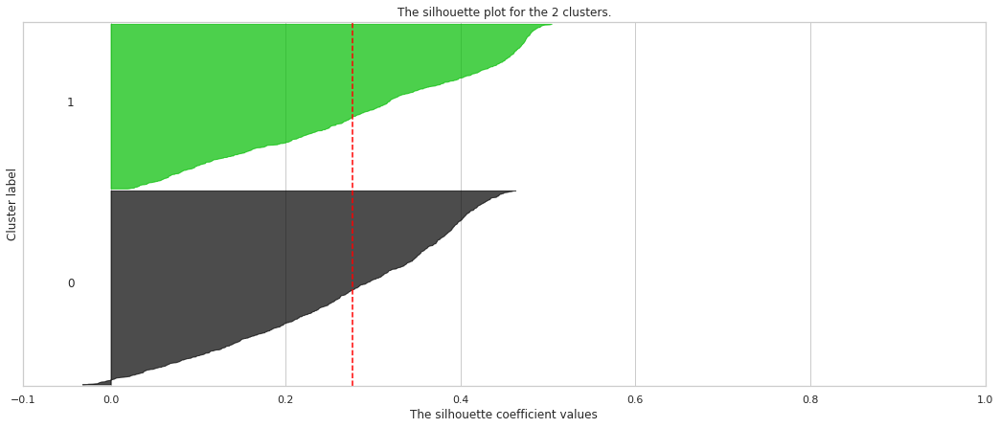

<Figure size 2880x1440 with 0 Axes>

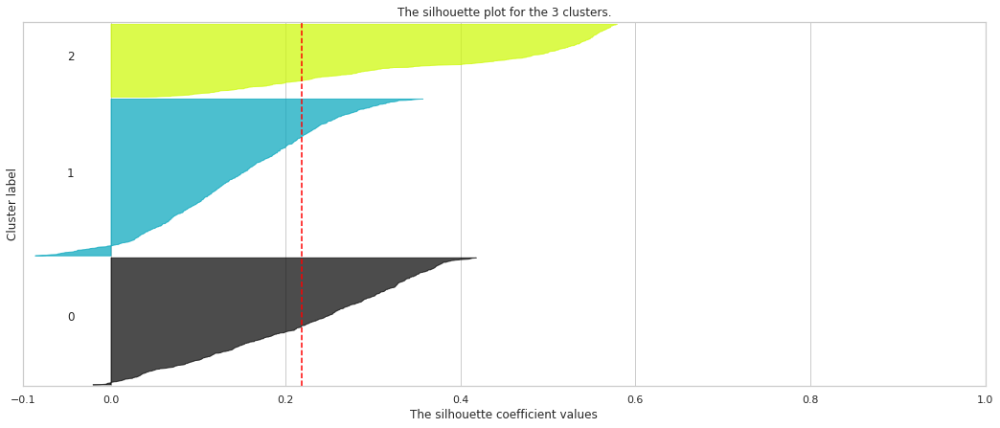

<Figure size 2880x1440 with 0 Axes>

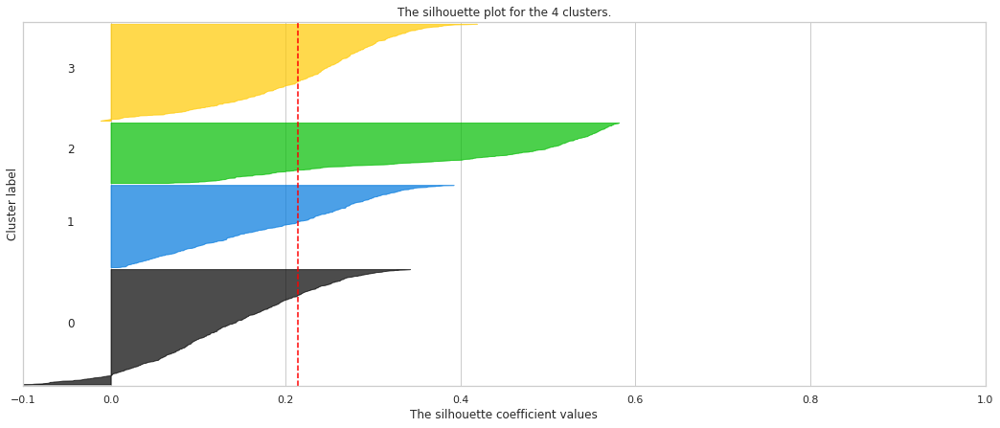

<Figure size 2880x1440 with 0 Axes>

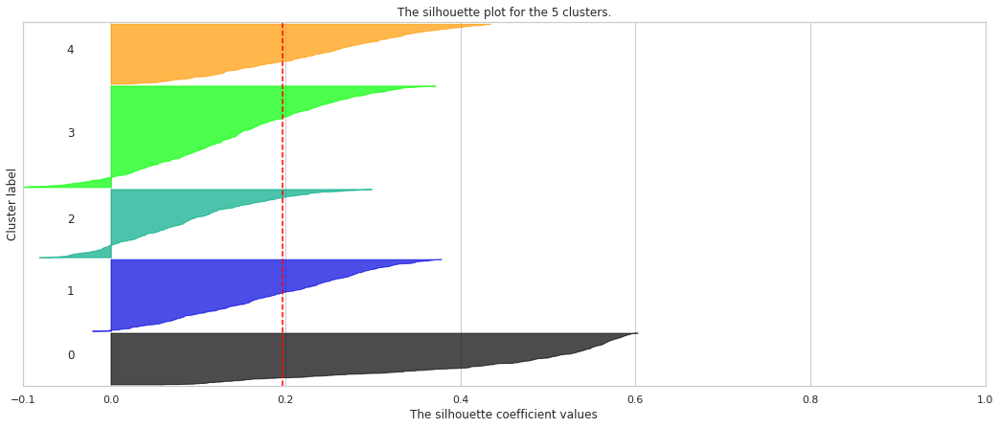

<Figure size 2880x1440 with 0 Axes>

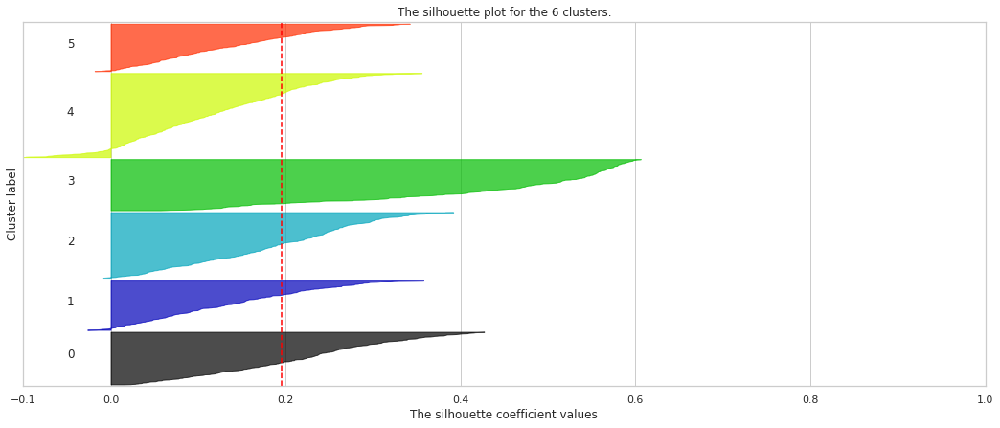

<Figure size 2880x1440 with 0 Axes>

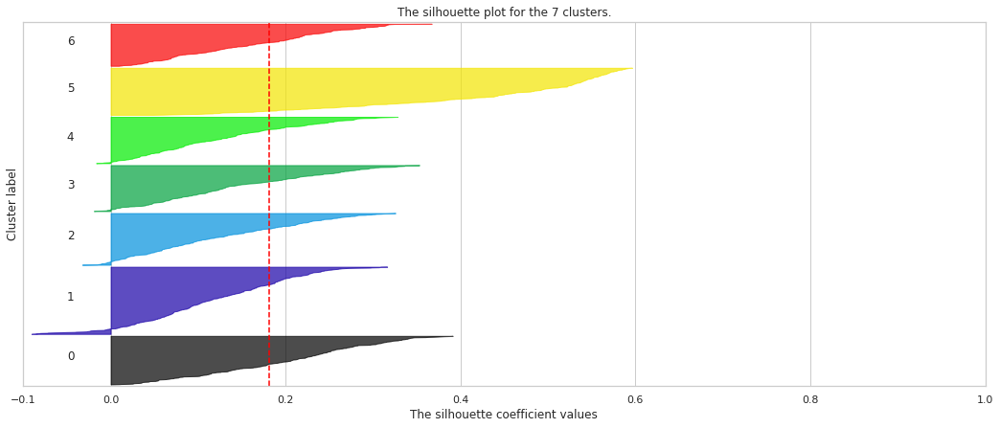

<Figure size 2880x1440 with 0 Axes>

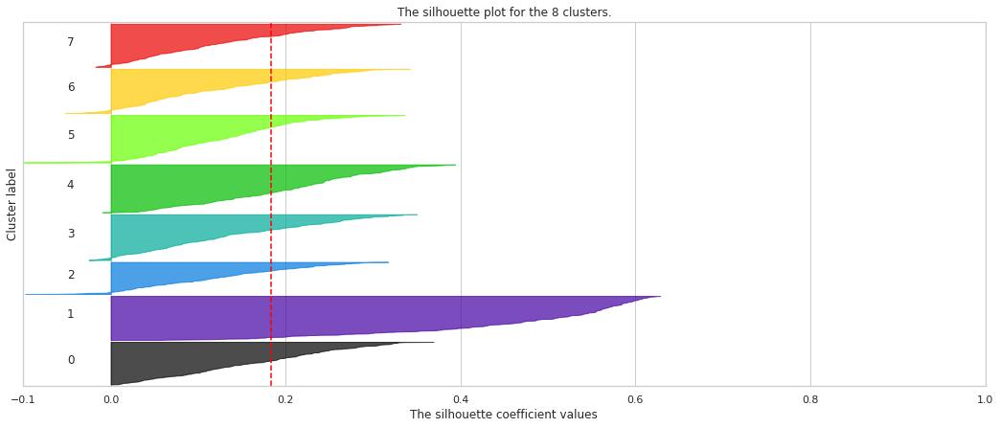

<Figure size 2880x1440 with 0 Axes>

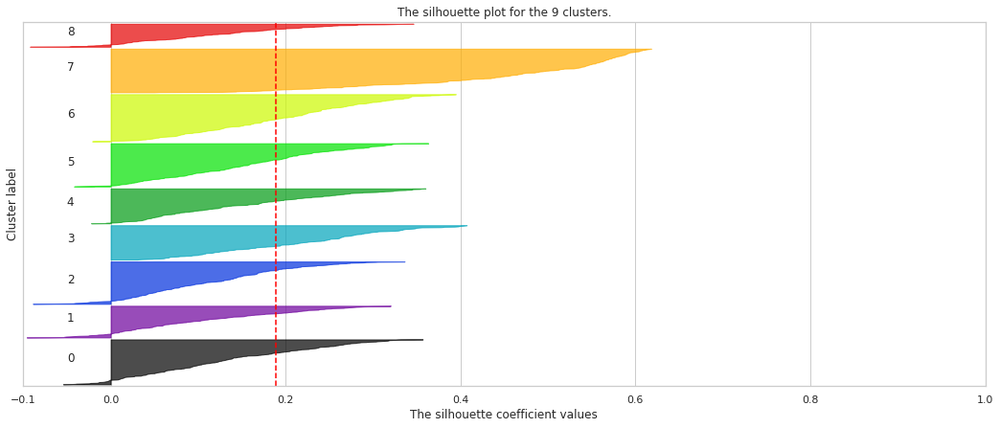

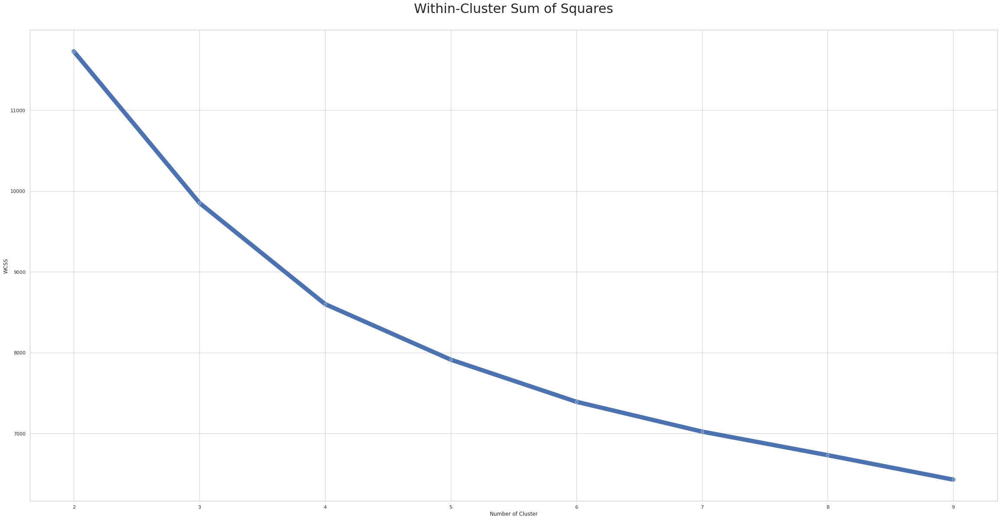

<Figure size 2880x1440 with 0 Axes>

In [1552]:
max_cluster = 10
wcss = []
x = range(2,max_cluster)
X = data_frame_PCA

for k in x:
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state=5).fit(X)
    wcss.append(kmeans.inertia_)
    cluster_labels = kmeans.labels_
    
    # Create a subplot with 1 row and 2 columns
    fig, ax1 = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (k + 1) * 10])
    
    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(
        "For n_clusters =",
        k,
        "The average silhouette_score is :",
        silhouette_avg,
    )
    
    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)
    
    y_lower = 10
    for i in range(k):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / k)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the " + str(k) + " clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    plt.figure()

data_kmedoids_wcss = pd.DataFrame({"Number of Cluster":x,"WCSS":wcss})

plt.title("Within-Cluster Sum of Squares\n", fontsize=30)
sns.lineplot(data=data_kmedoids_wcss, 
             x="Number of Cluster", 
             y="WCSS",
             linewidth=10,
             err_style="bars",
             markers=True,
             marker='o')
plt.figure()

#### K-Medoids

The performance metric we will use for the **K-Medoids** algorithm is also the **silhouette score** and the **elbow method**

For n_clusters = 2 The average silhouette_score is : 0.27670637838087814
For n_clusters = 3 The average silhouette_score is : 0.21534220914288377
For n_clusters = 4 The average silhouette_score is : 0.182019600286918
For n_clusters = 5 The average silhouette_score is : 0.17065972840260457
For n_clusters = 6 The average silhouette_score is : 0.1503224987213061
For n_clusters = 7 The average silhouette_score is : 0.14107235994032383
For n_clusters = 8 The average silhouette_score is : 0.16090490144616038
For n_clusters = 9 The average silhouette_score is : 0.1592151536829527


<Figure size 2880x1440 with 0 Axes>

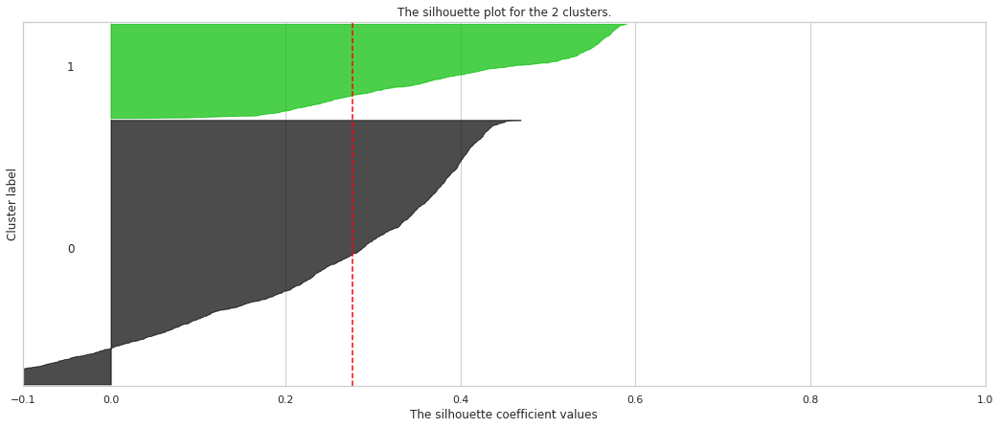

<Figure size 2880x1440 with 0 Axes>

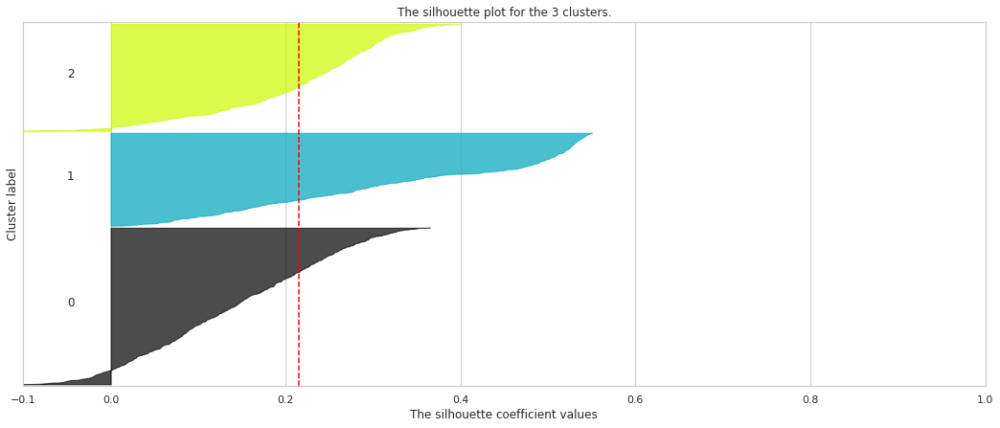

<Figure size 2880x1440 with 0 Axes>

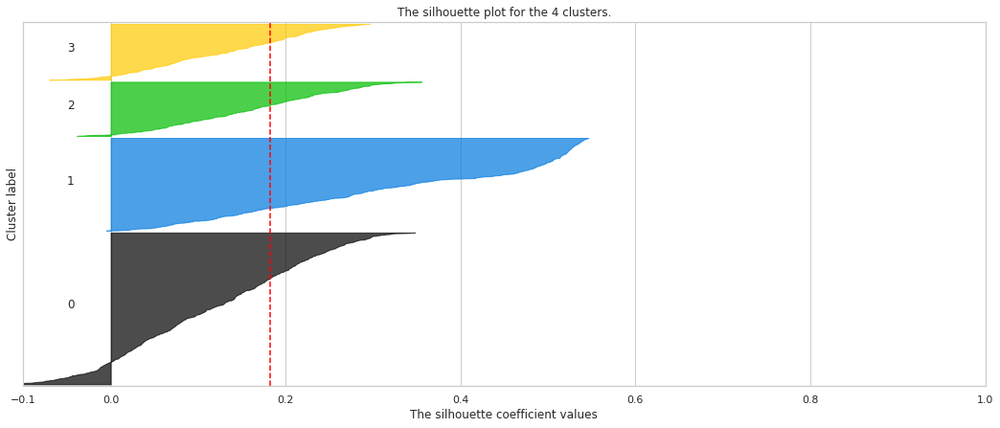

<Figure size 2880x1440 with 0 Axes>

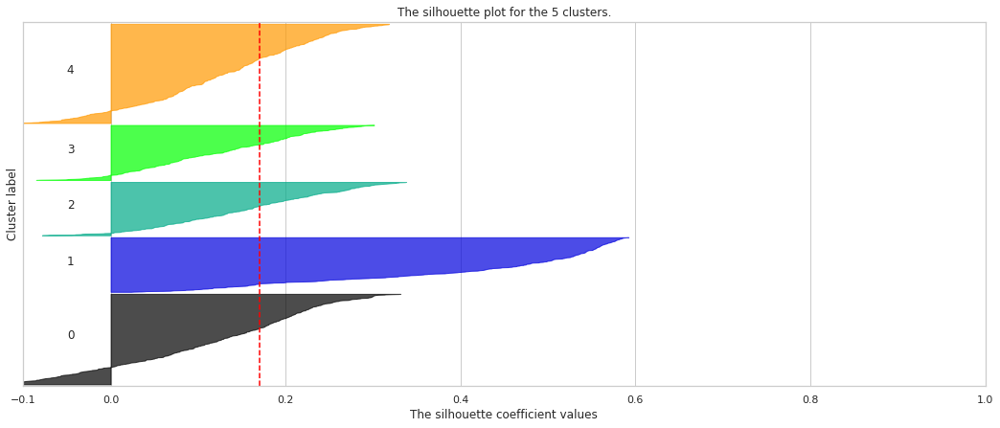

<Figure size 2880x1440 with 0 Axes>

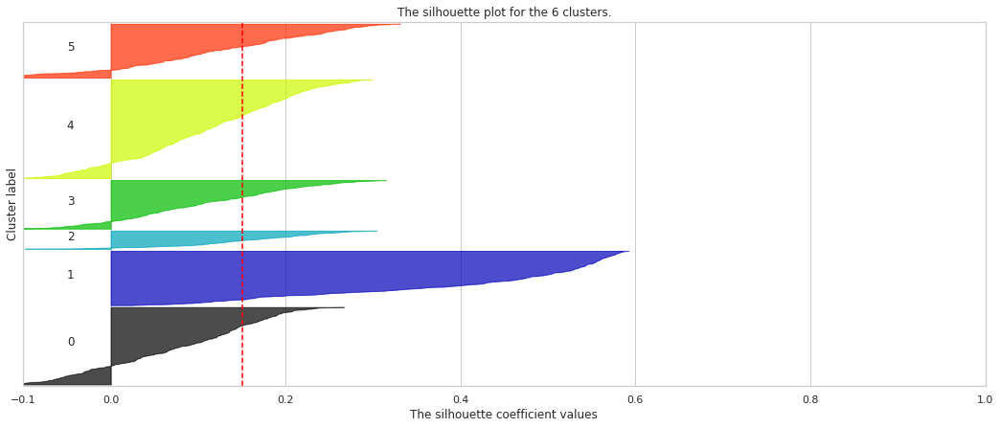

<Figure size 2880x1440 with 0 Axes>

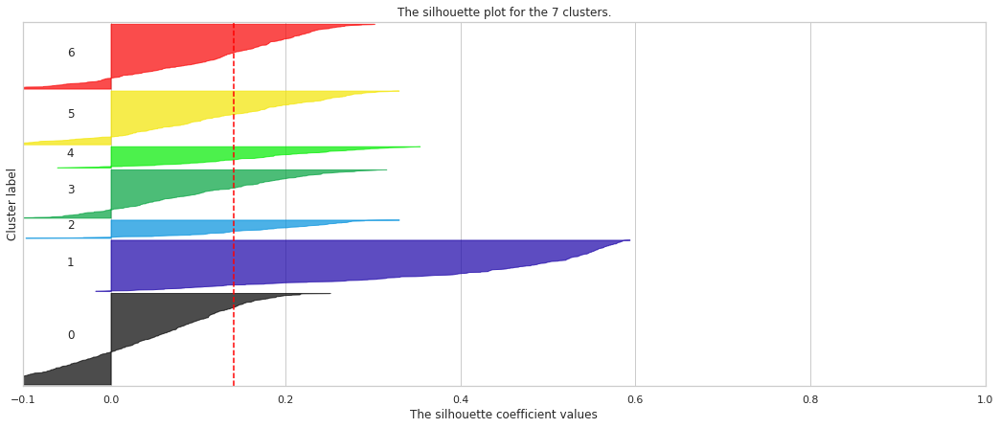

<Figure size 2880x1440 with 0 Axes>

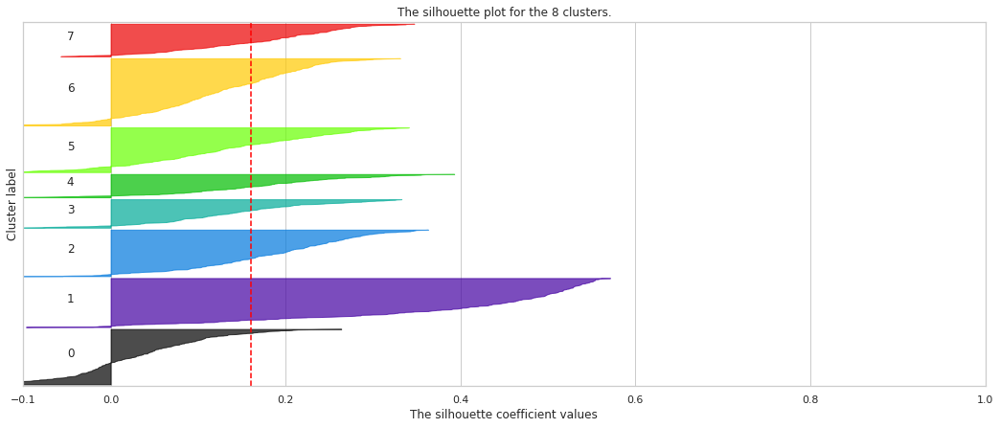

<Figure size 2880x1440 with 0 Axes>

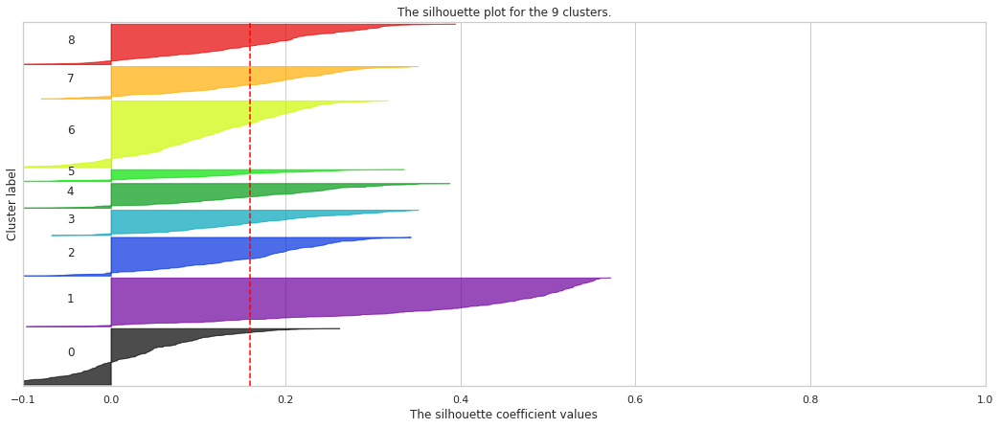

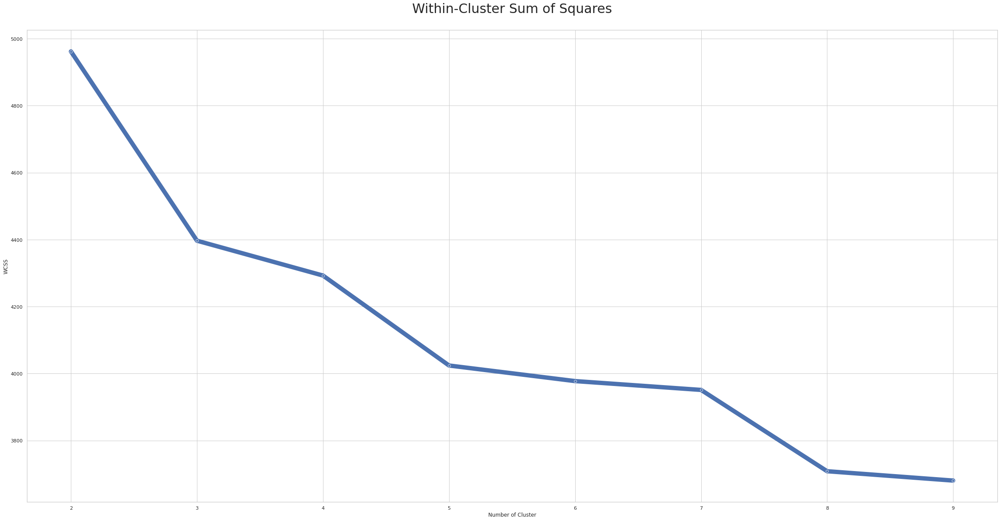

<Figure size 2880x1440 with 0 Axes>

In [1553]:
max_cluster = 10
wcss = []
x = range(2,max_cluster)
X = data_frame_PCA

for k in x:
    kmedoids = KMedoids(n_clusters=k, init='k-medoids++', random_state=5).fit(X)
    wcss.append(kmedoids.inertia_)
    cluster_labels = kmedoids.labels_
    
    # Create a subplot with 1 row and 2 columns
    fig, ax1 = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (k + 1) * 10])
    
    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(
        "For n_clusters =",
        k,
        "The average silhouette_score is :",
        silhouette_avg,
    )
    
    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)
    
    y_lower = 10
    for i in range(k):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / k)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the " + str(k) + " clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    plt.figure()

data_kmedoids_wcss = pd.DataFrame({"Number of Cluster":x,"WCSS":wcss})

plt.title("Within-Cluster Sum of Squares\n", fontsize=30)
sns.lineplot(data=data_kmedoids_wcss, 
             x="Number of Cluster", 
             y="WCSS",
             linewidth=10,
             err_style="bars",
             markers=True,
             marker='o')
plt.figure()

#### DBSCAN

The performance metric we will use for the **DBSCAN** algorithm is the **silhouette score**, note that we will not use the transformed and reduced data since the **DBSCAN** is adapted  at clustering arbitrary shape of data.

In [ ]:
range_eps = np.linspace(0.0001,0.75,100)
X = data_frame_nan_imp
max_samples = round(X.shape[0]**0.5)
min_samples = X.shape[1] + 1
max_cluster = 5

for nb_samples in range(min_samples, max_samples+1):
    for eps in range_eps:
        dbscan = DBSCAN(eps=eps, min_samples=nb_samples).fit(X)
        cluster_labels = dbscan.labels_
        #Number of cluster found
        k = len(set(cluster_labels))
        #Restriction of number of cluster
        if k <= 2 or k >= max_cluster:
            continue

        # Create a subplot with 1 row and 2 columns
        fig, ax1 = plt.subplots(1, 1)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (k + 1) * 10])

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        print(
            "For n_clusters =",
            k,
            "The average silhouette_score is :",
            silhouette_avg,
        )

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(k):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / k)
            ax1.fill_betweenx(
                np.arange(y_lower, y_upper),
                0,
                ith_cluster_silhouette_values,
                facecolor=color,
                edgecolor=color,
                alpha=0.7,
            )

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("Silhouette plot " + str(k) + " clusters - eps = " + str(eps) + " - min_samples = " + str(nb_samples) + "\n")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
        plt.figure()


#### Elbow Method and Silhouettte Score

The different clustering methods (**K-Means**, **K-Medoids** and **DBSCAN**) metrics (**elbow method** and **silhouettte score**) propose optimal value of **3** or **4** clusters, but we will use the smallest value which is 3 clusters to avoid clusters overfitting, and more, the average of the silhouette coefficients is larger for 3 clusters which means that clusters are far away from their neighboring clusters, while for 4 clusters, more observations are wrongly clustered.

Let us visualize those clusters on the world map using **K-Medoids** clustering, since it perfoms better than **K-Means** and we didn't get good result with **DBSCAN**

In [1556]:
nb_optimal_cluster = 3
kmedoids = KMedoids(n_clusters=nb_optimal_cluster, init='k-medoids++', random_state=5).fit(data_frame_PCA)
labels = kmedoids.labels_

data_kmedoids = df2.copy(deep=True).sort_values(by=["Country name", "year"], ascending=True)

data_kmedoids["Cluster"] = kmedoids.labels_

index_last_year = []
for country in countries:
    index_last_year.append(data_kmedoids["year"][data_kmedoids["Country name"] == country].idxmax())

data_kmedoids_last_year = data_kmedoids.iloc[index_last_year]

fig = px.choropleth(data_kmedoids_last_year,
                    locations="Country code",
                    color="Cluster", 
                    hover_name="Country name",
                    color_continuous_scale=px.colors.sequential.Plasma)

fig.show()

data_kmedoids.groupby('Cluster')['Life Ladder'].mean()

Cluster
0    5.411910
1    6.814368
2    4.376607
Name: Life Ladder, dtype: float64

As we can see from the world map, clusters don't depend of the region, indeed the world map clustering differs moderately from the one in [Naive Clustering](#Naive-Clustering) it seems they depend of others factors.

Let us observe now the distribution of the factors regarding our clustering results, note that we already plot the distribution of data in [Histogram](#Histogram) but by clustering using a threshold (mean) on the happiness score

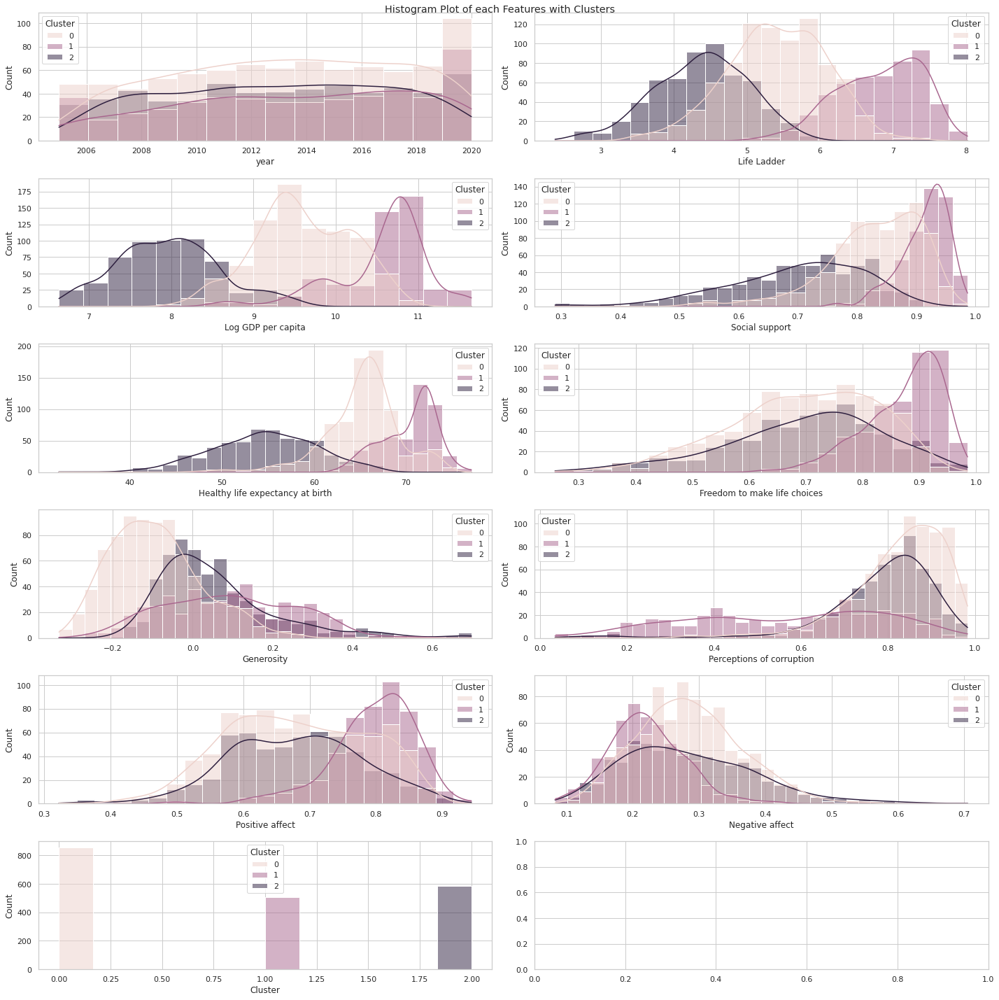

In [1557]:
fig, axes = plt.subplots(6, 2, figsize=(20, 20))
fig.suptitle('Histogram Plot of each Features with Clusters')
for column_name, ax in zip(list(data_kmedoids.describe().columns), axes.flat):
    fig.tight_layout()
    sns.histplot(data=data_kmedoids, x=data_kmedoids[column_name], ax=ax, kde=True, hue="Cluster")

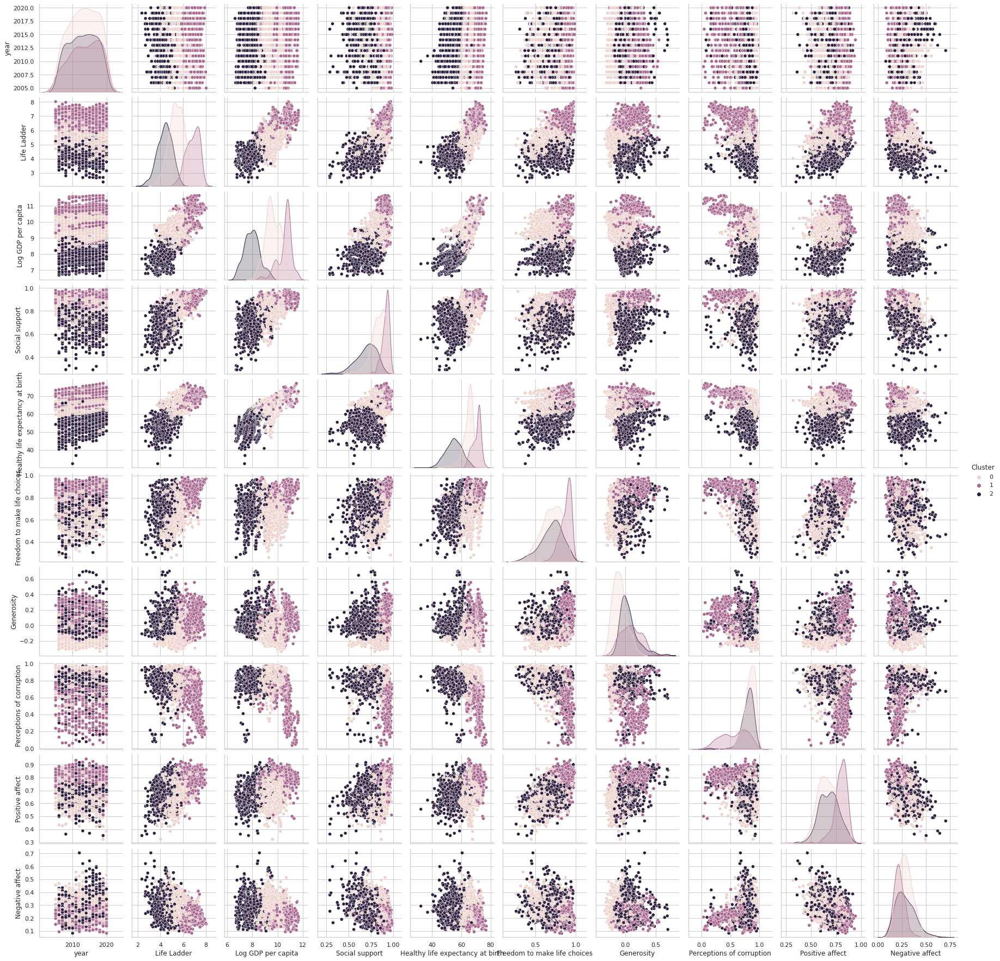

In [1558]:
sns.pairplot(data_kmedoids,hue="Cluster")

From those charts we can still observe (as it was in this [Histogram](#Histogram)) and confirm some trends regarding the **Life Ladder (Happiness score)**, happy countries tend to have higher **Positive affect**, and lower **Negative affect**, higher **Freedom to make life choices** and higher **Healthy life expectancy at birth**, higher **Social support** and higher **GDP per capita** than sadder country.

But we can also see something new, the **Perception of corruption** seems to be low in happier countries

Let's use now some measurements to confirm our observations.

### Regression

In order to measure how the factors can explain the happiness score we will use the regression linear model to fit the happiness score with all the others features, in particular we will use the **Pooled OLS Regression** since it's adapted for data panel. We will also use a regression model based on decision trees (**Extreme Gradient Boosting - XGBoost**).

Note that for the **Pooled OLS Regression** we will not split the data in train, validation and test sets since our goal is to find the interesting insights of the data set. And for the **Extreme Gradient Boosting - XGBoost** we will split the data after the preprocessing data and not before since we will build a model for the features importances and not to predict new raw data.

#### Pooled OLS Regression

In [1559]:
data_frame_OLS_transf = data_frame_transf.copy(deep=True)
data_frame_OLS_transf["year"] = data_frame_original["year"]
data_frame_OLS_transf["Country name"] = data_frame_original["Country name"]

data_frame_OLS_transf = data_frame_OLS_transf.set_index(['Country name','year'])

y = data_frame_OLS_transf["Life Ladder"]
X = data_frame_OLS_transf[['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity','Perceptions of corruption','Positive affect','Negative affect']]

pooled_olsr_model = sm.OLS(endog=y, exog=sm.add_constant(X))
pooled_olsr_model_results = pooled_olsr_model.fit()
pooled_olsr_model_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            Life Ladder   R-squared:                       0.778
Model:                            OLS   Adj. R-squared:                  0.778
Method:                 Least Squares   F-statistic:                     851.9
Date:                Fri, 10 Jun 2022   Prob (F-statistic):               0.00
Time:                        23:58:58   Log-Likelihood:                -1297.0
No. Observations:                1949   AIC:                             2612.
Df Residuals:                    1940   BIC:                             2662.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
====================================================================================================
                                       coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                            -4.248e-16      0.011  -3.97e-14      1.000      -0.021       0.021
Log GDP per capita                   0.3500      0.023     14.965      0.000       0.304       0.396
Social support                       0.2501      0.017     14.520      0.000       0.216       0.284
Healthy life expectancy at birth     0.2080      0.022      9.585      0.000       0.165       0.251
Freedom to make life choices         0.0403      0.016      2.588      0.010       0.010       0.071
Generosity                           0.0543      0.012      4.508      0.000       0.031       0.078
Perceptions of corruption           -0.0614      0.013     -4.815      0.000      -0.086      -0.036
Positive affect                      0.1921      0.014     13.272      0.000       0.164       0.221
Negative affect                      0.0243      0.012      1.992      0.046       0.000       0.048
==============================================================================
Omnibus:                       46.373   Durbin-Watson:                   0.650
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               58.003
Skew:                          -0.297   Prob(JB):                     2.54e-13
Kurtosis:                       3.601   Cond. No.                         5.30
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

##### Adjusted R-squared and Regression coefficients

We can observe an **adjusted R-squared** score of **0.778** which means that **77.8%** of the variation of the **Happiness score** is predictable from the others factors.

And our assumption about the trend of the **Life Ladder (Happiness score)** with the others factors is also almost confirmed, indeed the highest coefficient for the pooled OLS regression modeling of the **Life Ladder (Happiness score)** with the others factors are:

- **Log GDP per capita** (0.3500)
- **Social support** (0.2501)
- **Healthy life expectancy at birth** (0.2080)
- **Positive affect** (0.1921)


#### Extreme Gradient Boosting (XGBoost)

Let us use another regressor based on tree decision to determine the features importances, here we will use he initial data set and not preprocessed one since the **XGBoost** handle missing values.

We will first perform a **K-Fold Cross-Validation** combined with an **Hyperparameters Tuning** to obtain the optimal hyperparameters for the **XGBoost** model

##### K-Fold Cross-Validation and Hyperparameters-Tuning

In [1486]:
df_xgboost = df2.copy(deep=True)

y = df_xgboost["Life Ladder"]
X = df_xgboost[['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity','Perceptions of corruption','Positive affect','Negative affect']]

xgb_model = xgb.XGBRegressor()

param_tuning = {
    'learning_rate': [0.005, 0.01, 0.05, 0.1, 0.15, 0.3],
    'max_depth': [3, 4, 5, 6, 7, 8],
    'min_child_weight': [1, 3],
    'subsample': [0.1,0.25, 0.5, 1],
    'colsample_bytree': [0.3, 1],
    'n_estimators' : [100, 250, 500, 750, 1000],
    'gamma' : [0.0, 0.5],
    'objective': ["reg:squarederror"]
}

clf = GridSearchCV(xgb_model,
                   param_tuning,
                   n_jobs=-1, 
                   scoring='neg_root_mean_squared_error',
                   verbose=4)

clf.fit(X, y)

optimal_xgboost_params = clf.best_params_

'''
The best parameters after a Grid Search CV on:

param_tuning = {
    'learning_rate': [0.005, 0.01, 0.05, 0.1, 0.15, 0.3],
    'max_depth': [3, 4, 5, 6, 7, 8],
    'min_child_weight': [1, 3],
    'subsample': [0.1,0.25, 0.5, 1],
    'colsample_bytree': [0.3, 1],
    'n_estimators' : [100, 250, 500, 750, 1000],
    'gamma' : [0.0, 0.5],
    'objective': ["reg:squarederror"]
}

are:

{'colsample_bytree': 1,
 'gamma': 0.5,
 'learning_rate': 0.005,
 'max_depth': 3,
 'min_child_weight': 1,
 'n_estimators': 1000,
 'objective': 'reg:squarederror',
 'subsample': 0.25}
'''

print("The best parameters after a Grid Search CV are:")
optimal_xgboost_params

Fitting 5 folds for each of 5760 candidates, totalling 28800 fits
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.145 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.052 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.577 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.626 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.070 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-3.172 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-3.118 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.052 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.257 total time=   0.1s
[CV 4/5] END colsample_bytre

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-3.167 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.611 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.536 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.708 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.744 total time=   0.6s
[CV 1/5] END colsample_bytree=

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.285 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.140 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.585 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-1.620 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.728 total time=   0.3s
[CV 4/5] END colsample_bytree=0.

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.775 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.681 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.731 total time=   0.5s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.571 total time=   0.4s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.566 total time=   0.7s
[CV 1/5] END colsample_bytree=0

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-3.172 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.052 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.166 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.140 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.638 total time=   0.1s
[CV 5/5] END colsample_bytree=0

[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-3.118 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.257 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.108 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.161 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.583 total time=   0.1s
[CV 1/5] END colsample_bytree=0

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.161 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.053 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.729 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.629 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-1.539 total time=   0.2s
[CV 3/5] END colsample_bytree=0

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.540 total time=   1.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.071 total time=   0.0s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.285 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.169 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.189 total time=   0.1s
[CV 5/5] END colsample_bytree

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.532 total time=   1.3s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.640 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.553 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.539 total time=   0.3s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.721 total time=   0.3s
[CV 2/5] END colsample_bytree=0.

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.747 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.718 total time=   0.6s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.681 total time=   0.7s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.569 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.585 total time=   1.1s
[CV 4/5] END colsample_bytree=0.3

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.510 total time=   1.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.602 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.721 total time=   0.5s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.698 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.562 total time=   0.6s
[CV 1/5] END colsample_bytree=0.

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.540 total time=   0.3s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.722 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.753 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.578 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.567 total time=   0.8s
[CV 5/5] END colsample_bytree=0

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.162 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.729 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.693 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-1.602 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.528 total time=   0.3s
[CV 3/5] END colsample_bytree=0.3

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.538 total time=   1.5s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.575 total time=   1.7s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.725 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.756 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.684 total time=   0.9s
[CV 3/5] END colsample_bytree=0.

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.629 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-1.600 total time=   0.3s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.589 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.757 total time=   0.5s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.700 total time=   0.7s
[CV 2/5] END colsample_bytree=

[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.577 total time=   1.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.567 total time=   1.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.544 total time=   2.0s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.720 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.729 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, 

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.775 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.700 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.709 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.565 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.518 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, 

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.522 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.534 total time=   0.9s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.576 total time=   0.8s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.742 total time=   0.3s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.672 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, g

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.540 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.565 total time=   0.5s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.500 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.522 total time=   0.6s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.555 total time=   0.8s
[CV 4/5] END colsample_bytree=0.3, gam

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-1.924 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-1.993 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-2.002 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-1.971 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.721 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, 

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-1.912 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-1.977 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.748 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.754 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.743 total time=   0.3s
[CV 4/5] END colsample_bytree=0.3, gam

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-2.079 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-1.993 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-1.919 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-1.988 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-2.050 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, 

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.527 total time=   1.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.532 total time=   1.9s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.723 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.676 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.535 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, 

[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-1.979 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-1.922 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-2.012 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-1.941 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-2.069 total time=   0.1s
[CV 5/5] END colsample_bytree=0.

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.558 total time=   1.6s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-1.914 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-1.913 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.723 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.702 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamm

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.538 total time=   0.9s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.520 total time=   1.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.539 total time=   1.0s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.531 total time=   1.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.559 total time=   1.8s
[CV 5/5] END colsample_bytree=0.

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.762 total time=   0.3s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.701 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.545 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.567 total time=   1.0s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.505 total time=   1.0s
[CV 3/5] END colsample_bytree=0.3, g

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.539 total time=   0.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.569 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.532 total time=   1.0s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.556 total time=   0.9s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.572 total time=   1.3s
[CV 3/5] END colsample_bytree=0.3, 

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.535 total time=   1.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.572 total time=   1.9s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.575 total time=   1.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.543 total time=   3.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.732 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gam

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.564 total time=   1.0s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.555 total time=   0.8s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.591 total time=   1.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.523 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.532 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, g

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.576 total time=   0.7s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.531 total time=   0.8s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.587 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.525 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.580 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, 

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.547 total time=   0.6s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.563 total time=   0.8s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.575 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.568 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.568 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, 

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.572 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.566 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.553 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.587 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.565 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3,

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.558 total time=   0.3s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.510 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.578 total time=   0.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.582 total time=   0.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.546 total time=   0.5s
[CV 1/5] END colsample_bytree=0.3, g

[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.585 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.559 total time=   0.6s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.565 total time=   1.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.526 total time=   1.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.545 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3,

[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.595 total time=   0.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.542 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.560 total time=   0.7s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.534 total time=   0.9s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.590 total time=   0.8s
[CV 4/5] END colsample_bytree=0.3,

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.547 total time=   0.8s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.609 total time=   0.7s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.562 total time=   1.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.576 total time=   0.9s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.594 total time=   1.3s
[CV 4/5] END colsample_bytree=0.3,

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.577 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.552 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.571 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.585 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.576 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.574 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.582 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.565 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.512 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.585 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, gam

[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.578 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.545 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.539 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.585 total time=   0.6s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.564 total time=   0.9s
[CV 4/5] END colsample_bytree=0.3, g

[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.593 total time=   1.8s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.540 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.591 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.587 total time=   0.7s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.539 total time=   1.1s
[CV 5/5] END colsample_bytree=0.3, ga

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.535 total time=   0.6s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.560 total time=   0.7s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.543 total time=   1.0s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.605 total time=   0.8s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.548 total time=   1.1s
[CV 1/5] END colsample_bytree=0.3, 

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.506 total time=   1.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.580 total time=   1.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.579 total time=   1.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.636 total time=   1.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.572 total time=   2.0s
[CV 1/5] END colsample_bytree=0.3, g

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.565 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.553 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.542 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.518 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.608 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamma=

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.627 total time=   0.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.599 total time=   0.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.568 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.575 total time=   0.7s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.555 total time=   0.8s
[CV 1/5] END colsample_bytree=0.3, gam

[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.655 total time=   0.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.569 total time=   0.8s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.597 total time=   0.8s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.525 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.541 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, gamma

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.594 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.576 total time=   0.5s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.540 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.618 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.612 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, gamma=

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.552 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.619 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.616 total time=   0.4s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.566 total time=   0.6s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.563 total time=   0.6s
[CV 4/5] END colsample_bytree=0.3, gamma

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.676 total time=   0.7s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.545 total time=   1.0s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.565 total time=   1.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.577 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.632 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.600 total time=   1.0s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.555 total time=   1.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.576 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.594 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.546 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, 

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.578 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.665 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.580 total time=   1.0s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.625 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.599 total time=   1.0s
[CV 1/5] END colsample_bytree=0.3, gamm

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.607 total time=   0.6s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.582 total time=   0.8s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.607 total time=   0.7s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.588 total time=   1.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.628 total time=   0.9s
[CV 2/5] END colsample_bytree=0.3, gamma

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.616 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.609 total time=   0.4s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.622 total time=   0.5s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.575 total time=   0.9s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.586 total time=   1.0s
[CV 4/5] END colsample_bytree=0.3, gamma=

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.560 total time=   1.9s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.551 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.591 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.572 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.525 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0,

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.563 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.611 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.571 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.547 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.570 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gam

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.550 total time=   0.9s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.669 total time=   0.7s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.576 total time=   1.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.639 total time=   1.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.619 total time=   1.4s
[CV 5/5] END colsample_bytree=0.3, gamm

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.533 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.531 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.622 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.570 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.568 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gam

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.603 total time=   0.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.600 total time=   0.4s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.601 total time=   0.5s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.588 total time=   0.6s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.647 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, ga

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.583 total time=   0.4s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.581 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.603 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.605 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.592 total time=   0.9s
[CV 4/5] END colsample_bytree=0.3, g

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.648 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.625 total time=   0.4s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.551 total time=   0.5s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.618 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.619 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, 

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.609 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.542 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.671 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.567 total time=   0.5s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.542 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, g

[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.618 total time=   0.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.664 total time=   0.5s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.575 total time=   0.9s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.546 total time=   0.9s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.605 total time=   0.9s
[CV 1/5] END colsample_bytree=0.3, 

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.638 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.630 total time=   0.5s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.607 total time=   0.6s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.569 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.621 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, g

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.609 total time=   0.5s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.578 total time=   0.7s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.678 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.585 total time=   1.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.702 total time=   0.8s
[CV 2/5] END colsample_bytree=0.3, 

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.575 total time=   0.9s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.568 total time=   1.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.708 total time=   0.9s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.580 total time=   1.6s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.623 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3,

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.678 total time=   0.9s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.581 total time=   1.6s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.528 total time=   1.7s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.561 total time=   0.4s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.589 total time=   0.6s
[CV 4/5] END colsample_bytree=0.3, 

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.532 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.611 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.635 total time=   0.7s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.731 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.618 total time=   0.9s
[CV 1/5] END colsample_bytree=0.3, 

[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.596 total time=   0.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.620 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.569 total time=   1.0s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.679 total time=   0.8s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.610 total time=   1.3s
[CV 5/5] END colsample_bytree=0.3, gam

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.554 total time=   0.5s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.653 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.618 total time=   0.9s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.601 total time=   0.9s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.592 total time=   1.0s
[CV 2/5] END colsample_bytree=0.3, gam

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.579 total time=   0.5s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.672 total time=   0.6s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.602 total time=   0.8s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.555 total time=   1.0s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.708 total time=   0.9s
[CV 2/5] END colsample_bytree=0.3, g

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.547 total time=   0.6s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.586 total time=   0.8s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.572 total time=   1.0s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.688 total time=   0.9s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.625 total time=   1.4s
[CV 4/5] END colsample_bytree=0.3, g

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.548 total time=   1.5s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.624 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.598 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.781 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.595 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.595 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.582 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.680 total time=   0.5s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.625 total time=   0.6s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-1.035 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.661 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.603 total time=   0.6s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.630 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.647 total time=   0.8s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.587 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.604 total time=   0.5s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.672 total time=   0.5s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.569 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.876 total time=   0.5s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.615 total time=   0.8s
[CV 4/5] END colsample_bytree=0.3, gamm

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-1.047 total time=   0.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.619 total time=   0.8s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-1.121 total time=   0.7s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.669 total time=   0.9s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.610 total time=   1.1s
[CV 1/5] END colsample_bytree=0.3, gam

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.781 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.670 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.788 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.682 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.628 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamm

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.589 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-1.154 total time=   0.6s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.632 total time=   0.7s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.602 total time=   1.0s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-1.450 total time=   0.8s
[CV 2/5] END colsample_bytree=0.3, gamma

[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-1.266 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.655 total time=   1.0s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.569 total time=   1.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.736 total time=   1.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.580 total time=   1.3s
[CV 2/5] END colsample_bytree=0.3, gamma=

[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.669 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.631 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.574 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.031 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.612 total time=   0.4s
[CV 1/5] END colsample_bytree=0.3, gamma=

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.664 total time=   0.9s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.586 total time=   1.0s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.740 total time=   1.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.634 total time=   1.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.845 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gam

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.682 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.580 total time=   0.8s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-1.482 total time=   0.7s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.658 total time=   1.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.542 total time=   0.9s
[CV 2/5] END colsample_bytree=0.3, gamma=0.

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.627 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.540 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.713 total time=   0.3s
[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.629 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-1.261 total time=   0.5s
[CV 1/5] END colsample_bytree=0.3, gamma=

[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.722 total time=   1.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.709 total time=   1.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.706 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.629 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.664 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, g

[CV 4/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-1.262 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.626 total time=   0.9s
[CV 5/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.629 total time=   0.7s
[CV 3/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.659 total time=   1.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.616 total time=   0.7s
[CV 2/5] END colsample_bytree=0.3, gamma=0.

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.256 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.052 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.577 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.552 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-1.600 total time=   0.2s
[CV 2/5] END colsample_bytree=0

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.161 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.635 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.551 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.598 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.715 total time=   0.3s
[CV 4/5] END colsample_bytree=0.

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.533 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.558 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.564 total time=   0.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.530 total time=   0.8s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.569 total time=   1.1s
[CV 4/5] END colsample_bytree=

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.677 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.561 total time=   0.6s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.532 total time=   0.8s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.543 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.532 total time=   0.8s
[CV 4/5] END colsample_bytre

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-1.677 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.526 total time=   0.3s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.697 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.693 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.575 total time=   0.4s
[CV 2/5] END colsample_bytree=0

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.568 total time=   0.7s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.557 total time=   1.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.563 total time=   1.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.565 total time=   1.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-3.118 total time=   0.1s
[CV 3/5] END colsample_bytr

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.727 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.627 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.538 total time=   0.3s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.711 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.715 total time=   0.6s
[CV 4/5] END colsample_bytree=0

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.565 total time=   1.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.162 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.584 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-1.549 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.655 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, 

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.680 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.563 total time=   0.8s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.583 total time=   1.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.518 total time=   1.0s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.534 total time=   1.5s
[CV 5/5] END colsample_bytree=0

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.719 total time=   0.5s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.696 total time=   0.7s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.554 total time=   0.6s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.581 total time=   1.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.575 total time=   1.3s
[CV 4/5] END colsample_bytree=0

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.679 total time=   0.8s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.534 total time=   0.9s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.583 total time=   1.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.520 total time=   0.9s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.535 total time=   1.6s
[CV 5/5] END colsample_bytree=0

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.715 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.747 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.679 total time=   0.8s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.569 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.561 total time=   1.4s
[CV 2/5] END colsample_bytree=0.3

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.539 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.780 total time=   0.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.684 total time=   0.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.721 total time=   0.9s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.581 total time=   0.9s
[CV 4/5] END colsample_bytree=0.

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.535 total time=   1.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.567 total time=   2.0s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.775 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.719 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.686 total time=   0.2s
[CV 5/5] END colsample_bytree=

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.570 total time=   1.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.524 total time=   0.9s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.516 total time=   1.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.536 total time=   2.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.691 total time=   0.3s
[CV 2/5] END colsample_bytree

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.506 total time=   1.0s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.707 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.518 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.535 total time=   0.5s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.569 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-1.979 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.737 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.736 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.681 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.524 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, g

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.530 total time=   0.4s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.561 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.519 total time=   0.5s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.556 total time=   0.8s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.502 total time=   1.1s
[CV 5/5] END colsample_bytree=0.3, gam

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.517 total time=   1.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-1.993 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-2.068 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-1.930 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-1.912 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, 

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.527 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.565 total time=   0.9s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.526 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.554 total time=   1.3s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.506 total time=   1.4s
[CV 2/5] END colsample_bytree=0.3

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.523 total time=   0.7s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.531 total time=   1.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.571 total time=   1.4s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.710 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.568 total time=   0.5s
[CV 4/5] END colsample_bytree=0.3, 

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.524 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.568 total time=   1.0s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.531 total time=   1.5s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.718 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.693 total time=   0.3s
[CV 3/5] END colsample_bytree=0.

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.743 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.685 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.569 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.517 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.534 total time=   0.8s
[CV 5/5] END colsample_bytree=0.3, 

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.560 total time=   0.8s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.539 total time=   1.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.569 total time=   1.4s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-1.922 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-1.993 total time=   0.1s
[CV 2/5] END colsample_bytree

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.524 total time=   0.8s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.556 total time=   1.3s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.570 total time=   1.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.555 total time=   1.7s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.507 total time=   1.9s
[CV 4/5] END colsample_bytree=0.3, ga

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.729 total time=   0.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.564 total time=   0.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.544 total time=   0.8s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.556 total time=   0.7s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.530 total time=   1.0s
[CV 5/5] END colsample_bytree=0.3, g

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.745 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.704 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.685 total time=   0.4s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.570 total time=   0.5s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.518 total time=   0.7s
[CV 2/5] END colsample_bytree=0.3

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.571 total time=   1.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.533 total time=   2.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.757 total time=   0.3s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.747 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.676 total time=   0.4s
[CV 1/5] END colsample_bytree=0.3, 

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.566 total time=   1.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.535 total time=   1.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.569 total time=   1.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.572 total time=   1.4s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.538 total time=   2.5s
[CV 2/5] END colsample_bytree=0.3, gam

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.569 total time=   0.5s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.528 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.594 total time=   0.5s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.588 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.528 total time=   0.8s
[CV 2/5] END colsample_bytree=0.

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.522 total time=   1.0s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.535 total time=   1.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.564 total time=   1.0s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.538 total time=   1.8s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.570 total time=   2.4s
[CV 5/5] END colsample_bytree=0.3, 

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.582 total time=   0.7s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.544 total time=   0.6s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.552 total time=   1.0s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.512 total time=   0.8s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.578 total time=   1.2s
[CV 3/5] END colsample_bytree=0.3, 

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.534 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.576 total time=   0.3s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.542 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.580 total time=   0.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.529 total time=   0.5s
[CV 1/5] END colsample_bytree=0.3, 

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.581 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.543 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.590 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.530 total time=   1.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.493 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, 

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.579 total time=   1.0s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.597 total time=   0.8s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.594 total time=   1.0s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.529 total time=   1.3s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.529 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, 

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.493 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.576 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.548 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.507 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.568 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, gam

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.533 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.562 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.578 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.586 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.575 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, g

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.552 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.592 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.548 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.574 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.531 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.579 total time=   0.6s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.537 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.569 total time=   0.9s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.572 total time=   0.9s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.558 total time=   1.3s
[CV 5/5] END colsample_bytree=0.3, g

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.562 total time=   1.4s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.533 total time=   2.0s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.573 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.552 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.534 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, 

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.531 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.601 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.555 total time=   1.0s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.587 total time=   1.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.589 total time=   1.1s
[CV 2/5] END colsample_bytree=0.3, g

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.548 total time=   1.6s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.587 total time=   2.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.537 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.563 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.494 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.577 total time=   1.5s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.584 total time=   2.0s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.588 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.526 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.584 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, ga

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.557 total time=   2.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.581 total time=   2.0s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.565 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.564 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.580 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, gamm

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.631 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.555 total time=   0.9s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.576 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.547 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.588 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gam

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.527 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.535 total time=   0.5s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.636 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.559 total time=   0.8s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.586 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, gamma=0.

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.560 total time=   0.9s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.521 total time=   0.8s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.617 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.538 total time=   1.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.533 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.589 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.557 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.613 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.567 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.572 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamm

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.585 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.571 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.573 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.590 total time=   0.3s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.589 total time=   0.4s
[CV 1/5] END colsample_bytree=0.3, gamm

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.550 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.518 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.573 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.607 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.540 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, gamma=0.

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.584 total time=   0.4s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.594 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.598 total time=   0.7s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.578 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.566 total time=   1.1s
[CV 4/5] END colsample_bytree=0.3, gamma=

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.564 total time=   0.4s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.604 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.542 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.526 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.653 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, gamma=

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.564 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.574 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.575 total time=   0.8s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.585 total time=   0.9s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.551 total time=   1.0s
[CV 2/5] END colsample_bytree=0.3, gamma=0.

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.572 total time=   1.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.585 total time=   1.5s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.552 total time=   1.4s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.553 total time=   1.9s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.589 total time=   0.3s
[CV 4/5] END colsample_bytree=0.3, gamma=

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.583 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.564 total time=   0.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.584 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.625 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.604 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, gamma

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.607 total time=   0.8s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.574 total time=   1.0s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.603 total time=   0.8s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.571 total time=   1.5s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.585 total time=   1.5s
[CV 3/5] END colsample_bytree=0.3, gamma=0.

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.596 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.579 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.542 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.559 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.571 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.596 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.607 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.580 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.567 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.528 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, g

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.526 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.579 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.574 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.527 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.603 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, gam

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.600 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.578 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.568 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.582 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.518 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, g

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.641 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.612 total time=   0.8s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.612 total time=   0.7s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.603 total time=   1.0s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.520 total time=   1.0s
[CV 2/5] END colsample_bytree=0.3

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.540 total time=   0.9s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.601 total time=   1.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.535 total time=   1.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.579 total time=   1.0s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.571 total time=   1.5s
[CV 5/5] END colsample_bytree=0.3, ga

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.653 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.550 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.535 total time=   0.6s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.672 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.554 total time=   0.9s
[CV 5/5] END colsample_bytree=0.3, g

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.518 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.608 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.606 total time=   0.9s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.607 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.573 total time=   1.2s
[CV 4/5] END colsample_bytree=0.3,

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.580 total time=   0.1s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.567 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.599 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.584 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.563 total time=   0.3s
[CV 4/5] END colsample_bytree=0.3, 

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.564 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.536 total time=   0.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.641 total time=   0.4s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.579 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.647 total time=   0.6s
[CV 2/5] END colsample_bytree=0.3, g

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.680 total time=   1.0s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.573 total time=   1.8s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.600 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.633 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.617 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.593 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.569 total time=   0.9s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.634 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.577 total time=   1.3s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.520 total time=   1.3s
[CV 4/5] END colsample_bytree=0.3, gam

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.581 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.593 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.600 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.597 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.600 total time=   0.2s
[CV 5/5] END colsample_bytree=0.

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.564 total time=   1.0s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.691 total time=   0.9s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.618 total time=   1.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.544 total time=   1.5s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.587 total time=   1.5s
[CV 4/5] END colsample_bytree=0.3,

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.649 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.572 total time=   0.3s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.770 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.601 total time=   0.4s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.834 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamm

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.620 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.547 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.635 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.567 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.820 total time=   0.5s
[CV 5/5] END colsample_bytree=0.3, gamma

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.882 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.614 total time=   0.8s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.604 total time=   0.8s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.655 total time=   0.8s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.567 total time=   1.0s
[CV 4/5] END colsample_bytree=0.3, gamma=

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.594 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.827 total time=   0.2s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.596 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.563 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.644 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0

[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.606 total time=   0.3s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.629 total time=   0.4s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.597 total time=   0.5s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.941 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.631 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.663 total time=   0.3s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.649 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-1.086 total time=   0.4s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.655 total time=   0.7s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.601 total time=   0.6s
[CV 3/5] END colsample_bytree=0.3, gamma=

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.605 total time=   0.2s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.964 total time=   0.2s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.674 total time=   0.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.605 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.907 total time=   0.5s
[CV 2/5] END colsample_bytree=0.3, gamma=0.

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.572 total time=   1.3s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.655 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.655 total time=   0.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.585 total time=   0.2s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.608 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma

[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.618 total time=   1.1s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.542 total time=   1.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.683 total time=   1.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.651 total time=   1.4s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.583 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamm

[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.568 total time=   1.5s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.610 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.658 total time=   0.4s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.574 total time=   0.4s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-1.125 total time=   0.4s
[CV 4/5] END colsample_bytree=0.3, gamma=0

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.671 total time=   0.7s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.558 total time=   0.9s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-1.397 total time=   0.8s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.591 total time=   1.3s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-1.318 total time=   1.0s
[CV 1/5] END colsample_bytree=0.3, gamma

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-1.369 total time=   1.0s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.594 total time=   1.7s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.526 total time=   1.8s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.553 total time=   0.4s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.625 total time=   0.5s
[CV 3/5] END colsample_bytree=0.3, gamma=

[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.763 total time=   0.1s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.844 total time=   0.1s
[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.597 total time=   0.1s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.598 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.599 total time=   0.2s
[CV 1/5] END colsample_bytree=0.3, gamma=

[CV 3/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.663 total time=   0.7s
[CV 1/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.589 total time=   1.0s
[CV 4/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-1.354 total time=   0.9s
[CV 2/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.636 total time=   1.5s
[CV 5/5] END colsample_bytree=0.3, gamma=0.5, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.619 total time=   1.6s
[CV 5/5] END colsample_bytree=0.3, gamma=0.

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-1.515 total time=   0.5s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.717 total time=   0.4s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.651 total time=   0.7s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.693 total time=   1.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.551 total time=   1.1s
[CV 4/5] END colsample_bytree=1, gamma=0

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.076 total time=   0.1s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.264 total time=   0.1s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.141 total time=   0.1s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.178 total time=   0.1s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.131 total time=   0.1s
[CV 1/5] END colsample_bytree=1, gamma=0

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.049 total time=   0.3s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.159 total time=   0.3s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.135 total time=   0.3s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.610 total time=   0.3s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.596 total time=   0.4s
[CV 2/5] END colsample_bytree=1, gamma=0.

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.654 total time=   0.9s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.734 total time=   0.9s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.652 total time=   1.4s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.548 total time=   0.8s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.502 total time=   1.4s
[CV 2/5] END colsample_bytree=1, gamma=0

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.733 total time=   1.3s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.654 total time=   1.9s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.547 total time=   2.1s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.512 total time=   2.6s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.522 total time=   2.7s
[CV 1/5] END colsample_bytree=1, gamma=0.0,

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.132 total time=   0.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.045 total time=   0.4s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.150 total time=   0.4s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.620 total time=   0.3s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.596 total time=   0.4s
[CV 4/5] END colsample_bytree=1, gamma=0.0,

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.552 total time=   3.5s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.501 total time=   4.7s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.677 total time=   0.7s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.709 total time=   1.7s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.544 total time=   1.1s
[CV 4/5] END colsample_bytree=1, gamma=0

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.694 total time=   0.7s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.675 total time=   1.1s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.661 total time=   1.7s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.582 total time=   1.1s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.571 total time=   1.8s
[CV 5/5] END colsample_bytree=1, gamma

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.536 total time=   0.6s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.519 total time=   1.5s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.744 total time=   0.8s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.681 total time=   1.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.710 total time=   2.6s
[CV 1/5] END colsample_bytree=1, gamma=0.0

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.695 total time=   0.7s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.731 total time=   0.7s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.667 total time=   1.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.717 total time=   2.7s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.507 total time=   2.0s
[CV 2/5] END colsample_bytree=1, gamma=0

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.559 total time=   2.1s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.550 total time=   4.7s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.575 total time=   1.8s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.533 total time=   4.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.512 total time=   6.3s
[CV 2/5] END colsample_bytree=1, gamma=0

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.733 total time=   0.7s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.677 total time=   2.0s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.676 total time=   2.9s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.559 total time=   3.4s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.530 total time=   1.6s
[CV 4/5] END colsample_bytree=1, gamma=0.

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.557 total time=   2.0s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.556 total time=   4.7s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.571 total time=   1.7s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.534 total time=   4.4s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.513 total time=   6.8s
[CV 3/5] END colsample_bytree=1, gamma=0

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-1.525 total time=   0.9s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.697 total time=   0.9s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.768 total time=   1.0s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.688 total time=   1.4s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.723 total time=   3.3s
[CV 3/5] END colsample_bytree=1, gamma=0.

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.548 total time=   2.1s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-1.944 total time=   0.1s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-2.080 total time=   0.1s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-1.985 total time=   0.1s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-1.997 total time=   0.1s
[CV 5/5] END colsample_bytree=1, gamma=0.0, 

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.568 total time=   1.4s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.554 total time=   2.5s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.728 total time=   0.4s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.694 total time=   0.6s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.691 total time=   0.7s
[CV 4/5] END colsample_bytree=1, gamma=0.0, l

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-1.925 total time=   0.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-1.962 total time=   0.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-1.888 total time=   0.3s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.745 total time=   0.3s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.708 total time=   0.4s
[CV 1/5] END colsample_bytree=1, gamma=0.0, l

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.543 total time=   0.7s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.490 total time=   1.0s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.523 total time=   0.7s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.484 total time=   1.0s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.549 total time=   1.8s
[CV 1/5] END colsample_bytree=1, gamma=0.0, l

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.496 total time=   2.7s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-1.925 total time=   0.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-1.966 total time=   0.4s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-1.890 total time=   0.4s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.697 total time=   0.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, l

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.674 total time=   0.9s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.741 total time=   1.1s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.573 total time=   0.7s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.529 total time=   1.6s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.532 total time=   1.0s
[CV 4/5] END colsample_bytree=1, gamma=0.0, lea

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.535 total time=   3.6s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-1.945 total time=   0.1s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-2.080 total time=   0.1s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-1.985 total time=   0.1s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-1.997 total time=   0.1s
[CV 5/5] END colsample_bytree=1, gamma=0.0, 

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.553 total time=   1.7s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.587 total time=   2.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.553 total time=   2.6s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.595 total time=   3.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.556 total time=   3.5s
[CV 5/5] END colsample_bytree=1, gamma=0.0, lear

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.500 total time=   0.8s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.559 total time=   2.0s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.593 total time=   2.8s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.534 total time=   3.2s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.508 total time=   4.3s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learn

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.535 total time=   2.0s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.530 total time=   1.1s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.498 total time=   1.2s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.578 total time=   1.9s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.530 total time=   3.9s
[CV 2/5] END colsample_bytree=1, gamma=0.0, le

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.532 total time=   2.3s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.510 total time=   3.1s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.584 total time=   2.4s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.530 total time=   4.7s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.559 total time=   3.2s
[CV 5/5] END colsample_bytree=1, gamma=0.0, le

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.562 total time=   1.9s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.536 total time=   3.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.540 total time=   6.1s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.757 total time=   0.4s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.678 total time=   0.6s
[CV 1/5] END colsample_bytree=1, gamma=0.0

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.565 total time=   3.9s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.584 total time=   5.6s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-1.902 total time=   0.3s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-1.973 total time=   0.3s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-1.962 total time=   0.5s
[CV 1/5] END colsample_bytree=1, gamma=0.0, 

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-2.048 total time=   0.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-1.969 total time=   0.2s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-1.987 total time=   0.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-2.049 total time=   0.3s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-1.910 total time=   0.3s
[CV 2/5] END colsample_bytree=1, gamma=0.0

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.584 total time=   4.0s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.532 total time=   2.0s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.546 total time=   3.5s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.571 total time=   7.2s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.550 total time=   0.6s
[CV 2/5] END colsample_bytree=1, gamma=0.0, l

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.577 total time=   1.0s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.573 total time=   0.7s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.500 total time=   1.1s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.561 total time=   1.8s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.601 total time=   0.9s
[CV 2/5] END colsample_bytree=1, gamma=0.0, l

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.591 total time=   1.8s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.503 total time=   1.4s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.556 total time=   2.4s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.532 total time=   0.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.556 total time=   0.3s
[CV 2/5] END colsample_bytree=1, gamma=0.0, l

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.559 total time=   2.4s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.592 total time=   1.9s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.596 total time=   2.8s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.535 total time=   0.2s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.530 total time=   0.3s
[CV 4/5] END colsample_bytree=1, gamma=0.0,

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.509 total time=   2.1s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.584 total time=   3.2s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.542 total time=   0.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.549 total time=   0.5s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.555 total time=   0.7s
[CV 3/5] END colsample_bytree=1, gamma=0.0,

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.578 total time=   2.0s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.517 total time=   2.2s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.514 total time=   1.8s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.585 total time=   3.1s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.627 total time=   1.6s
[CV 3/5] END colsample_bytree=1, gamma=0.0, lea

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.613 total time=   3.2s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.551 total time=   1.0s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.504 total time=   0.8s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.575 total time=   1.9s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.547 total time=   1.2s
[CV 4/5] END colsample_bytree=1, gamma=0.0, lear

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.551 total time=   2.1s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.531 total time=   1.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.592 total time=   1.8s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.600 total time=   2.6s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.576 total time=   1.7s
[CV 4/5] END colsample_bytree=1, gamma=0.0,

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.524 total time=   2.6s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.609 total time=   1.6s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.576 total time=   2.5s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.563 total time=   4.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.569 total time=   0.6s
[CV 3/5] END colsample_bytree=1, gamma=0.0, l

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.601 total time=   1.4s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.566 total time=   2.5s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.556 total time=   2.1s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.525 total time=   3.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.600 total time=   1.7s
[CV 2/5] END colsample_bytree=1, gamma=0.0, 

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.515 total time=   0.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.519 total time=   0.5s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.588 total time=   0.8s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.551 total time=   1.5s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.526 total time=   1.0s
[CV 2/5] END colsample_bytree=1, gamma=0.0, lear

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.520 total time=   1.5s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.593 total time=   1.6s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.560 total time=   3.0s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.562 total time=   2.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.521 total time=   4.3s
[CV 3/5] END colsample_bytree=1, gamma=0.0, lea

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.556 total time=   0.8s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.513 total time=   1.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.559 total time=   1.0s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.587 total time=   1.7s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.551 total time=   3.1s
[CV 4/5] END colsample_bytree=1, gamma=0.0, l

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.521 total time=   3.0s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.589 total time=   5.1s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.557 total time=   3.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.522 total time=   5.6s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.573 total time=   0.1s
[CV 2/5] END colsample_bytree=1, gamma=0.0,

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.612 total time=   2.8s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.559 total time=   5.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.566 total time=   3.7s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.536 total time=   6.9s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.533 total time=   0.5s
[CV 1/5] END colsample_bytree=1, gamma=0.0, le

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.598 total time=   0.6s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.542 total time=   0.7s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.596 total time=   1.0s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.559 total time=   1.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.594 total time=   1.1s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.602 total time=   0.7s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.561 total time=   1.5s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.629 total time=   0.9s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.605 total time=   0.9s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.567 total time=   2.1s
[CV 1/5] END colsample_bytree=1, gamma=0.0, lea

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.595 total time=   0.5s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.554 total time=   0.7s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.613 total time=   0.6s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.624 total time=   1.0s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.610 total time=   1.4s
[CV 3/5] END colsample_bytree=1, gamma=0.0, lear

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.560 total time=   1.4s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.591 total time=   2.4s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.570 total time=   1.9s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.526 total time=   2.8s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.572 total time=   0.2s
[CV 5/5] END colsample_bytree=1, gamma=0.0, lea

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.527 total time=   2.4s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.615 total time=   1.9s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.574 total time=   3.3s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.688 total time=   0.4s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.579 total time=   0.6s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learni

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.596 total time=   0.6s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.559 total time=   1.0s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.553 total time=   0.8s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.606 total time=   1.8s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.616 total time=   2.3s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.622 total time=   0.5s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.525 total time=   0.7s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.598 total time=   1.1s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.619 total time=   0.9s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.614 total time=   1.5s
[CV 1/5] END colsample_bytree=1, gamma=0.0, lear

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.577 total time=   1.1s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.602 total time=   1.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.562 total time=   2.2s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.521 total time=   2.6s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.581 total time=   2.2s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.560 total time=   5.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.518 total time=   0.5s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.518 total time=   0.4s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.627 total time=   0.7s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.549 total time=   1.4s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_r

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.599 total time=   0.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.620 total time=   0.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.582 total time=   0.2s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.534 total time=   0.2s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.637 total time=   0.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learni

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.540 total time=   0.7s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.654 total time=   0.7s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.589 total time=   1.0s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.543 total time=   1.8s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.593 total time=   1.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.600 total time=   0.9s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.545 total time=   1.0s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.555 total time=   1.5s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.602 total time=   1.8s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.547 total time=   3.0s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.594 total time=   0.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.522 total time=   0.5s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.530 total time=   0.5s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.528 total time=   0.7s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.599 total time=   0.9s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learni

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.602 total time=   1.8s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.540 total time=   3.4s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.691 total time=   1.6s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.541 total time=   4.2s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.605 total time=   4.0s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.584 total time=   1.5s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.636 total time=   1.0s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.652 total time=   1.0s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.616 total time=   2.0s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.621 total time=   2.4s
[CV 3/5] END colsample_bytree=1, gamma=0.0,

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.579 total time=   0.2s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.548 total time=   0.4s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.594 total time=   0.5s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.604 total time=   0.6s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.575 total time=   1.0s
[CV 4/5] END colsample_bytree=1, gamma=0.0, le

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.624 total time=   0.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.535 total time=   0.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.538 total time=   0.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.647 total time=   0.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.556 total time=   0.5s
[CV 2/5] END colsample_bytree=1, gamma=0.0, l

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.583 total time=   2.4s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.580 total time=   0.3s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.602 total time=   0.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.554 total time=   0.5s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.560 total time=   0.7s
[CV 1/5] END colsample_bytree=1, gamma=0.0, lea

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.662 total time=   0.6s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.575 total time=   1.4s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.674 total time=   0.9s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.646 total time=   1.5s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.619 total time=   2.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, 

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.598 total time=   1.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.642 total time=   0.9s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.595 total time=   2.1s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.608 total time=   2.4s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.597 total time=   3.2s
[CV 5/5] END colsample_bytree=1, gamma=0.0, lear

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.573 total time=   3.5s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.617 total time=   0.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.673 total time=   0.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.587 total time=   0.2s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.587 total time=   0.2s
[CV 5/5] END colsample_bytree=1, gamma=0.0, 

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.550 total time=   4.1s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.560 total time=   1.3s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.646 total time=   0.9s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.605 total time=   2.2s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.620 total time=   2.6s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learni

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.643 total time=   0.2s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.569 total time=   0.3s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.570 total time=   0.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.565 total time=   0.4s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.509 total time=   0.4s
[CV 5/5] END colsample_bytree=1, gamma=0.0,

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.594 total time=   3.9s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.616 total time=   0.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.655 total time=   0.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.608 total time=   0.2s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.571 total time=   0.2s
[CV 5/5] END colsample_bytree=1, gamma=0.0, 

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.696 total time=   2.2s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.640 total time=   3.6s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.549 total time=   3.3s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.550 total time=   0.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.647 total time=   0.5s
[CV 2/5] END colsample_bytree=1, gamma=0.0, l

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.688 total time=   1.8s[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.622 total time=   3.4s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.636 total time=   0.8s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.560 total time=   1.5s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.555 total time=   1.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, le

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.669 total time=   1.6s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.557 total time=   3.8s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.537 total time=   3.1s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.564 total time=   3.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.559 total time=   3.4s
[CV 4/5] END colsample_bytree=1, gamma=0.0, le

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.615 total time=   1.8s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.700 total time=   1.3s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.635 total time=   2.1s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.543 total time=   2.9s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.570 total time=   3.0s
[CV 4/5] END colsample_bytree=1, gamma=0.0, l

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.716 total time=   0.2s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.698 total time=   0.4s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.574 total time=   0.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.837 total time=   0.5s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.639 total time=   1.0s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learnin

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.546 total time=   0.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.568 total time=   0.3s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.769 total time=   0.3s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.571 total time=   0.4s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.578 total time=   0.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.656 total time=   0.4s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.629 total time=   0.5s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.804 total time=   0.5s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.634 total time=   0.8s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.677 total time=   1.1s
[CV 3/5] END colsample_bytree=1, gamma=0.0, lear

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-1.079 total time=   1.0s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-1.051 total time=   1.1s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.620 total time=   2.1s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-1.180 total time=   1.2s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-1.243 total time=   1.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, lear

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.554 total time=   0.7s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-1.072 total time=   0.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.659 total time=   1.0s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.647 total time=   1.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-1.158 total time=   0.9s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learnin

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.834 total time=   0.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.795 total time=   0.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.797 total time=   0.2s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.774 total time=   0.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.662 total time=   0.3s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learn

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.573 total time=   0.4s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.957 total time=   0.4s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.734 total time=   0.6s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.578 total time=   1.2s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.656 total time=   1.3s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.573 total time=   1.3s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.691 total time=   1.5s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.549 total time=   2.0s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-1.406 total time=   1.4s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.626 total time=   2.2s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learni

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.669 total time=   0.7s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.546 total time=   1.1s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-1.159 total time=   0.9s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.602 total time=   1.4s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.569 total time=   1.9s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learni

[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.013 total time=   0.4s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.603 total time=   0.7s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.620 total time=   1.2s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-1.285 total time=   0.9s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.613 total time=   2.1s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learnin

[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.675 total time=   3.0s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.620 total time=   2.5s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.596 total time=   0.6s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.625 total time=   0.7s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.634 total time=   0.9s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learni

[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.626 total time=   2.0s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.626 total time=   0.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.670 total time=   1.0s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.572 total time=   1.5s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.671 total time=   1.6s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_

[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-1.330 total time=   1.4s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.752 total time=   2.1s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.634 total time=   1.6s
[CV 1/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.609 total time=   2.5s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.533 total time=   2.1s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learni

[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.533 total time=   2.3s
[CV 4/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.895 total time=   0.2s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.682 total time=   0.4s
[CV 2/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.634 total time=   0.6s
[CV 3/5] END colsample_bytree=1, gamma=0.0, learning_rate=0.3, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.572 total time=   0.7s
[CV 5/5] END colsample_bytree=1, gamma=0.0, learni

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.699 total time=   0.7s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.676 total time=   1.3s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.508 total time=   0.7s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.572 total time=   1.6s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.562 total time=   2.0s
[CV 3/5] END colsample_bytree=1, gamma=0.5,

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.546 total time=   1.0s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.482 total time=   1.5s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.553 total time=   2.5s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.564 total time=   0.2s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.553 total time=   0.2s
[CV 1/5] END colsample_bytree=1, gamma

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.159 total time=   0.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.093 total time=   0.4s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.532 total time=   0.6s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-1.652 total time=   0.7s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.751 total time=   0.6s
[CV 3/5] END colsample_bytree=1, gamma=0.

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.521 total time=   2.8s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.075 total time=   0.1s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.265 total time=   0.1s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.141 total time=   0.1s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-3.178 total time=   0.1s
[CV 5/5] END colsample_bytree=1, gamma=

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.662 total time=   2.1s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.559 total time=   1.7s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.544 total time=   3.0s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.524 total time=   1.8s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.547 total time=   3.6s
[CV 4/5] END colsample_bytree=1, gamma=0.5

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.100 total time=   0.3s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.150 total time=   0.4s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.621 total time=   0.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.531 total time=   0.5s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.510 total time=   1.1s
[CV 4/5] END colsample_bytree=1, gamma=0.5,

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.538 total time=   3.1s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.578 total time=   3.6s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.721 total time=   0.7s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.709 total time=   1.1s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.746 total time=   2.4s
[CV 2/5] END colsample_bytree=1, gamma=0.

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.565 total time=   1.2s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.721 total time=   0.9s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.660 total time=   1.3s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.709 total time=   2.7s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.573 total time=   1.9s
[CV 4/5] END colsample_bytree=1, gamma=0.5

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-3.055 total time=   0.2s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-3.165 total time=   0.2s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.237 total time=   0.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.100 total time=   0.3s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.133 total time=   0.5s
[CV 2/5] END colsample_bytree=1, gamma=0

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.710 total time=   2.0s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.543 total time=   1.1s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.513 total time=   1.4s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.563 total time=   2.2s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.555 total time=   4.0s
[CV 4/5] END colsample_bytree=1, gamma=0.

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.661 total time=   2.1s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.553 total time=   1.3s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.503 total time=   2.3s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.590 total time=   4.8s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.551 total time=   3.1s
[CV 5/5] END colsample_bytree=1, gamma=

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.517 total time=   1.3s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.711 total time=   1.4s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.713 total time=   3.0s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.540 total time=   2.2s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.549 total time=   4.6s
[CV 1/5] END colsample_bytree=1, gamma=0.5, 

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.535 total time=   0.5s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-1.526 total time=   0.9s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-1.660 total time=   1.4s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.694 total time=   0.8s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.677 total time=   2.2s
[CV 4/5] END colsample_bytree=1, gamma=0.

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-3.159 total time=   0.3s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.243 total time=   0.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-3.092 total time=   0.5s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-1.622 total time=   0.3s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-1.590 total time=   0.6s
[CV 4/5] END colsample_bytree=1, gamma=0.5,

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.553 total time=   3.2s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.005, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.573 total time=   5.6s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-1.896 total time=   0.2s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-1.906 total time=   0.3s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-1.957 total time=   0.3s
[CV 1/5] END colsample_bytree=1, gamma=0.5

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.523 total time=   0.7s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.568 total time=   1.1s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.554 total time=   1.9s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.540 total time=   1.5s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.492 total time=   2.2s
[CV 1/5] END colsample_bytree=1, gamma=0.5,

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-2.045 total time=   0.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-1.909 total time=   0.3s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-1.956 total time=   0.4s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.730 total time=   0.4s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.701 total time=   0.7s
[CV 5/5] END colsample_bytree=1, gamma=0.5, le

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.546 total time=   1.8s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.574 total time=   0.9s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.548 total time=   2.2s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.503 total time=   2.5s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.542 total time=   3.1s
[CV 5/5] END colsample_bytree=1, gamma=0.5, lear

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.488 total time=   1.5s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.519 total time=   2.7s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.524 total time=   2.1s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.550 total time=   3.9s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.694 total time=   0.4s
[CV 1/5] END colsample_bytree=1, gamma=0.5, l

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.549 total time=   3.3s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.531 total time=   2.3s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.494 total time=   4.0s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-1.962 total time=   0.3s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-2.051 total time=   0.4s
[CV 5/5] END colsample_bytree=1, gamma=0.5, le

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.493 total time=   1.4s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.529 total time=   2.5s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.528 total time=   1.8s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.544 total time=   3.2s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.571 total time=   1.6s
[CV 2/5] END colsample_bytree=1, gamma=0.5, le

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.710 total time=   1.0s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.659 total time=   1.8s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.555 total time=   2.2s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.584 total time=   2.6s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.576 total time=   2.0s
[CV 2/5] END colsample_bytree=1, gamma=0.5, lear

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.694 total time=   0.3s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.683 total time=   0.3s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.712 total time=   0.6s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.711 total time=   0.9s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.666 total time=   1.3s
[CV 2/5] END colsample_bytree=1, gamma=0.5, le

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.537 total time=   2.0s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.508 total time=   2.7s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.555 total time=   3.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.595 total time=   4.0s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.532 total time=   4.0s
[CV 1/5] END colsample_bytree=1, gamma=0.5, lear

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.503 total time=   3.5s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.556 total time=   3.8s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.536 total time=   2.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.576 total time=   1.9s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=7, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.556 total time=   5.8s
[CV 1/5] END colsample_bytree=1, gamma=0.5, 

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.529 total time=   2.9s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.534 total time=   1.7s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.498 total time=   1.9s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.554 total time=   4.3s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.532 total time=   2.2s
[CV 4/5] END colsample_bytree=1, gamma=0.5, 

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.591 total time=   5.6s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.526 total time=   6.7s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-1.945 total time=   0.1s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-2.079 total time=   0.1s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-1.981 total time=   0.1s
[CV 4/5] END colsample_bytree=1, gamma=0.5, le

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.525 total time=   4.1s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.499 total time=   5.2s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.539 total time=   6.9s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.499 total time=   7.1s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.553 total time=   1.7s
[CV 5/5] END colsample_bytree=1, gamma=0.5, le

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.01, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.563 total time=   6.8s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.567 total time=   0.5s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.545 total time=   0.5s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.559 total time=   0.7s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.539 total time=   1.0s
[CV 4/5] END colsample_bytree=1, gamma=0.5, l

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.546 total time=   2.2s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.500 total time=   0.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.573 total time=   0.2s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.546 total time=   0.5s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.505 total time=   0.6s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learni

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.554 total time=   2.2s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.525 total time=   0.4s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.511 total time=   0.3s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.539 total time=   0.7s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.505 total time=   0.8s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learni

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.536 total time=   0.3s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.544 total time=   0.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.569 total time=   0.6s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.550 total time=   1.0s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.505 total time=   1.1s
[CV 3/5] END colsample_bytree=1, gamma=0.5, lear

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.557 total time=   2.9s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.557 total time=   0.4s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.551 total time=   0.3s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.492 total time=   0.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.579 total time=   0.7s
[CV 3/5] END colsample_bytree=1, gamma=0.5, lea

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.505 total time=   1.4s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.596 total time=   1.0s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.501 total time=   1.4s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.556 total time=   2.2s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.534 total time=   1.2s
[CV 2/5] END colsample_bytree=1, gamma=0.5, l

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.538 total time=   0.1s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.561 total time=   0.1s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.529 total time=   0.1s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.1;, score=-0.498 total time=   0.1s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.550 total time=   0.2s
[CV 5/5] END colsample_bytree=1, gamma=0.5, 

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.544 total time=   0.4s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.592 total time=   0.4s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.557 total time=   0.6s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.505 total time=   0.8s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.608 total time=   0.7s
[CV 4/5] END colsample_bytree=1, gamma=0.5, le

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.598 total time=   1.7s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.521 total time=   2.8s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.583 total time=   2.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.591 total time=   3.6s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=6, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.530 total time=   0.4s
[CV 1/5] END colsample_bytree=1, gamma=0.5

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.501 total time=   1.7s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.545 total time=   2.8s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.528 total time=   1.7s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.554 total time=   3.8s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.555 total time=   2.2s
[CV 5/5] END colsample_bytree=1, gamma=0.5, l

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.559 total time=   4.4s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.548 total time=   3.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.583 total time=   4.9s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.493 total time=   0.4s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.568 total time=   0.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5,

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.554 total time=   1.4s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.603 total time=   1.0s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.554 total time=   2.5s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.551 total time=   1.4s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.603 total time=   1.4s
[CV 2/5] END colsample_bytree=1, gamma=0.5, lea

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.539 total time=   0.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.578 total time=   0.5s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.539 total time=   1.2s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.495 total time=   1.4s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=7, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.566 total time=   1.6s
[CV 5/5] END colsample_bytree=1, gamma=0.5, le

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.510 total time=   0.5s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.500 total time=   0.9s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.594 total time=   1.4s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.561 total time=   1.0s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.05, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.568 total time=   1.8s
[CV 5/5] END colsample_bytree=1, gamma=0.5,

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.545 total time=   0.5s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.506 total time=   0.6s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.628 total time=   0.5s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.547 total time=   1.0s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.506 total time=   1.1s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_r

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.522 total time=   0.2s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.551 total time=   0.2s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.532 total time=   0.2s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.587 total time=   0.4s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.545 total time=   0.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learnin

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.596 total time=   0.4s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.514 total time=   0.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.574 total time=   0.6s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.598 total time=   0.8s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.515 total time=   1.1s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learni

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.628 total time=   0.9s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.566 total time=   2.0s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.619 total time=   1.2s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.616 total time=   1.2s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.567 total time=   2.7s
[CV 1/5] END colsample_bytree=1, gamma=0.5, lea

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.616 total time=   0.9s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.525 total time=   1.5s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.568 total time=   1.5s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.514 total time=   2.0s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.637 total time=   1.2s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learn

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.592 total time=   0.6s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.531 total time=   1.0s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.527 total time=   1.2s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.509 total time=   1.7s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.627 total time=   1.1s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learni

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.605 total time=   2.1s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.616 total time=   1.2s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.624 total time=   1.9s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=4, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.525 total time=   3.0s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.576 total time=   0.4s
[CV 1/5] END colsample_bytree=1, gamma=0.5, lear

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.597 total time=   1.0s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.600 total time=   1.2s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.553 total time=   1.9s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.568 total time=   1.1s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.552 total time=   2.6s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.610 total time=   0.7s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.563 total time=   1.4s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.638 total time=   1.0s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.570 total time=   2.2s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.595 total time=   1.4s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learnin

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.567 total time=   3.4s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.629 total time=   1.8s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.580 total time=   4.0s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.600 total time=   4.3s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.575 total time=   1.4s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learnin

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.536 total time=   0.5s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.622 total time=   0.4s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.516 total time=   0.7s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.538 total time=   1.2s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.574 total time=   1.0s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.561 total time=   1.4s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.548 total time=   1.1s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.611 total time=   1.7s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.529 total time=   3.2s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=7, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.591 total time=   2.5s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.532 total time=   6.5s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.500 total time=   7.5s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.608 total time=   1.1s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.601 total time=   2.0s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.597 total time=   3.6s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learn

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.528 total time=   3.0s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.616 total time=   1.8s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.605 total time=   2.9s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.533 total time=   5.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.620 total time=   2.6s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.574 total time=   2.9s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.528 total time=   5.6s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.526 total time=   4.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.605 total time=   6.2s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.528 total time=   0.4s
[CV 2/5] END colsample_bytree=1, gamma=0.5, lea

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.512 total time=   0.7s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.549 total time=   1.1s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.656 total time=   0.7s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.563 total time=   1.5s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.640 total time=   0.9s
[CV 1/5] END colsample_bytree=1, gamma=0.5, l

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.623 total time=   2.1s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.579 total time=   5.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.1, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.605 total time=   6.4s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.676 total time=   0.7s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.645 total time=   1.1s
[CV 5/5] END colsample_bytree=1, gamma=0.5, le

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.581 total time=   1.0s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.552 total time=   1.6s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.587 total time=   0.9s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.601 total time=   2.0s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=3, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.576 total time=   2.1s
[CV 1/5] END colsample_bytree=1, gamma=0.5, l

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.663 total time=   1.0s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.559 total time=   2.0s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.504 total time=   2.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.614 total time=   2.1s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.535 total time=   3.1s
[CV 1/5] END colsample_bytree=1, gamma=0.5, le

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.539 total time=   1.4s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.608 total time=   2.1s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.629 total time=   1.4s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.552 total time=   2.9s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.498 total time=   3.0s
[CV 4/5] END colsample_bytree=1, gamma=0.5, le

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.613 total time=   0.4s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.536 total time=   0.6s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.557 total time=   1.0s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.633 total time=   0.9s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.551 total time=   2.0s
[CV 5/5] END colsample_bytree=1, gamma=0.5, 

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.554 total time=   2.0s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.688 total time=   1.1s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.556 total time=   2.6s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.654 total time=   1.5s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=5, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.574 total time=   2.8s
[CV 5/5] END colsample_bytree=1, gamma=0.5, 

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.534 total time=   3.8s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.611 total time=   2.9s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.615 total time=   4.2s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.609 total time=   0.3s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.560 total time=   0.4s
[CV 2/5] END colsample_bytree=1, gamma=0.5,

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.541 total time=   2.1s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.626 total time=   1.3s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.561 total time=   3.1s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.512 total time=   3.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.623 total time=   2.8s
[CV 3/5] END colsample_bytree=1, gamma=0.5, lea

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.637 total time=   0.8s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.557 total time=   1.3s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.627 total time=   1.1s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.597 total time=   2.6s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=1;, score=-0.593 total time=   2.8s
[CV 5/5] END colsample_bytree=1, gamma=0.5, lear

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.625 total time=   2.2s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.526 total time=   3.4s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.629 total time=   2.9s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.612 total time=   4.3s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=7, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.559 total time=   0.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5,

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.498 total time=   0.7s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.683 total time=   0.6s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.551 total time=   1.5s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.498 total time=   1.7s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.603 total time=   2.0s
[CV 4/5] END colsample_bytree=1, gamma=0.5, lear

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.592 total time=   0.6s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.623 total time=   1.0s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.555 total time=   1.5s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.672 total time=   1.2s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.573 total time=   2.0s
[CV 3/5] END colsample_bytree=1, gamma=0.5, l

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.518 total time=   4.6s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-0.664 total time=   2.5s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.629 total time=   4.1s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.556 total time=   6.5s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.535 total time=   0.6s
[CV 2/5] END colsample_bytree=1, gamma=0.5, l

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.601 total time=   1.7s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.596 total time=   4.2s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.592 total time=   4.2s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.614 total time=   3.7s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.15, max_depth=8, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.557 total time=   6.9s
[CV 5/5] END colsample_bytree=1, gamma=0.5, le

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-0.903 total time=   0.5s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.623 total time=   0.8s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.528 total time=   1.2s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-0.917 total time=   0.7s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=3, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.684 total time=   1.1s
[CV 3/5] END colsample_bytree=1, gamma=0.5, lear

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.627 total time=   1.1s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.567 total time=   1.6s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-1.029 total time=   1.3s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.5;, score=-0.583 total time=   2.1s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.1;, score=-1.187 total time=   1.2s
[CV 2/5] END colsample_bytree=1, gamma=0.5, lear

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.25;, score=-0.576 total time=   0.2s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.602 total time=   0.3s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.548 total time=   0.4s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.944 total time=   0.4s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.617 total time=   0.6s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learni

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.643 total time=   1.9s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.563 total time=   2.9s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.518 total time=   0.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.585 total time=   0.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=4, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.806 total time=   0.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learnin

[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.1;, score=-1.017 total time=   1.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=0.25;, score=-0.725 total time=   2.0s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=750, objective=reg:squarederror, subsample=1;, score=-0.556 total time=   3.1s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.25;, score=-0.704 total time=   2.6s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=5, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=0.5;, score=-0.634 total time=   3.6s
[CV 3/5] END colsample_bytree=1, gamma=0.5, lear

[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.987 total time=   0.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.701 total time=   0.7s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.550 total time=   1.2s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.641 total time=   1.5s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.544 total time=   2.2s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learni

[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.856 total time=   0.5s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.585 total time=   1.1s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=1;, score=-0.514 total time=   1.2s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.25;, score=-0.693 total time=   1.6s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.5;, score=-0.647 total time=   2.2s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learnin

[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=1, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.555 total time=   4.3s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=0.5;, score=-0.610 total time=   0.4s
[CV 4/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=100, objective=reg:squarederror, subsample=1;, score=-0.529 total time=   0.5s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.864 total time=   0.4s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.587 total time=   1.0s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_

[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=6, min_child_weight=3, n_estimators=1000, objective=reg:squarederror, subsample=1;, score=-0.550 total time=   4.6s
[CV 1/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.1;, score=-0.960 total time=   0.6s
[CV 2/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.25;, score=-0.670 total time=   0.9s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=250, objective=reg:squarederror, subsample=0.5;, score=-0.637 total time=   1.3s
[CV 3/5] END colsample_bytree=1, gamma=0.5, learning_rate=0.3, max_depth=7, min_child_weight=1, n_estimators=500, objective=reg:squarederror, subsample=0.1;, score=-1.133 total time=   1.1s
[CV 5/5] END colsample_bytree=1, gamma=0.5, learni

{'colsample_bytree': 1,
 'gamma': 0.5,
 'learning_rate': 0.005,
 'max_depth': 3,
 'min_child_weight': 1,
 'n_estimators': 1000,
 'objective': 'reg:squarederror',
 'subsample': 0.25}

In [1563]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

dtrain = xgb.DMatrix(X_train, label=y_train)
dtest = xgb.DMatrix(X_test, label=y_test)

evallist = [(dtest, 'eval'), (dtrain, 'train')]
evals_result = {}
param = optimal_xgboost_params.copy()
num_round = param["n_estimators"]
param.pop("n_estimators") 

bst = xgb.train(param,
                dtrain,
                num_round,
                evallist, 
                early_stopping_rounds=10, 
                evals_result=evals_result)

[0]	eval-rmse:1.10046	train-rmse:1.12016
[1]	eval-rmse:1.09637	train-rmse:1.11576
[2]	eval-rmse:1.09254	train-rmse:1.11163
[3]	eval-rmse:1.08840	train-rmse:1.10726
[4]	eval-rmse:1.08446	train-rmse:1.10309
[5]	eval-rmse:1.08055	train-rmse:1.09887
[6]	eval-rmse:1.07670	train-rmse:1.09471
[7]	eval-rmse:1.07274	train-rmse:1.09049
[8]	eval-rmse:1.06865	train-rmse:1.08614
[9]	eval-rmse:1.06474	train-rmse:1.08197
[10]	eval-rmse:1.06093	train-rmse:1.07796
[11]	eval-rmse:1.05713	train-rmse:1.07397
[12]	eval-rmse:1.05326	train-rmse:1.06982
[13]	eval-rmse:1.04942	train-rmse:1.06576
[14]	eval-rmse:1.04583	train-rmse:1.06188
[15]	eval-rmse:1.04204	train-rmse:1.05773
[16]	eval-rmse:1.03869	train-rmse:1.05410
[17]	eval-rmse:1.03496	train-rmse:1.05032
[18]	eval-rmse:1.03114	train-rmse:1.04626
[19]	eval-rmse:1.02756	train-rmse:1.04232
[20]	eval-rmse:1.02397	train-rmse:1.03842
[21]	eval-rmse:1.02031	train-rmse:1.03442
[22]	eval-rmse:1.01667	train-rmse:1.03045
[23]	eval-rmse:1.01298	train-rmse:1.02656
[2

[194]	eval-rmse:0.62460	train-rmse:0.60821
[195]	eval-rmse:0.62353	train-rmse:0.60699
[196]	eval-rmse:0.62226	train-rmse:0.60554
[197]	eval-rmse:0.62087	train-rmse:0.60403
[198]	eval-rmse:0.61956	train-rmse:0.60257
[199]	eval-rmse:0.61829	train-rmse:0.60115
[200]	eval-rmse:0.61701	train-rmse:0.59974
[201]	eval-rmse:0.61589	train-rmse:0.59851
[202]	eval-rmse:0.61462	train-rmse:0.59719
[203]	eval-rmse:0.61342	train-rmse:0.59582
[204]	eval-rmse:0.61212	train-rmse:0.59441
[205]	eval-rmse:0.61102	train-rmse:0.59320
[206]	eval-rmse:0.60979	train-rmse:0.59190
[207]	eval-rmse:0.60868	train-rmse:0.59071
[208]	eval-rmse:0.60746	train-rmse:0.58940
[209]	eval-rmse:0.60643	train-rmse:0.58819
[210]	eval-rmse:0.60525	train-rmse:0.58692
[211]	eval-rmse:0.60405	train-rmse:0.58564
[212]	eval-rmse:0.60286	train-rmse:0.58432
[213]	eval-rmse:0.60165	train-rmse:0.58303
[214]	eval-rmse:0.60040	train-rmse:0.58168
[215]	eval-rmse:0.59918	train-rmse:0.58041
[216]	eval-rmse:0.59808	train-rmse:0.57915
[217]	eval-

[385]	eval-rmse:0.48613	train-rmse:0.45358
[386]	eval-rmse:0.48577	train-rmse:0.45311
[387]	eval-rmse:0.48546	train-rmse:0.45280
[388]	eval-rmse:0.48511	train-rmse:0.45236
[389]	eval-rmse:0.48479	train-rmse:0.45196
[390]	eval-rmse:0.48452	train-rmse:0.45162
[391]	eval-rmse:0.48414	train-rmse:0.45124
[392]	eval-rmse:0.48377	train-rmse:0.45089
[393]	eval-rmse:0.48351	train-rmse:0.45066
[394]	eval-rmse:0.48316	train-rmse:0.45026
[395]	eval-rmse:0.48284	train-rmse:0.44988
[396]	eval-rmse:0.48251	train-rmse:0.44948
[397]	eval-rmse:0.48223	train-rmse:0.44919
[398]	eval-rmse:0.48188	train-rmse:0.44884
[399]	eval-rmse:0.48170	train-rmse:0.44857
[400]	eval-rmse:0.48138	train-rmse:0.44824
[401]	eval-rmse:0.48106	train-rmse:0.44788
[402]	eval-rmse:0.48075	train-rmse:0.44750
[403]	eval-rmse:0.48039	train-rmse:0.44712
[404]	eval-rmse:0.48004	train-rmse:0.44669
[405]	eval-rmse:0.47974	train-rmse:0.44633
[406]	eval-rmse:0.47944	train-rmse:0.44594
[407]	eval-rmse:0.47910	train-rmse:0.44559
[408]	eval-

[576]	eval-rmse:0.44994	train-rmse:0.40870
[577]	eval-rmse:0.44990	train-rmse:0.40860
[578]	eval-rmse:0.44976	train-rmse:0.40846
[579]	eval-rmse:0.44963	train-rmse:0.40830
[580]	eval-rmse:0.44963	train-rmse:0.40822
[581]	eval-rmse:0.44957	train-rmse:0.40817
[582]	eval-rmse:0.44949	train-rmse:0.40808
[583]	eval-rmse:0.44939	train-rmse:0.40800
[584]	eval-rmse:0.44930	train-rmse:0.40787
[585]	eval-rmse:0.44921	train-rmse:0.40775
[586]	eval-rmse:0.44907	train-rmse:0.40764
[587]	eval-rmse:0.44904	train-rmse:0.40749
[588]	eval-rmse:0.44893	train-rmse:0.40735
[589]	eval-rmse:0.44890	train-rmse:0.40719
[590]	eval-rmse:0.44884	train-rmse:0.40708
[591]	eval-rmse:0.44873	train-rmse:0.40696
[592]	eval-rmse:0.44865	train-rmse:0.40688
[593]	eval-rmse:0.44856	train-rmse:0.40673
[594]	eval-rmse:0.44850	train-rmse:0.40660
[595]	eval-rmse:0.44834	train-rmse:0.40648
[596]	eval-rmse:0.44822	train-rmse:0.40635
[597]	eval-rmse:0.44813	train-rmse:0.40623
[598]	eval-rmse:0.44794	train-rmse:0.40606
[599]	eval-

[767]	eval-rmse:0.43812	train-rmse:0.39115
[768]	eval-rmse:0.43809	train-rmse:0.39105
[769]	eval-rmse:0.43808	train-rmse:0.39096
[770]	eval-rmse:0.43802	train-rmse:0.39089
[771]	eval-rmse:0.43799	train-rmse:0.39083
[772]	eval-rmse:0.43794	train-rmse:0.39079
[773]	eval-rmse:0.43791	train-rmse:0.39073
[774]	eval-rmse:0.43790	train-rmse:0.39068
[775]	eval-rmse:0.43784	train-rmse:0.39062
[776]	eval-rmse:0.43782	train-rmse:0.39056
[777]	eval-rmse:0.43773	train-rmse:0.39045
[778]	eval-rmse:0.43763	train-rmse:0.39039
[779]	eval-rmse:0.43760	train-rmse:0.39033
[780]	eval-rmse:0.43752	train-rmse:0.39025
[781]	eval-rmse:0.43748	train-rmse:0.39020
[782]	eval-rmse:0.43748	train-rmse:0.39015
[783]	eval-rmse:0.43746	train-rmse:0.39011
[784]	eval-rmse:0.43748	train-rmse:0.39009
[785]	eval-rmse:0.43754	train-rmse:0.39006
[786]	eval-rmse:0.43744	train-rmse:0.38997
[787]	eval-rmse:0.43741	train-rmse:0.38990
[788]	eval-rmse:0.43738	train-rmse:0.38981
[789]	eval-rmse:0.43736	train-rmse:0.38974
[790]	eval-

##### Biais-Variance Tradeoff

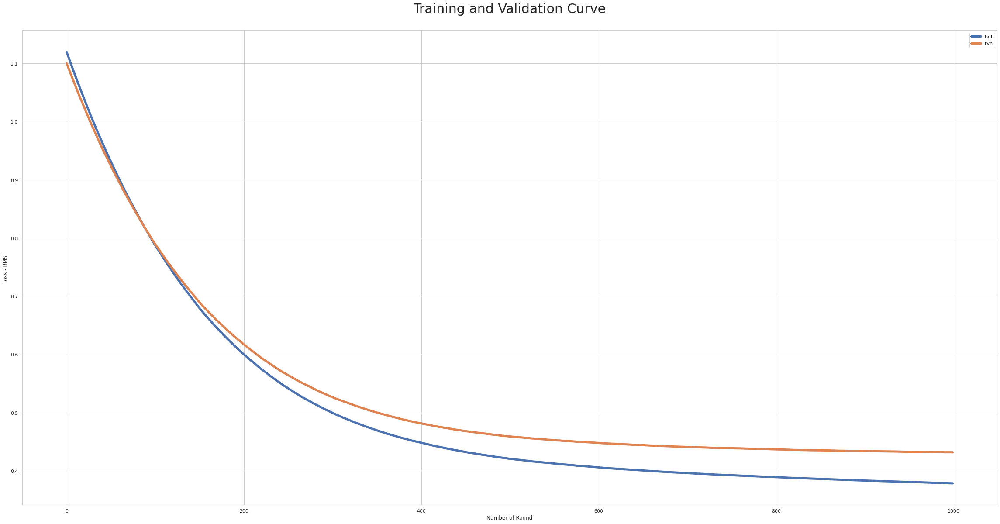

<Figure size 2880x1440 with 0 Axes>

<Figure size 2880x1440 with 0 Axes>

In [1564]:
x_axis = range(len(evals_result['train']["rmse"]))
y_axis = [evals_result['train']["rmse"], 
          evals_result['eval']["rmse"]]

df_train_val_curve = pd.DataFrame({"RMSE - Training":y_axis[0], 
                                   "RMSE - Validation":y_axis[1], 
                                   "Number of Round":x_axis})

plt.title("Training and Validation Curve\n", fontsize=30)

plot_train = sns.lineplot(data=df_train_val_curve, 
             x="Number of Round", 
             y="RMSE - Training",
             palette = 'blue', 
             label = 'bgt',
             linewidth=5,
            legend="auto")

plot_vaidation = sns.lineplot(data=df_train_val_curve, 
             x="Number of Round", 
             y="RMSE - Validation",
             palette = 'orange', 
             label = 'rvn',
             linewidth=5,
            legend="auto")

plt.xlabel("Number of Round")
plt.ylabel("Loss - RMSE")
plt.legend()
plt.show()
plt.figure()

##### Features Importance

Regarding the Training and Validation curve our **XGBoost** model seems to be well fitted, let's now plot the importance features in order to find which of the factors were used the most important to fit the model.

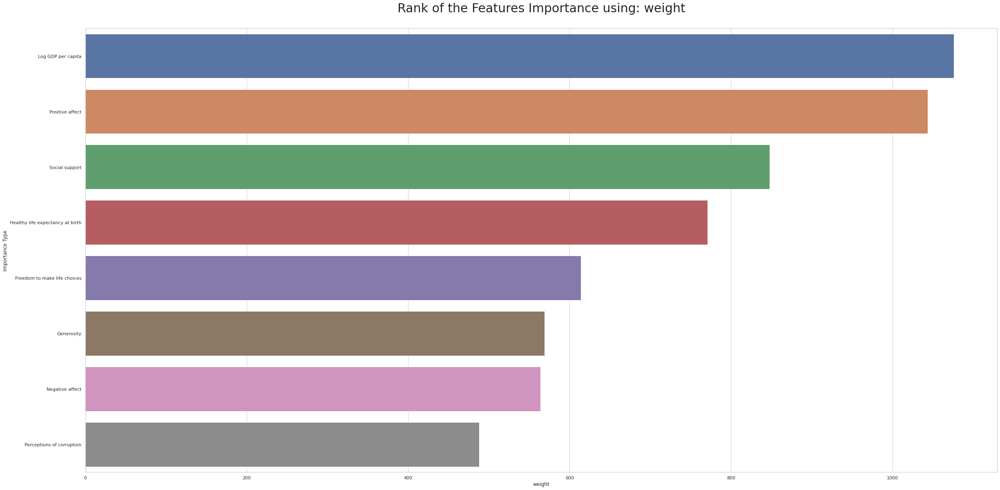

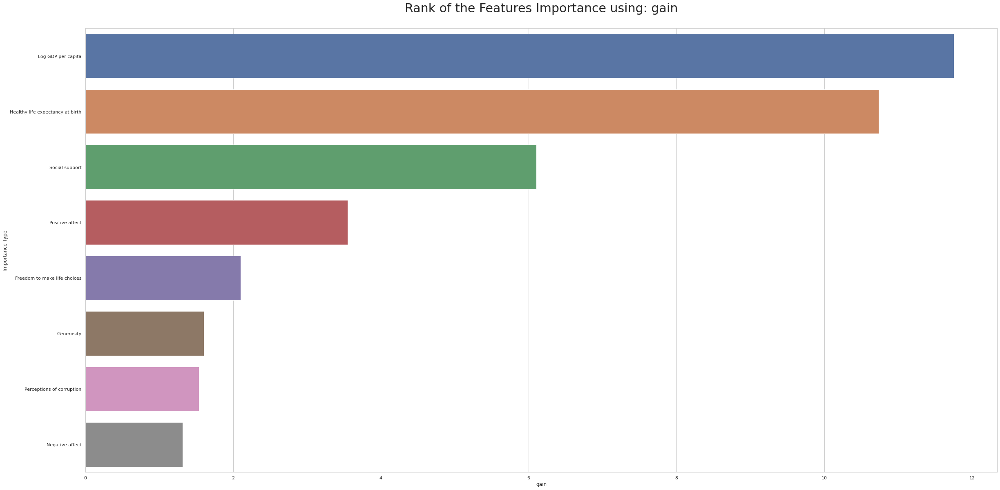

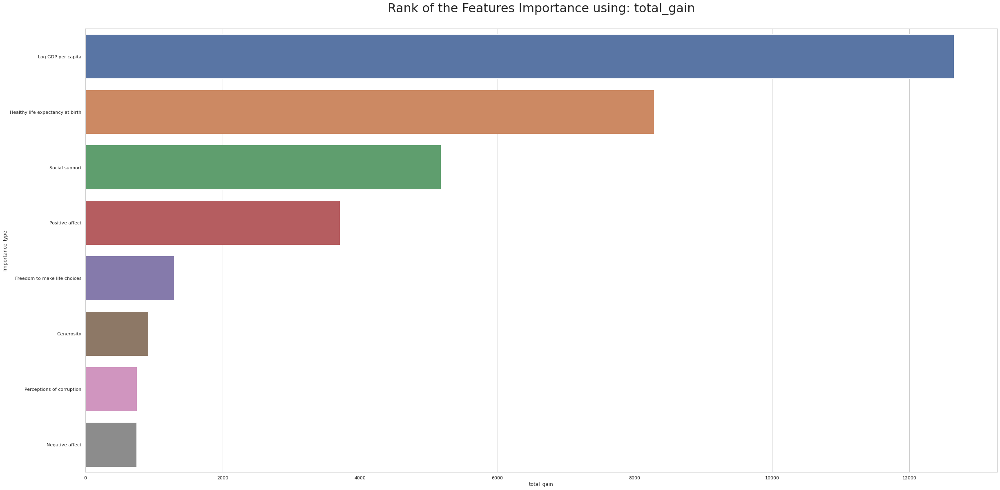

<Figure size 2880x1440 with 0 Axes>

In [1566]:
importance_types = ['weight', 'gain', 'total_gain']

for importance_type in importance_types:
    df_importance_features = pd.DataFrame.from_dict(bst.get_score(importance_type=importance_type),orient='index')
    df_importance_features["Importance Type"] = df_importance_features.index
    df_importance_features[importance_type] = df_importance_features[0]
    df_importance_features = df_importance_features.sort_values(by=importance_type,ascending=False)
    sns.set_theme(style="whitegrid")
    plt.title("Rank of the Features Importance using: " + importance_type + "\n", fontsize=30)
    sns.barplot(x=importance_type, y="Importance Type", data=df_importance_features)
    plt.figure()

Here we plotted the features importance using the **Weight** (the number of times a feature is used to split the data across all trees), the **Gain** (the average gain across all splits the feature is used in) and the **Total Gain** (the total gain across all splits the feature is used in)

To sum up, the features importance is a measurements which indicates how many times the features were used to build the different trees, so it give insights of how factors can explain another one for a model well fitted.

Here we still observe 4 majors factors that contribute to explain the **Happiness Score**:

- **Log GDP per capita**
- **Social support**
- **Healthy life expectancy at birth**
- **Positive affect**

Indeed they are all in the top 4 of the different features importance ranks, concerning the others features, they are not so really important.

## Conclusion

After all those observations, we can interpret that a country who is wealth (high **GDP per capita**), where the population have a good **social support**, a good **positive affect**, an high **Healthy life expectancy** and even feel that their country is not corrupted will tend to be an happy country. So for the accuracy of the report, the surveys should be focused on related factors (social, wealth and health domains).  

But we still need to consider those factors as assumptions or not direct causes, indeed, for instance people who have happier lives are likely to live longer, and be more trusting, more cooperative, and generally better able to meet life’s demands. This will feed back to improve health, income, generosity, corruption, and sense of freedom.

We also note that in such period of time (15 years) a country can not become happy from a unhappy state we observed a country (**Bulgaria**) where the happiness score went from 3.8 in 2007 to 5.6 in 2020, this is the highest improvement a country could done during this period, maybe other countries did it during end of crisis, war, Revolution time but we can't confirm it since we only have the records since 2005.

While we observed countries became unhappy as **Venezuela** and **Jordan** who were and are affected by a crisis.

To go further we can add open demographic data as the unemployment rate, the birth-rate, mortality rate, the population number...